In [1]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-al47vk2c
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-al47vk2c
  Resolved https://github.com/facebookresearch/detectron2.git to commit 32a186ebc229a94a8090e48ff3dd427f7eadb330
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 41.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 8.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=5738681 sha256=663c80dc6393f75a977eb67adcd12197

In [ ]:
!nvidia-smi

Wed Aug  9 21:44:07 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultPredictor
from detectron2.data import MetadataCatalog
from detectron2.utils.logger import setup_logger
from detectron2.config import get_cfg
from detectron2 import model_zoo
import os
from detectron2.engine import DefaultTrainer

In [ ]:
# Register the datasets
register_coco_instances("train_large", {}, "drive/MyDrive/ML207/Final_Dataset_COCO/train/_annotations.coco.json", "drive/MyDrive/ML207/Final_Dataset_COCO/train")
register_coco_instances("val", {}, "drive/MyDrive/ML207/valid/coco_annotations.json", "drive/MyDrive/ML207/valid")
register_coco_instances("test_", {}, "drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/test/_annotations.coco.json", "drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/test")

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("drive/MyDrive/ML207/Final_Dataset_COCO/output/", exist_ok=True)
        output_folder = "drive/MyDrive/ML207/Final_Dataset_COCO/output/"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
# Configuration
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("train_large",)
cfg.DATASETS.TEST = ("val",)   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 4
cfg.OUTPUT_DIR = "drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/output/"
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.MODEL.DEVICE = 'cuda'
cfg.SOLVER.IMS_PER_BATCH = 8
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.MAX_ITER = 6000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13  # number of classes in your dataset

In [ ]:
# Trainer
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/10 21:35:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[08/10 21:35:45 d2.engine.train_loop]: Starting training from iteration 0
[08/10 21:36:21 d2.utils.events]:  eta: 2:48:55  iter: 19  total_loss: 3.273  loss_cls: 2.359  loss_box_reg: 0.5337  loss_rpn_cls: 0.2422  loss_rpn_loc: 0.07322    time: 1.7136  last_time: 1.6850  data_time: 0.5539  last_data_time: 0.4686   lr: 1.9981e-05  max_mem: 11073M
[08/10 21:36:56 d2.utils.events]:  eta: 2:51:06  iter: 39  total_loss: 2.742  loss_cls: 1.935  loss_box_reg: 0.5487  loss_rpn_cls: 0.1991  loss_rpn_loc: 0.0856    time: 1.7307  last_time: 1.7518  data_time: 0.5116  last_data_time: 0.4740   lr: 3.9961e-05  max_mem: 11073M
[08/10 21:37:30 d2.utils.events]:  eta: 2:49:42  iter: 59  total_loss: 1.837  loss_cls: 1.09  loss_box_reg: 0.4977  loss_rpn_cls: 0.1028  loss_rpn_loc: 0.05456    time: 1.7176  last_time: 1.7942  data_time: 0.4348  last_data_time: 0.5191   lr: 5.9941e-05  max_mem: 11073M
[08/10 21:38:05 d2.utils.events]:  eta: 2:49:05  iter: 79  total_loss: 1.326  loss_cls: 0.6924  loss_box_reg:

FileNotFoundError: ignored

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
print(hello_world)

In [ ]:
# Evaluation
evaluator = COCOEvaluator("dataset_val", cfg, False, output_dir="drive/MyDrive/ML207/airplane-turnaround-object-detection/output/")
val_loader = build_detection_test_loader(cfg, "dataset_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [08/01 19:32:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/01 19:32:35 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/01 19:32:35 d2.data.datasets.coco]: Loaded 976 images in COCO format from drive/MyDrive/ML207/Final_Dataset_COCO/valid/_annotations.coco.json
[08/01 19:32:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/01 19:32:35 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[08/01 19:32:35 d2.data.common]: Serializing 976 elements to byte tensors and concatenating them all ...
[08/01 19:32:35 d2.data.common]: Serialized dataset takes 0.46 MiB
[08/01 19:32:35 d2.evaluation.evaluator]: Start inference on 976 batches
[08/

OrderedDict([('bbox',
              {'AP': 62.081818337813225,
               'AP50': 85.2385552280684,
               'AP75': 70.05874758110932,
               'APs': 34.06147335258935,
               'APm': 57.59224435880089,
               'APl': 65.55782808289811,
               'AP-Airplane-turnarounds': nan,
               'AP-airplane': 85.33823552047338,
               'AP-baggage_truck': 80.71915669956067,
               'AP-bus': 45.55079390212929,
               'AP-fuel_hose': 30.41315762643822,
               'AP-fuel_truck': 85.02934723597019,
               'AP-ground_power': 52.540702636717675,
               'AP-jet_bridge': 84.45514130958351,
               'AP-person': 50.008637202277285,
               'AP-pushback_tug': 69.67436820647255,
               'AP-resupply_truck': 69.36100803387714,
               'AP-rolling_stairway': 74.53287784209662,
               'AP-rump_loader': 79.44021217597526,
               'AP-stairway': 0.0})])

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir output

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
import cv2
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Set up the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = "/content/output/model_final.pth"
predictor = DefaultPredictor(cfg)

AssertionError: ignored

[08/11 00:42:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/output/model_final.pth ...


Processing frames:   0%|          | 0/7244 [00:00<?, ?it/s]

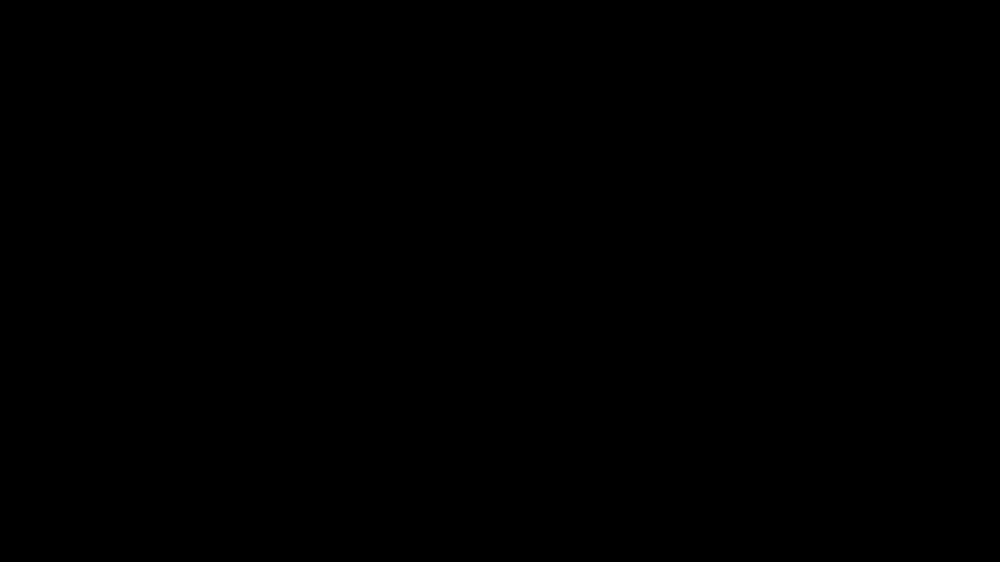

Processing frames:   0%|          | 1/7244 [00:00<2:00:14,  1.00it/s]

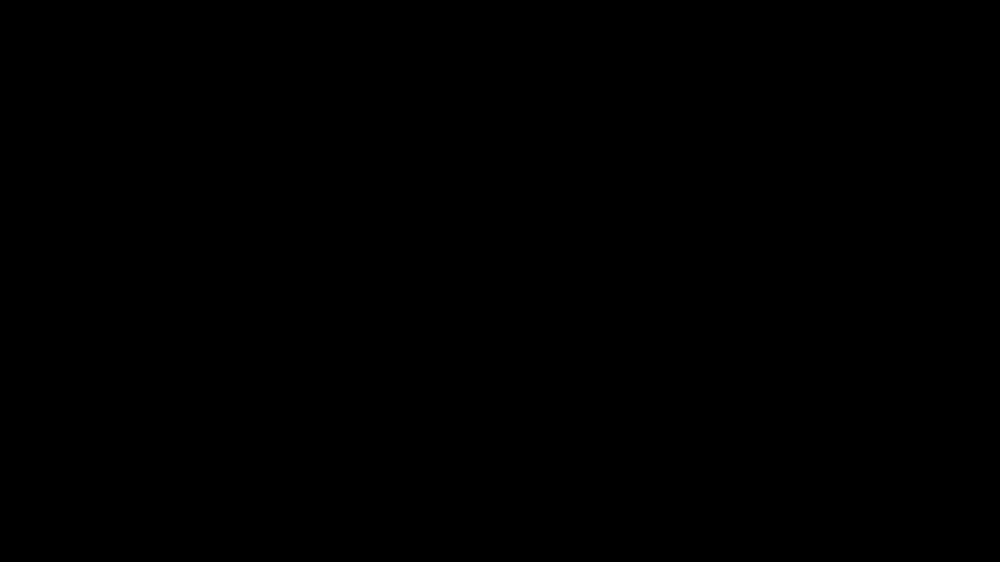

Processing frames:   0%|          | 2/7244 [00:01<1:55:11,  1.05it/s]

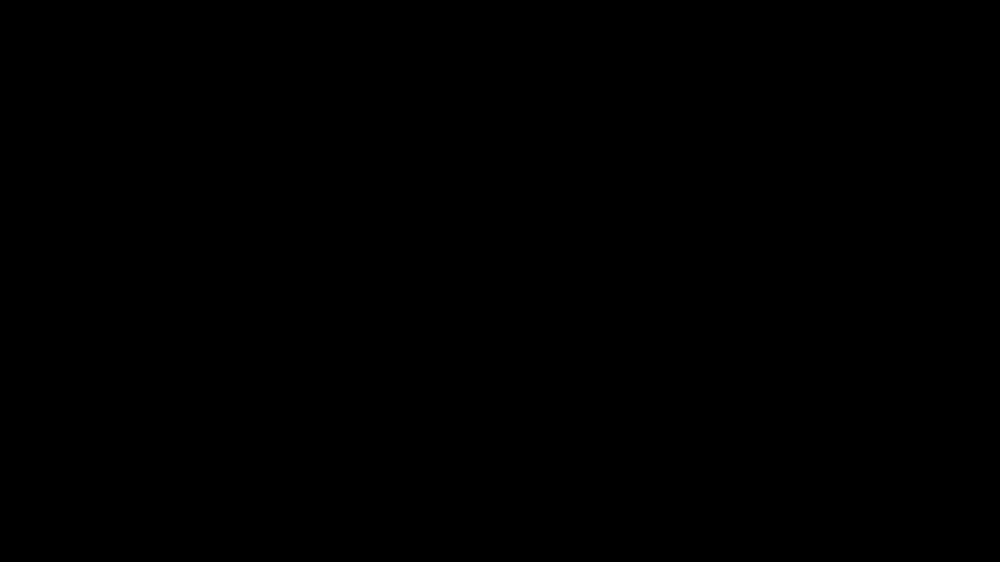

Processing frames:   0%|          | 3/7244 [00:03<2:34:58,  1.28s/it]

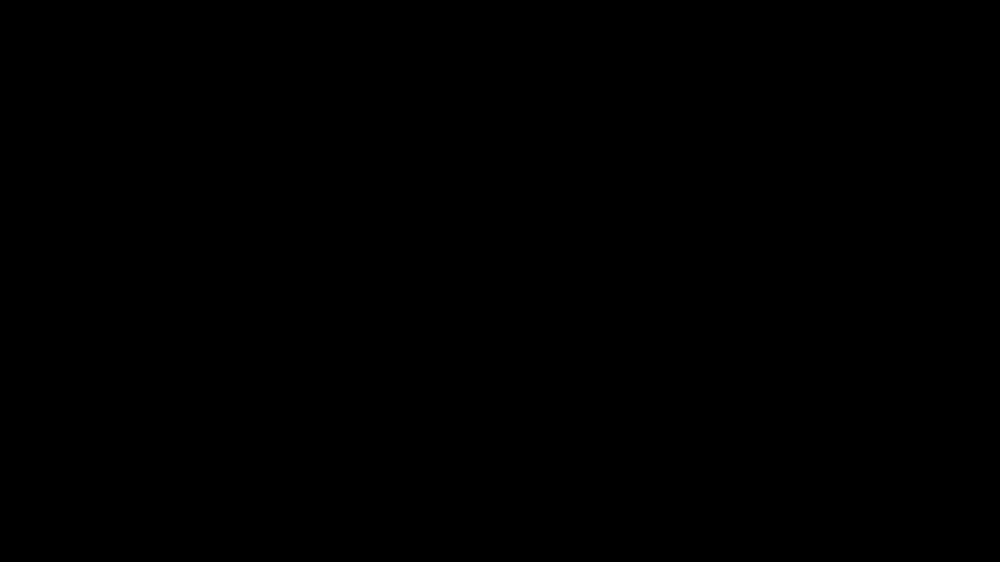

Processing frames:   0%|          | 4/7244 [00:05<2:54:58,  1.45s/it]

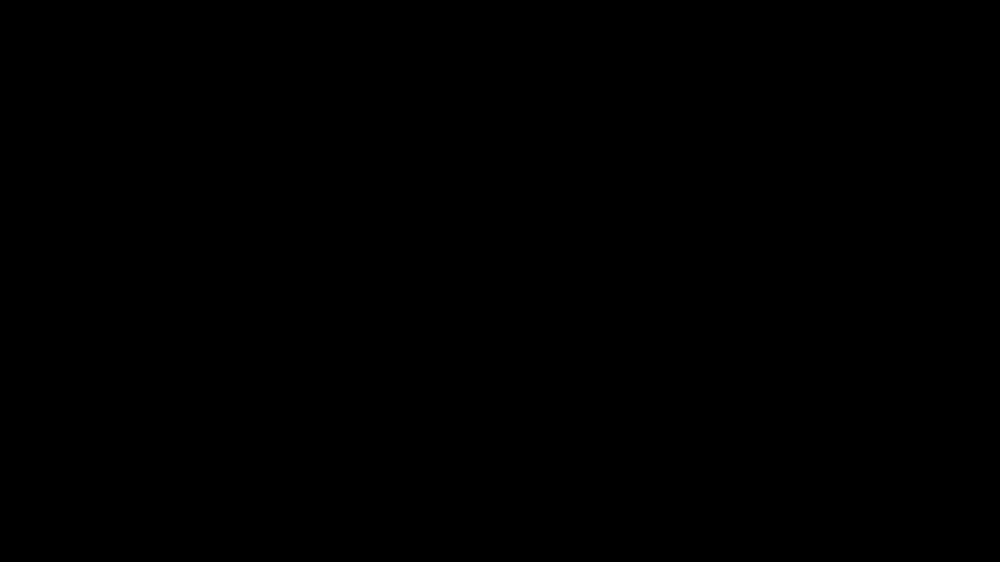

Processing frames:   0%|          | 5/7244 [00:07<3:09:10,  1.57s/it]

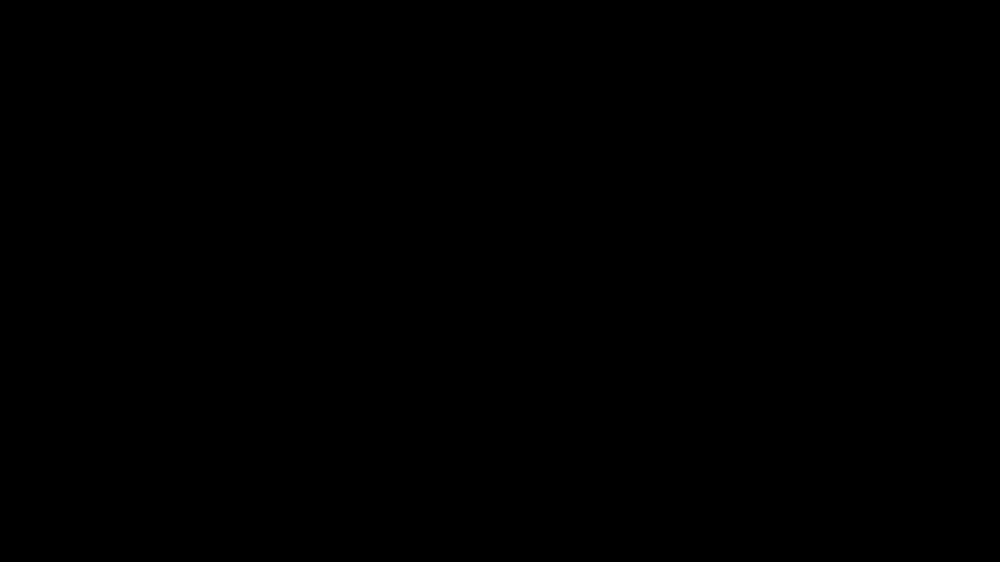

Processing frames:   0%|          | 6/7244 [00:08<2:52:29,  1.43s/it]

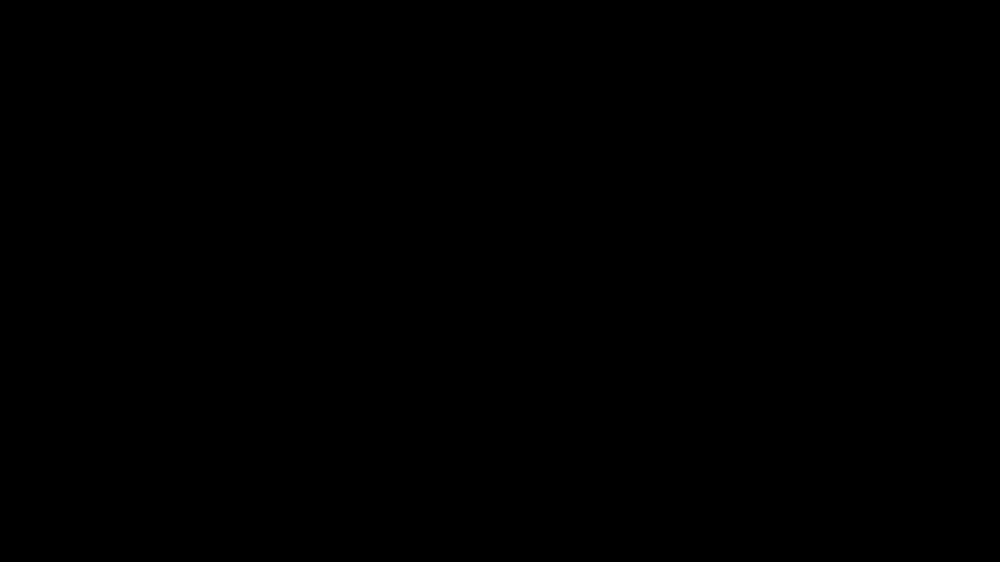

Processing frames:   0%|          | 7/7244 [00:09<2:33:19,  1.27s/it]

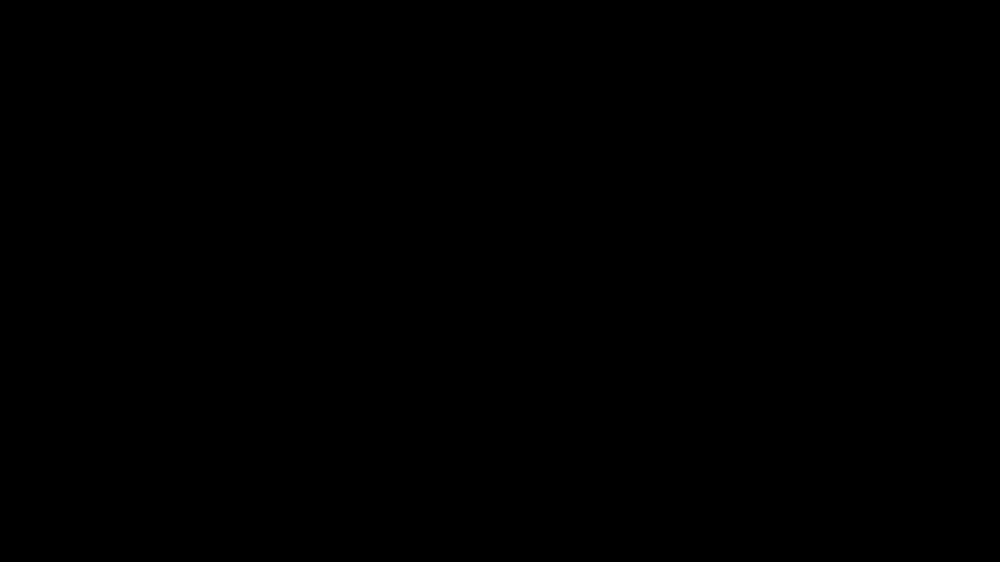

Processing frames:   0%|          | 8/7244 [00:10<2:16:04,  1.13s/it]

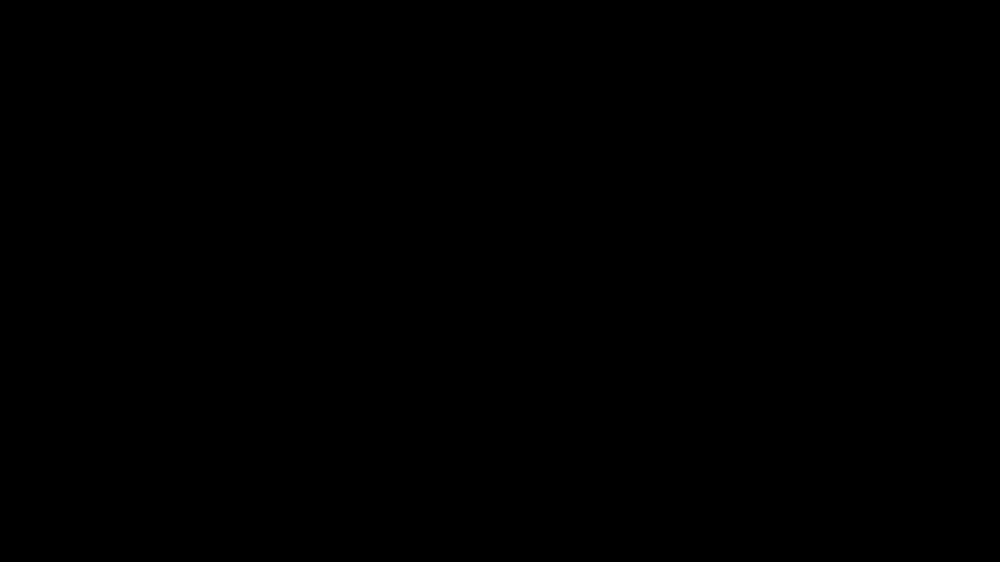

Processing frames:   0%|          | 9/7244 [00:10<2:08:57,  1.07s/it]

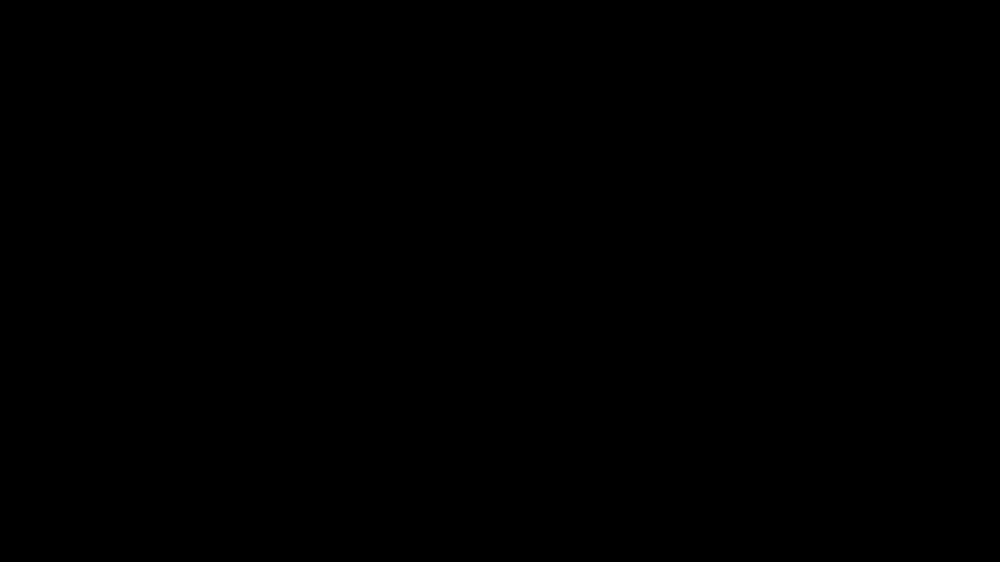

Processing frames:   0%|          | 10/7244 [00:11<2:01:14,  1.01s/it]

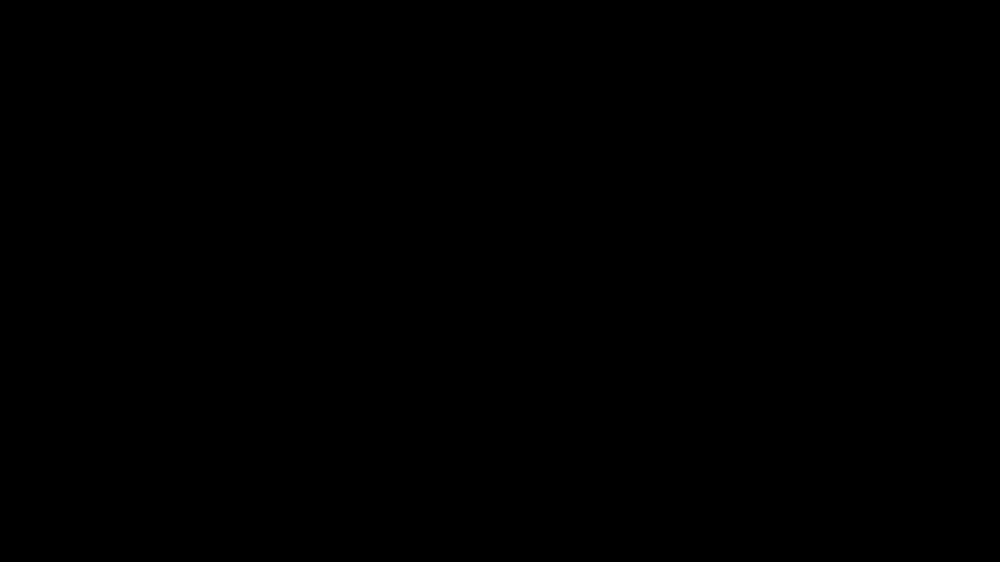

Processing frames:   0%|          | 11/7244 [00:12<1:57:13,  1.03it/s]

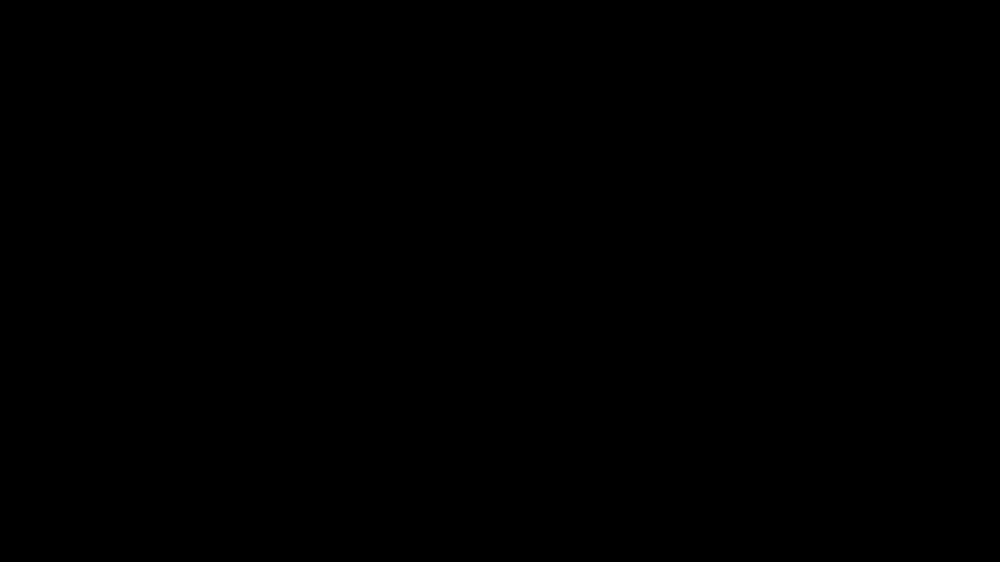

Processing frames:   0%|          | 12/7244 [00:13<1:48:58,  1.11it/s]

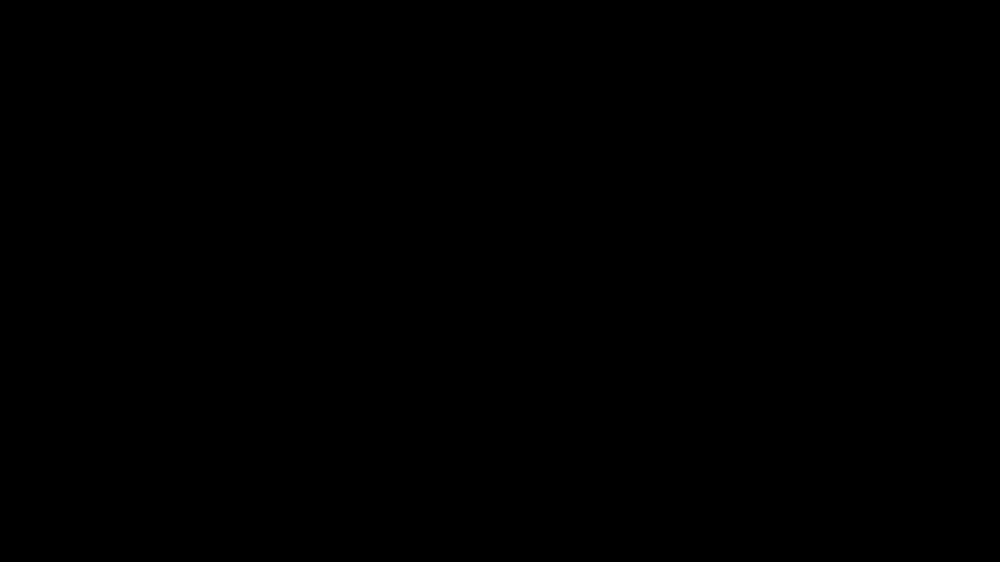

Processing frames:   0%|          | 13/7244 [00:14<1:51:55,  1.08it/s]

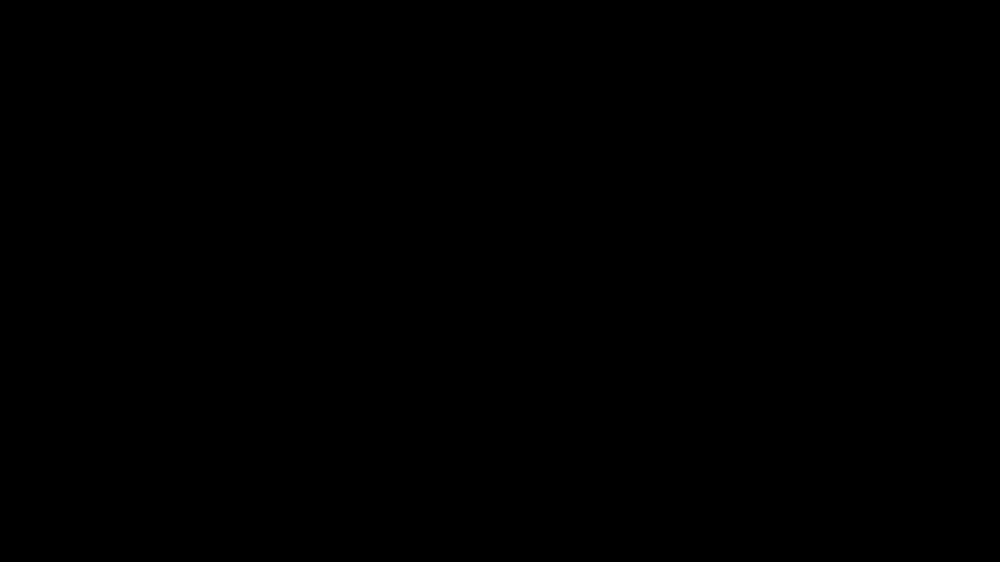

Processing frames:   0%|          | 14/7244 [00:15<1:51:08,  1.08it/s]

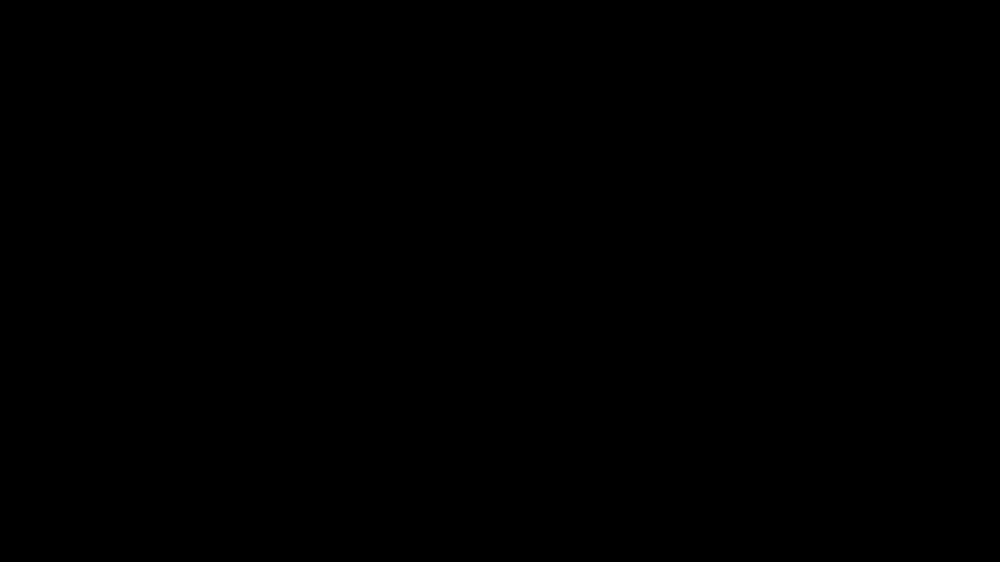

Processing frames:   0%|          | 15/7244 [00:16<1:51:38,  1.08it/s]

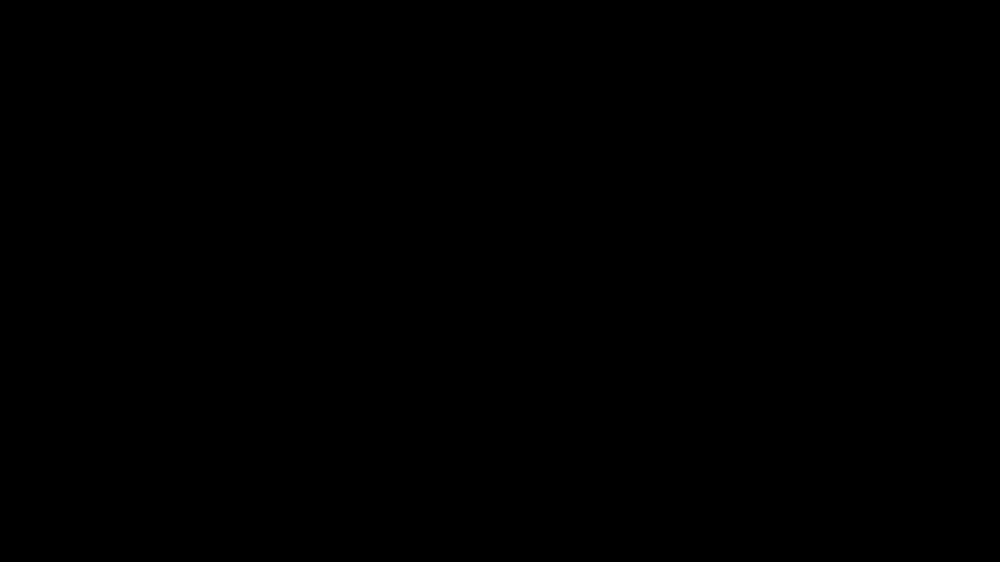

Processing frames:   0%|          | 16/7244 [00:17<1:53:16,  1.06it/s]

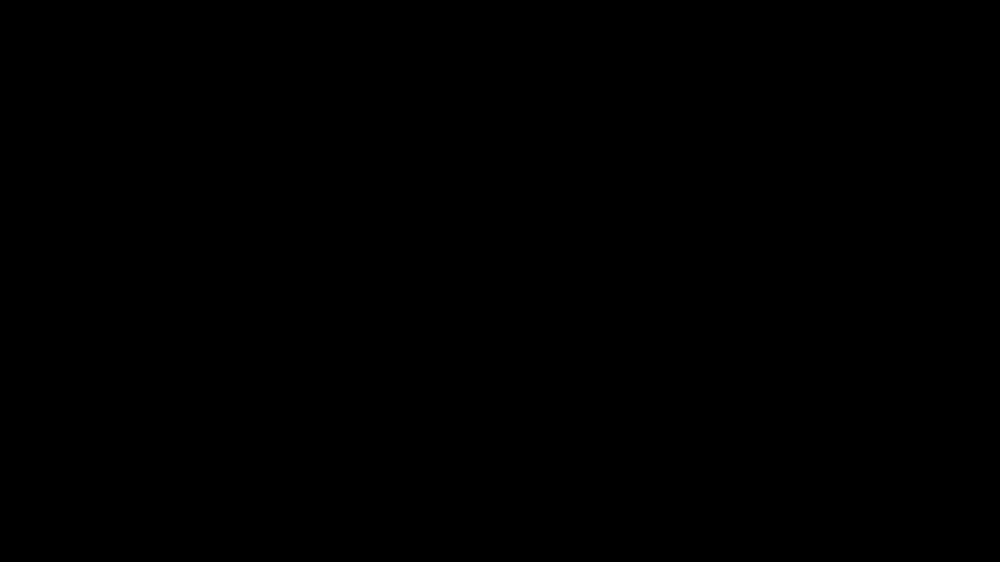

Processing frames:   0%|          | 17/7244 [00:18<2:14:29,  1.12s/it]

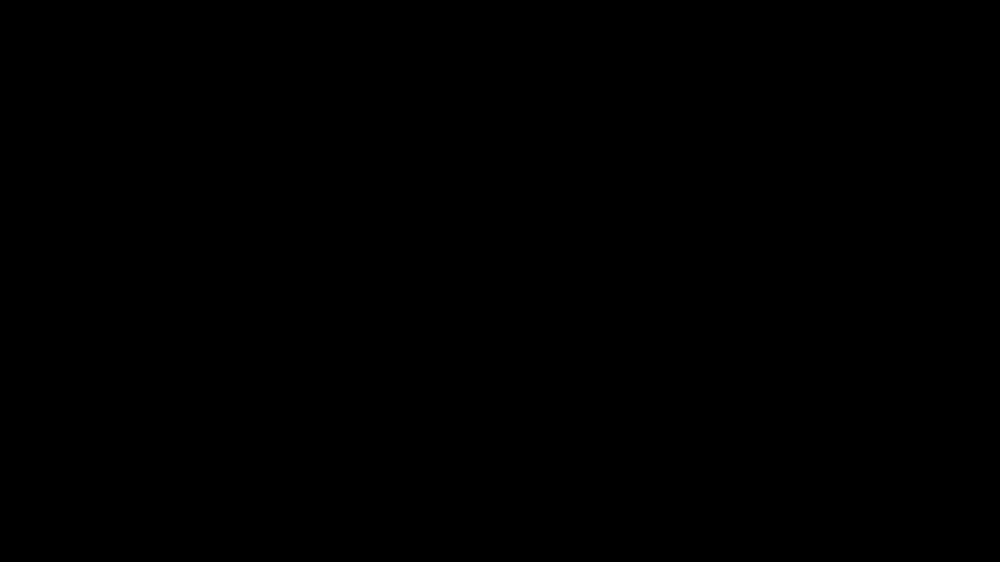

Processing frames:   0%|          | 18/7244 [00:20<2:45:12,  1.37s/it]

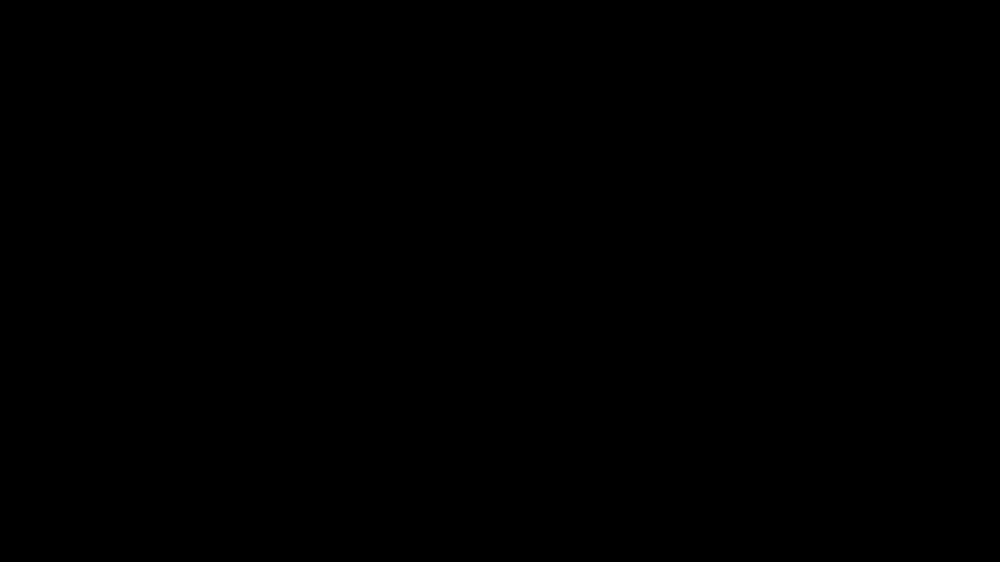

Processing frames:   0%|          | 19/7244 [00:23<3:17:23,  1.64s/it]

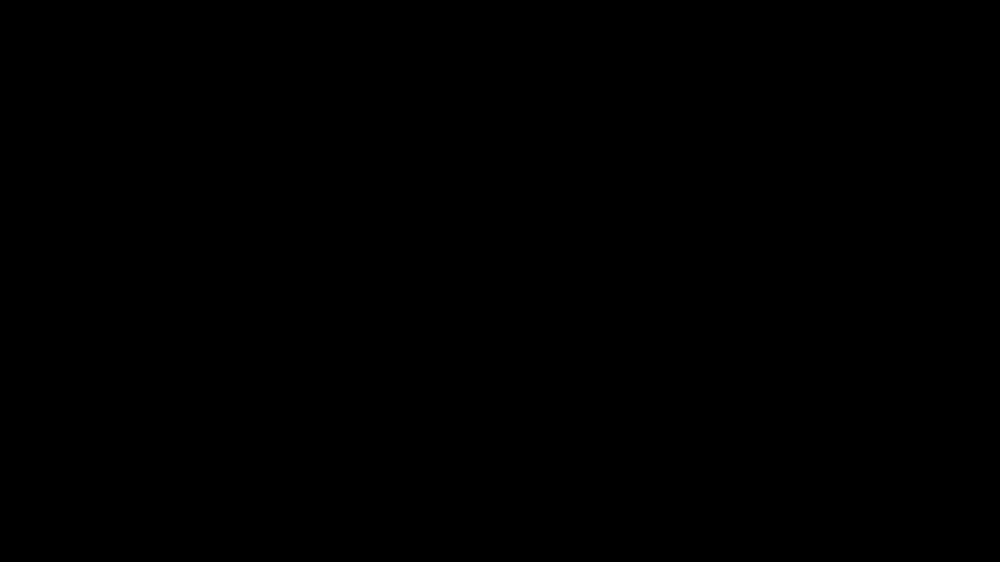

Processing frames:   0%|          | 20/7244 [00:24<3:01:25,  1.51s/it]

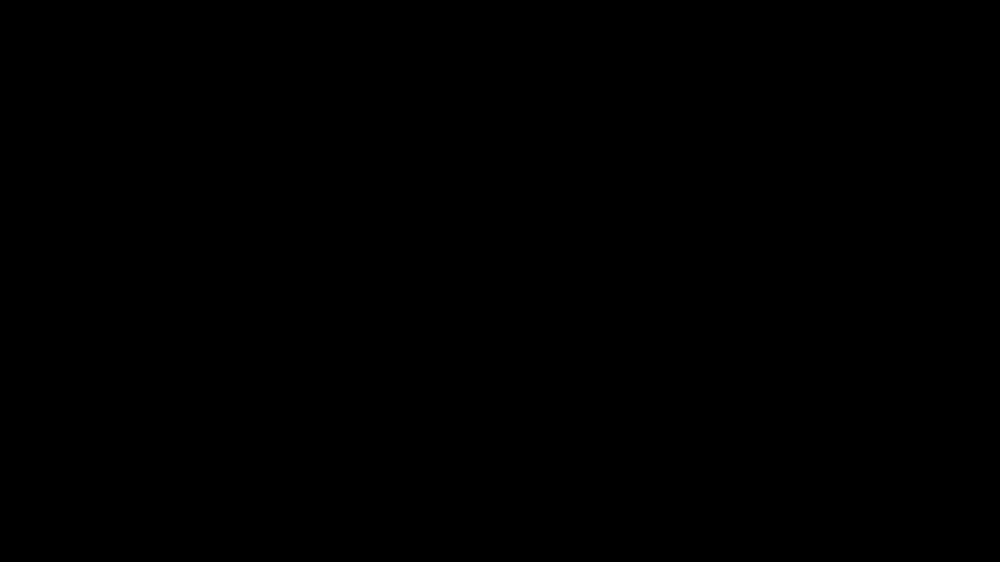

Processing frames:   0%|          | 21/7244 [00:25<2:42:27,  1.35s/it]

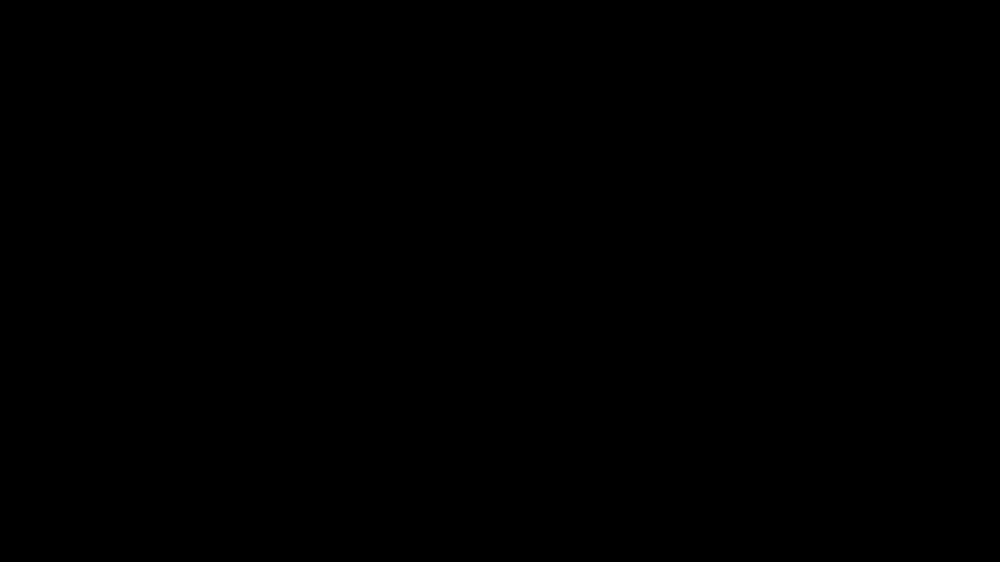

Processing frames:   0%|          | 22/7244 [00:26<2:27:51,  1.23s/it]

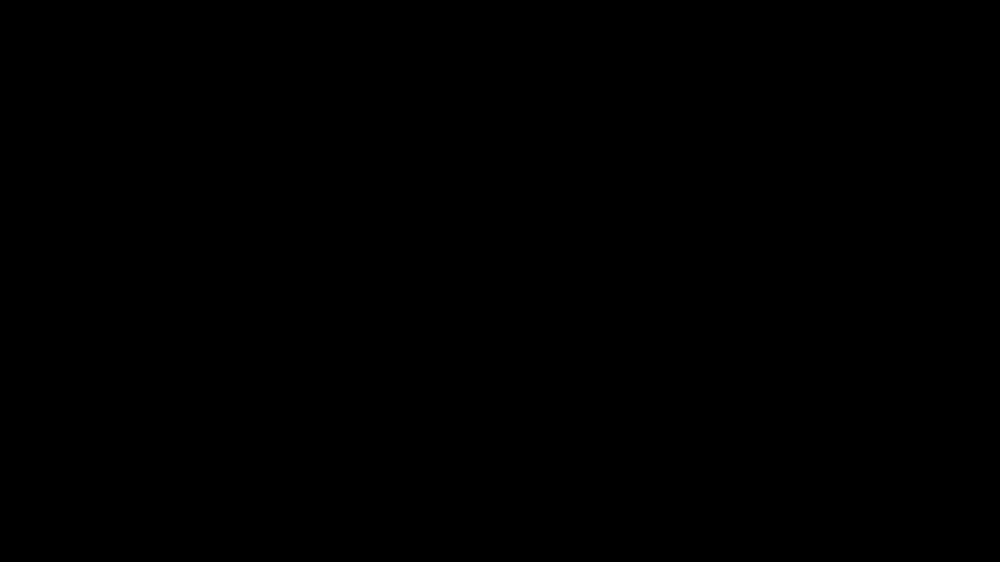

Processing frames:   0%|          | 23/7244 [00:26<2:14:10,  1.11s/it]

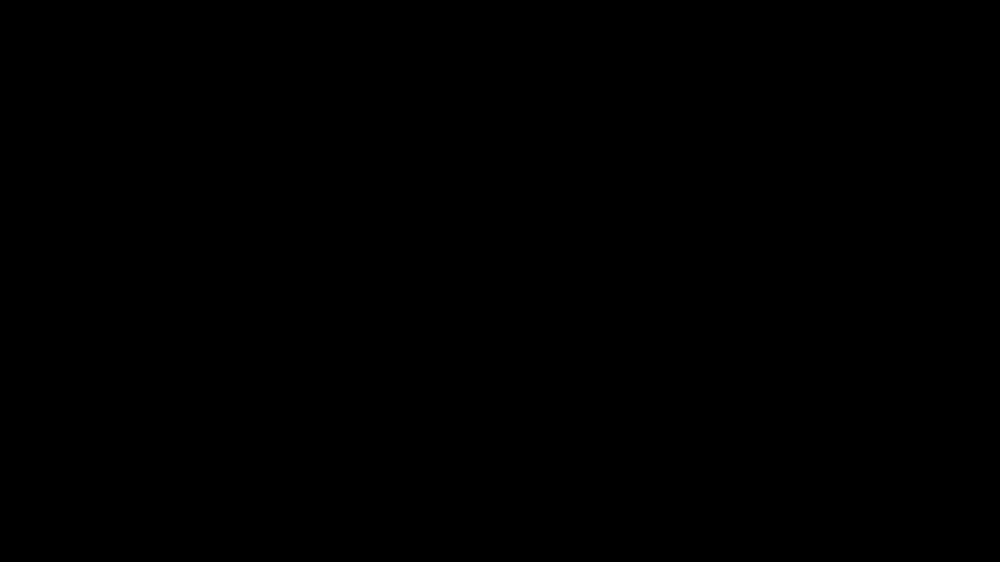

Processing frames:   0%|          | 24/7244 [00:27<2:04:43,  1.04s/it]

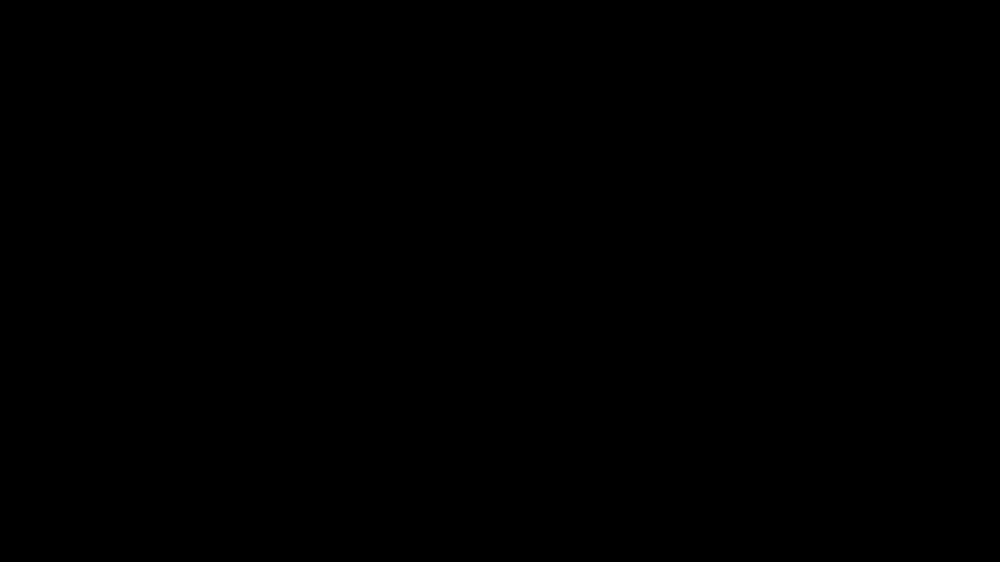

Processing frames:   0%|          | 25/7244 [00:28<2:00:07,  1.00it/s]

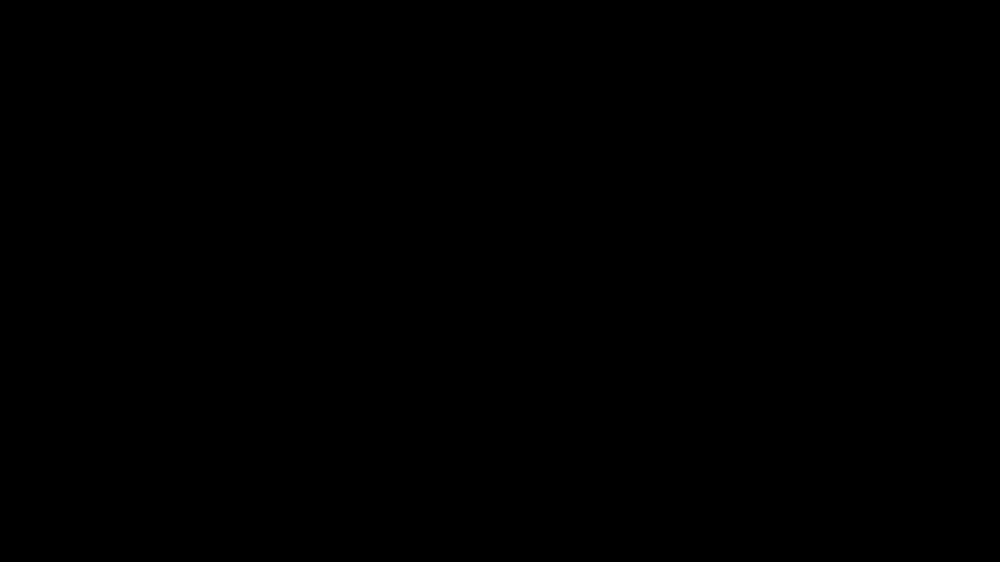

Processing frames:   0%|          | 26/7244 [00:29<2:06:03,  1.05s/it]

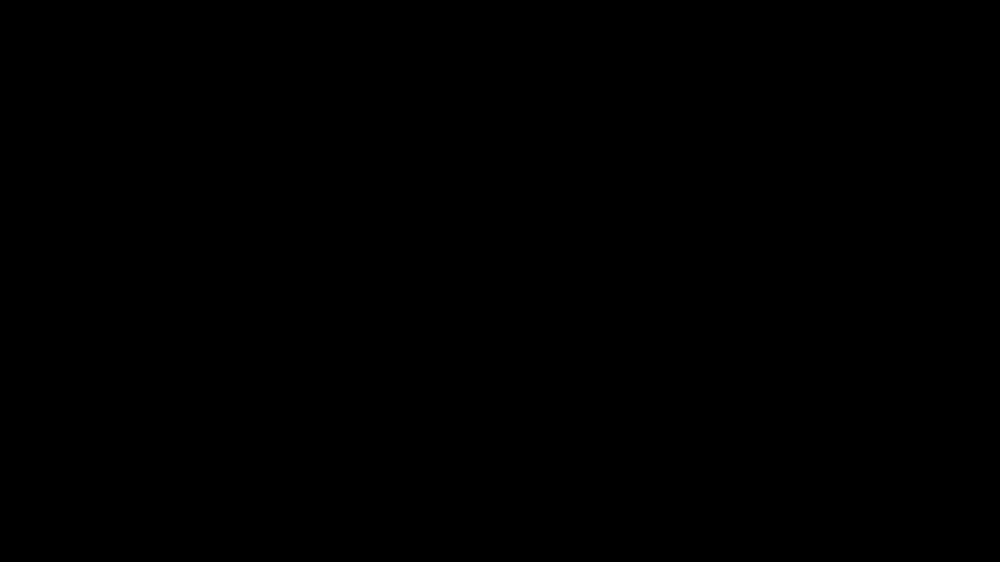

Processing frames:   0%|          | 27/7244 [00:30<2:03:04,  1.02s/it]

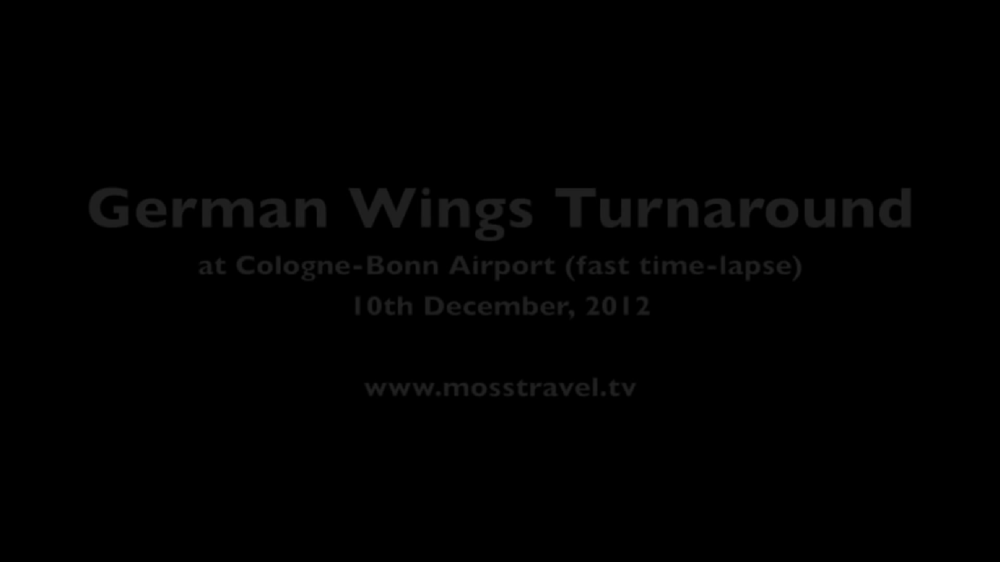

Processing frames:   0%|          | 28/7244 [00:31<1:54:35,  1.05it/s]

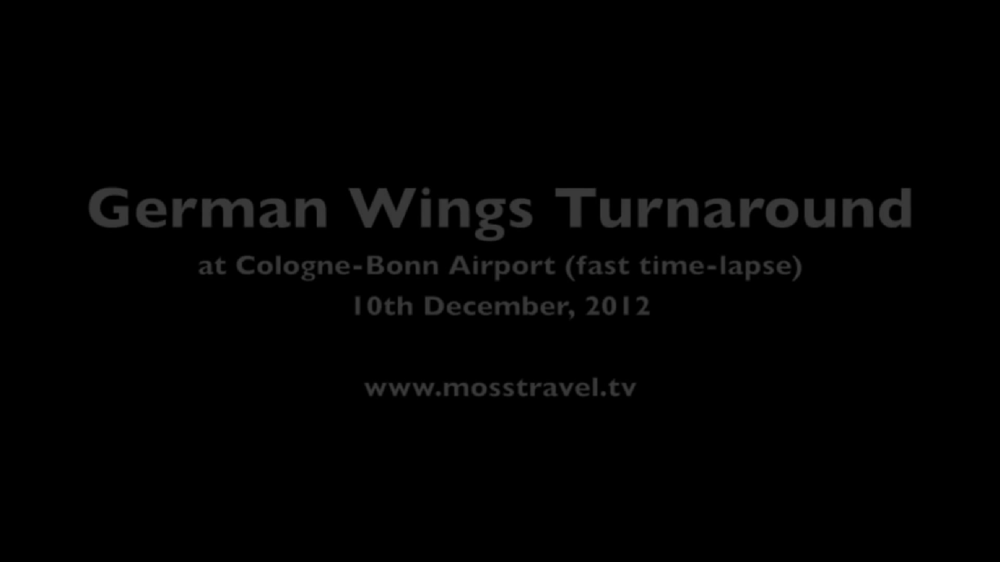

Processing frames:   0%|          | 29/7244 [00:32<1:39:24,  1.21it/s]

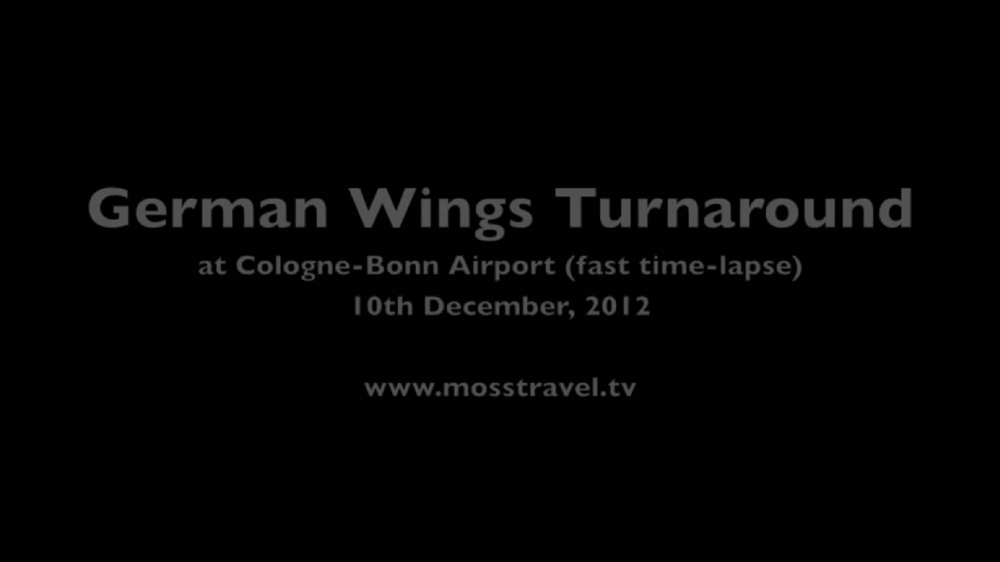

Processing frames:   0%|          | 30/7244 [00:32<1:29:19,  1.35it/s]

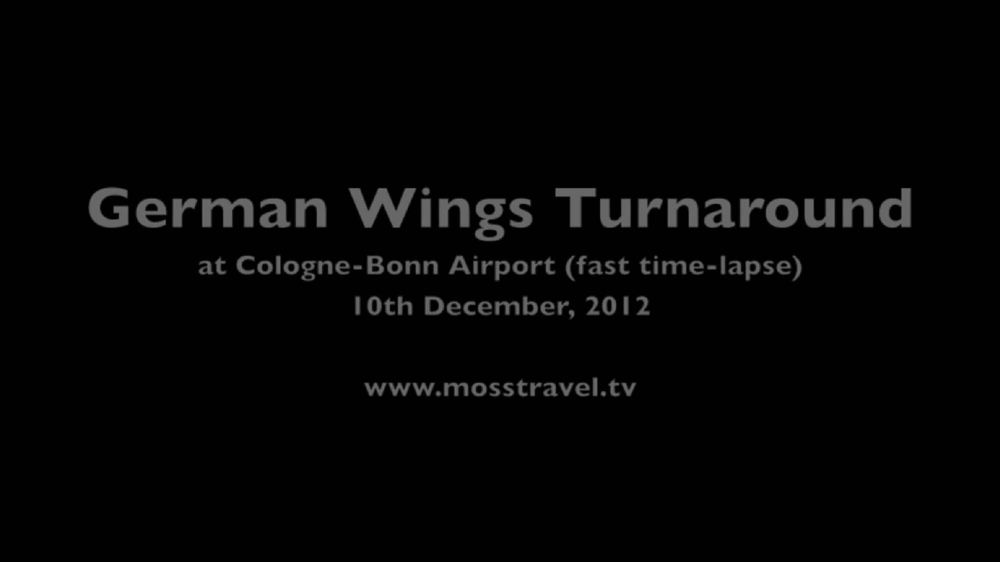

Processing frames:   0%|          | 31/7244 [00:33<1:21:22,  1.48it/s]

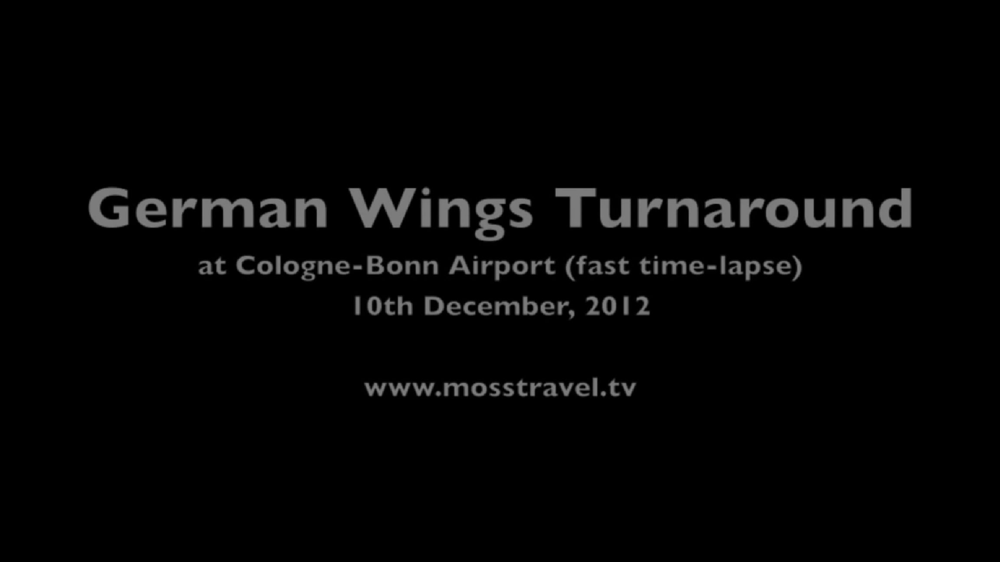

Processing frames:   0%|          | 32/7244 [00:33<1:20:27,  1.49it/s]

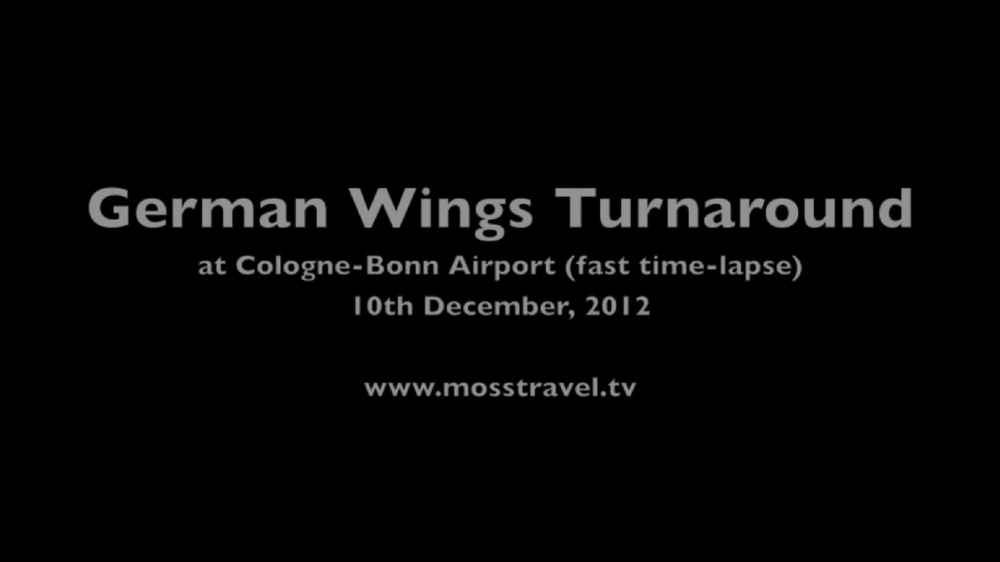

Processing frames:   0%|          | 33/7244 [00:34<1:26:03,  1.40it/s]

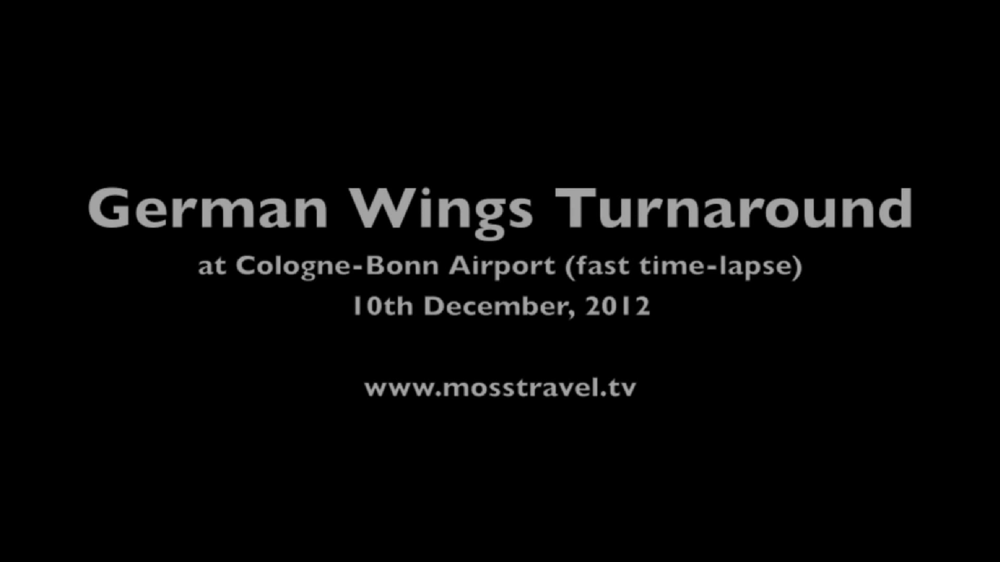

Processing frames:   0%|          | 34/7244 [00:35<1:29:04,  1.35it/s]

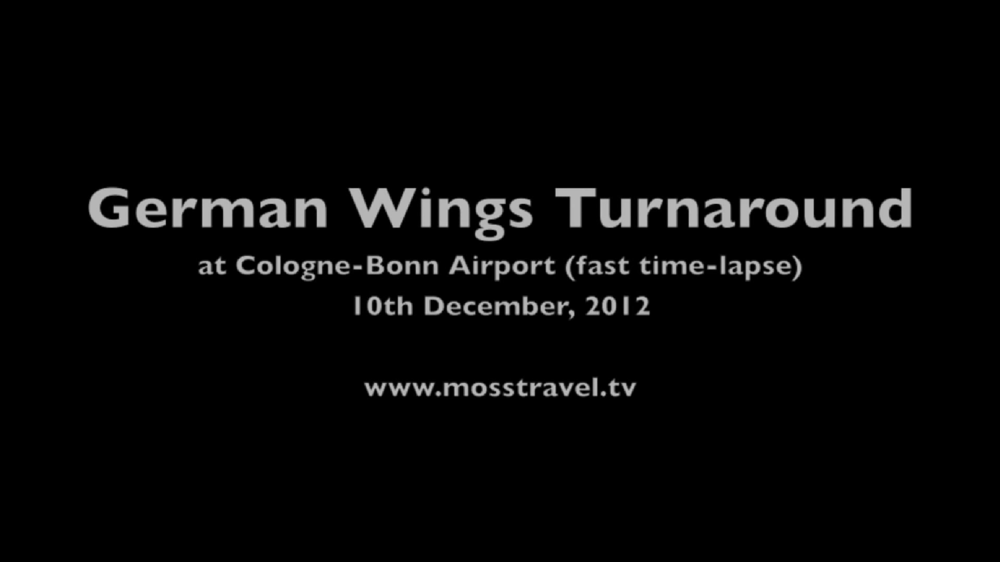

Processing frames:   0%|          | 35/7244 [00:36<1:30:55,  1.32it/s]

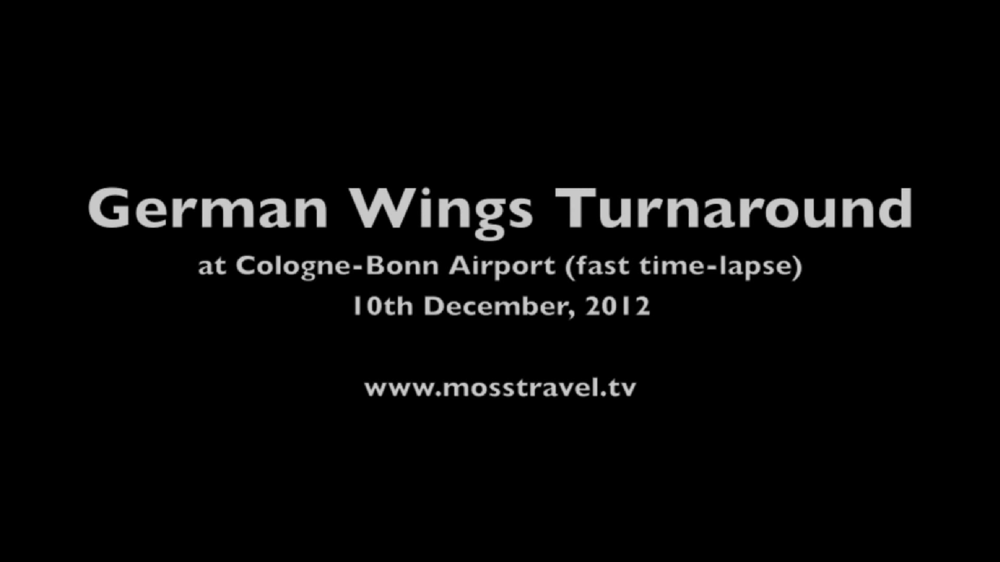

Processing frames:   0%|          | 36/7244 [00:37<1:32:32,  1.30it/s]

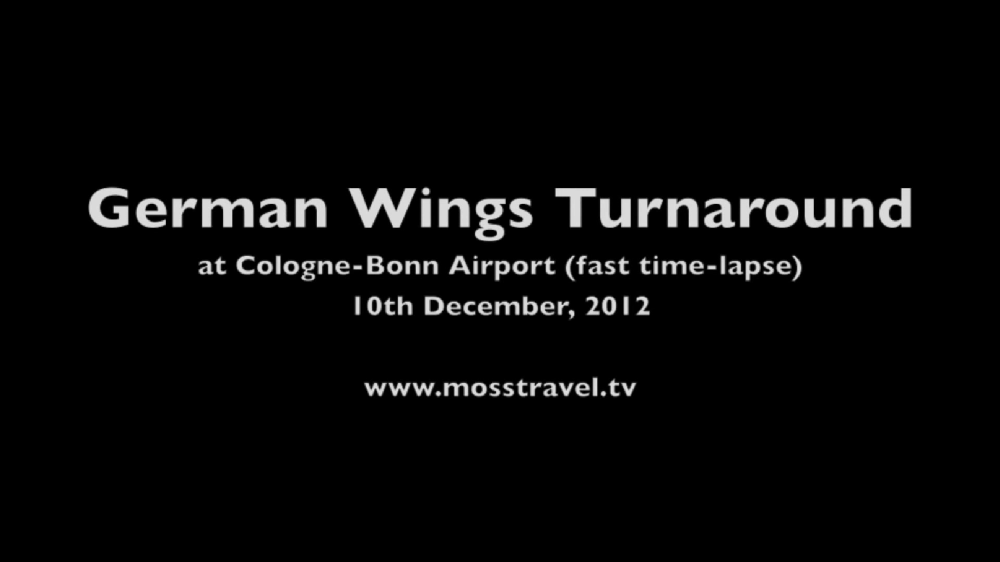

Processing frames:   1%|          | 37/7244 [00:37<1:34:44,  1.27it/s]

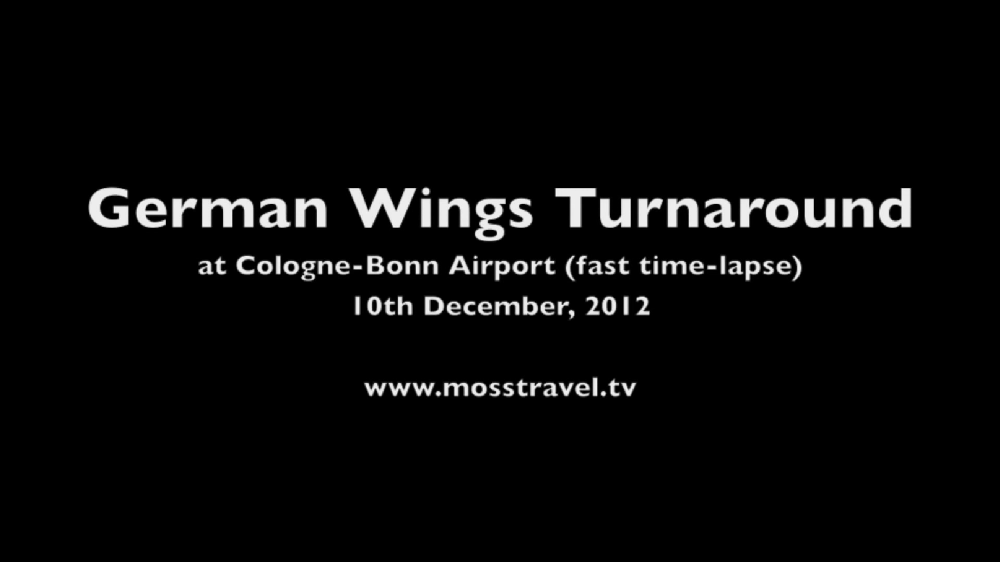

Processing frames:   1%|          | 38/7244 [00:38<1:35:47,  1.25it/s]

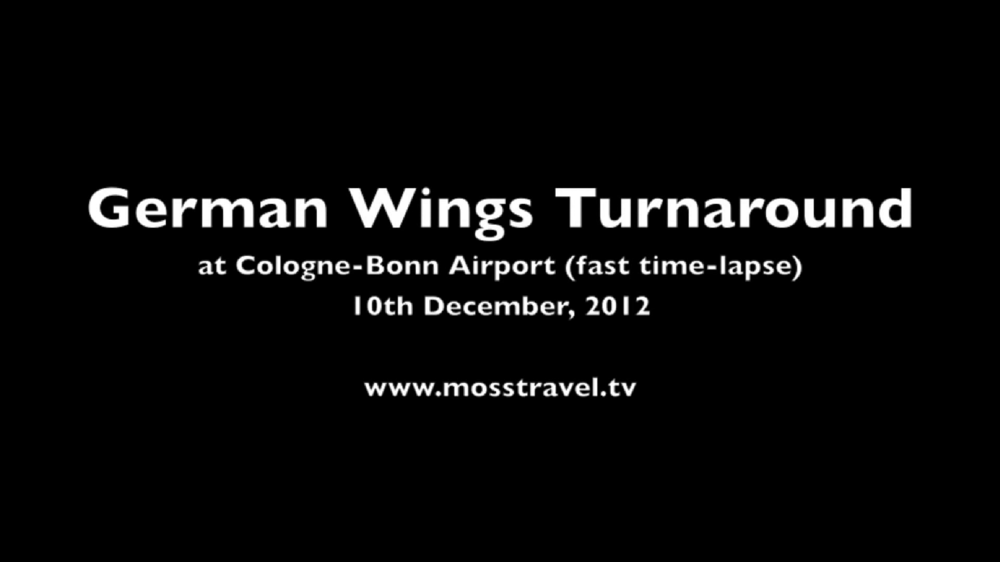

Processing frames:   1%|          | 39/7244 [00:39<1:34:37,  1.27it/s]

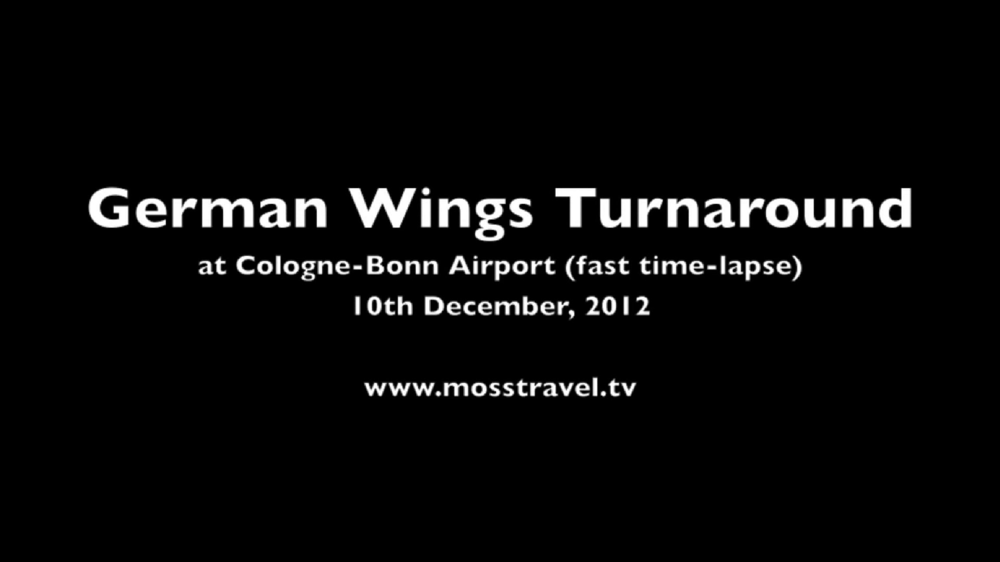

Processing frames:   1%|          | 40/7244 [00:40<1:26:42,  1.38it/s]

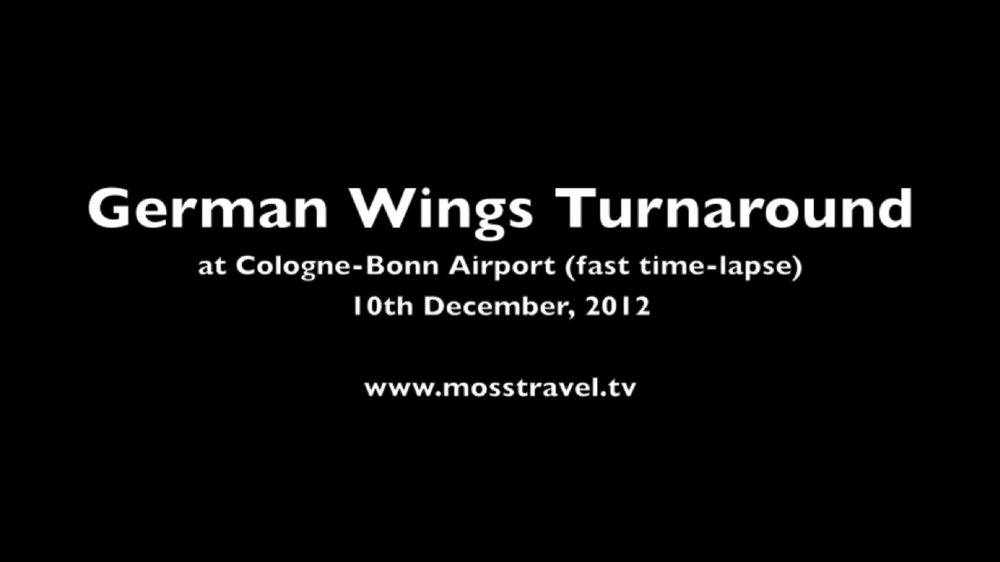

Processing frames:   1%|          | 41/7244 [00:40<1:20:41,  1.49it/s]

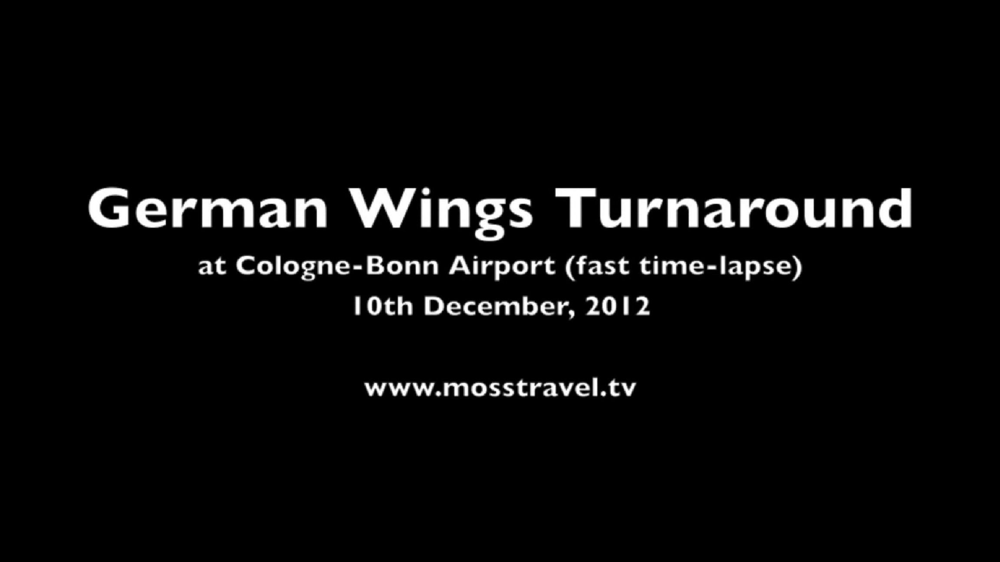

Processing frames:   1%|          | 42/7244 [00:41<1:16:08,  1.58it/s]

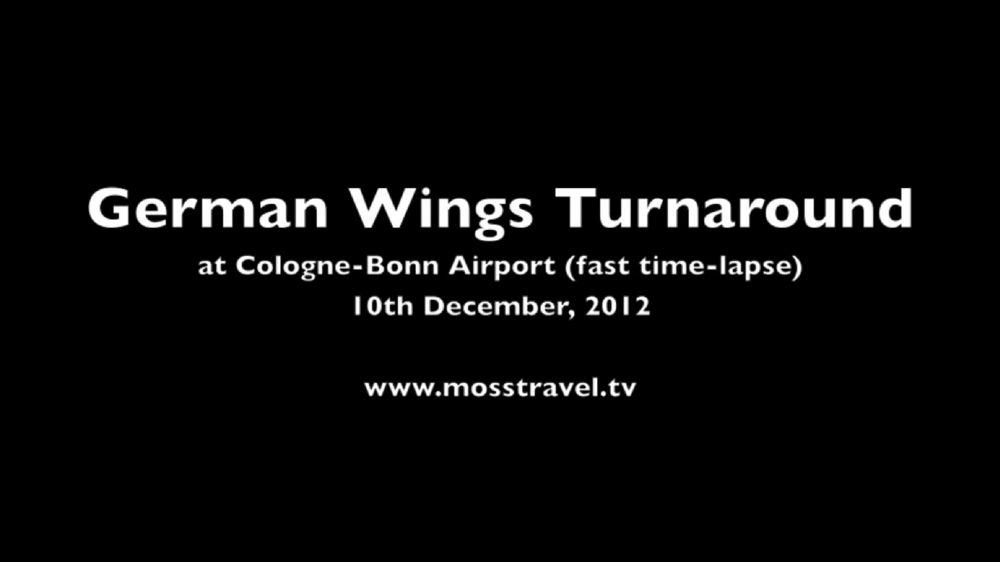

Processing frames:   1%|          | 43/7244 [00:41<1:14:05,  1.62it/s]

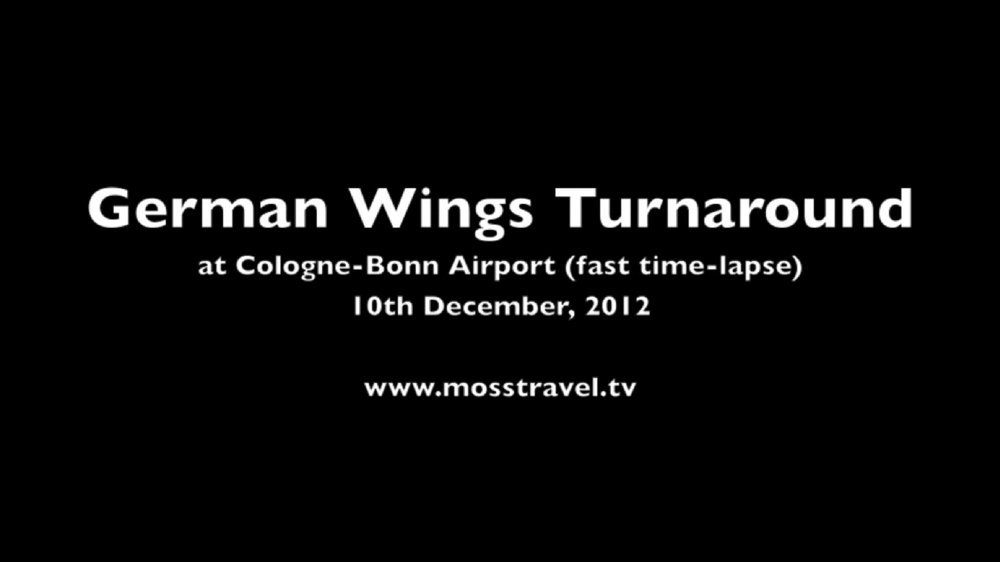

Processing frames:   1%|          | 44/7244 [00:42<1:12:02,  1.67it/s]

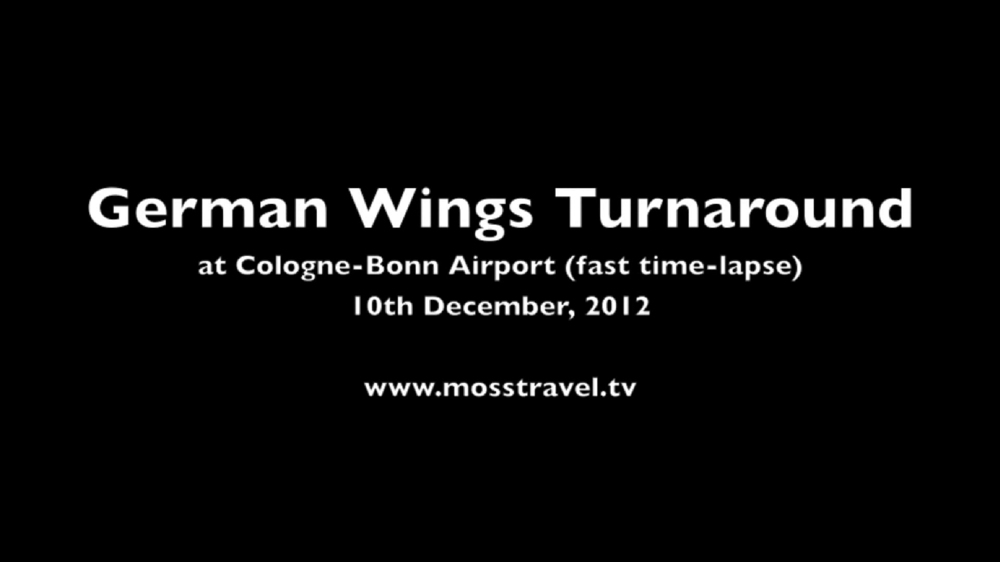

Processing frames:   1%|          | 45/7244 [00:42<1:10:01,  1.71it/s]

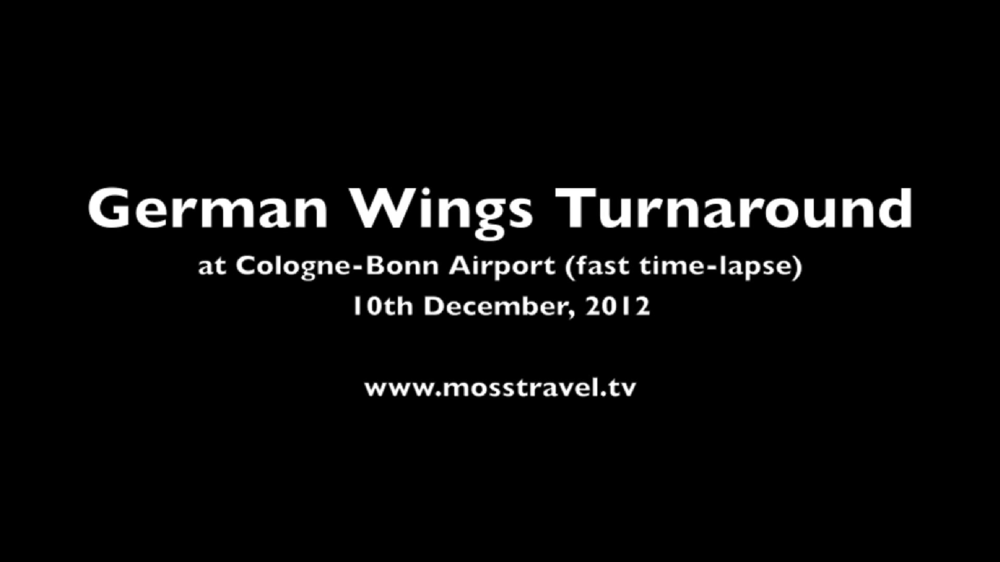

Processing frames:   1%|          | 46/7244 [00:43<1:10:52,  1.69it/s]

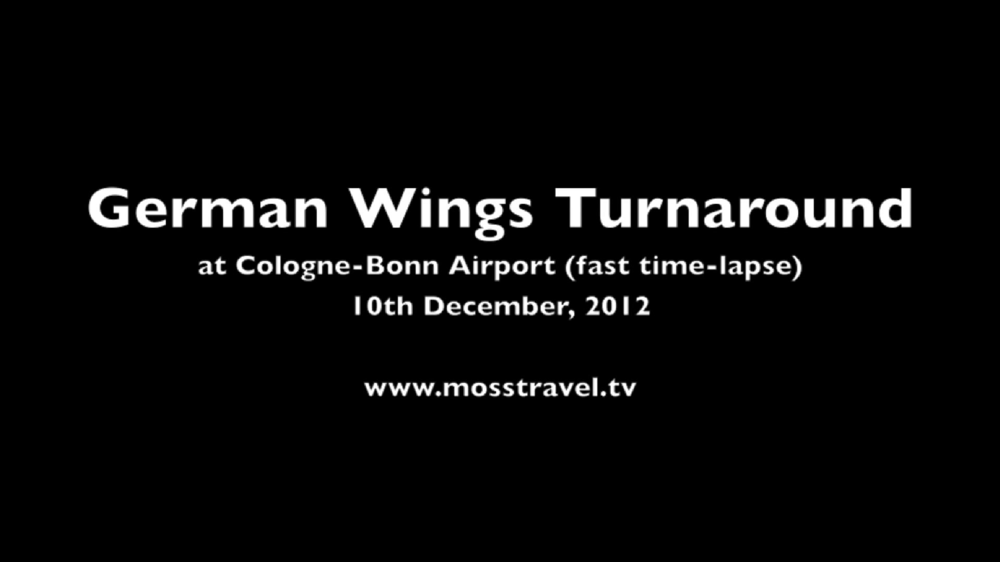

Processing frames:   1%|          | 47/7244 [00:44<1:09:27,  1.73it/s]

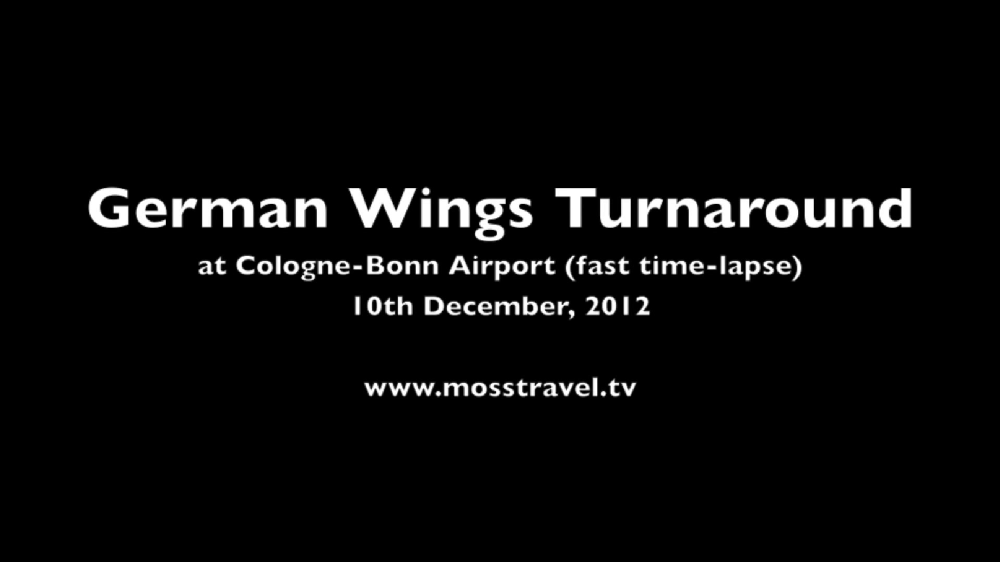

Processing frames:   1%|          | 48/7244 [00:44<1:08:38,  1.75it/s]

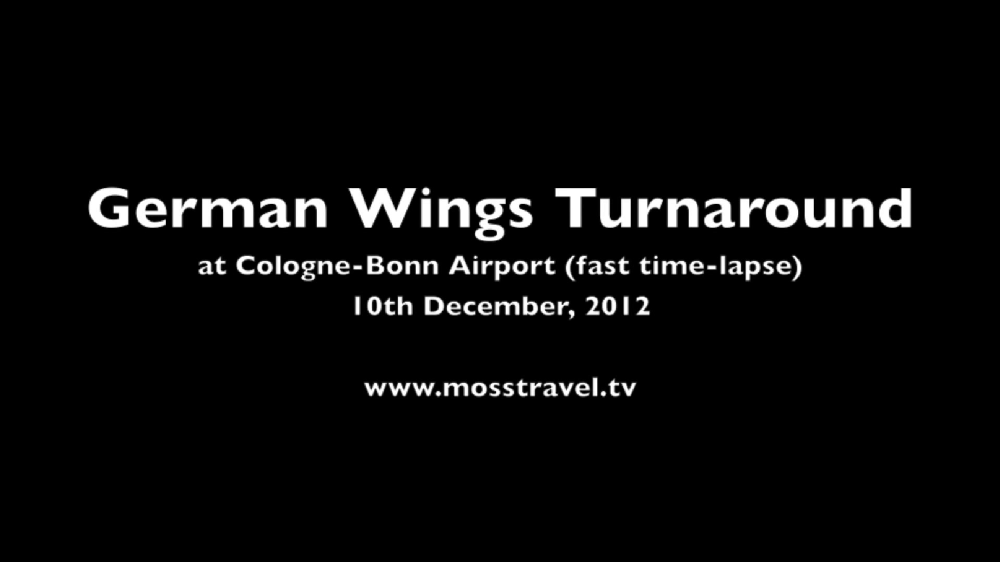

Processing frames:   1%|          | 49/7244 [00:45<1:07:29,  1.78it/s]

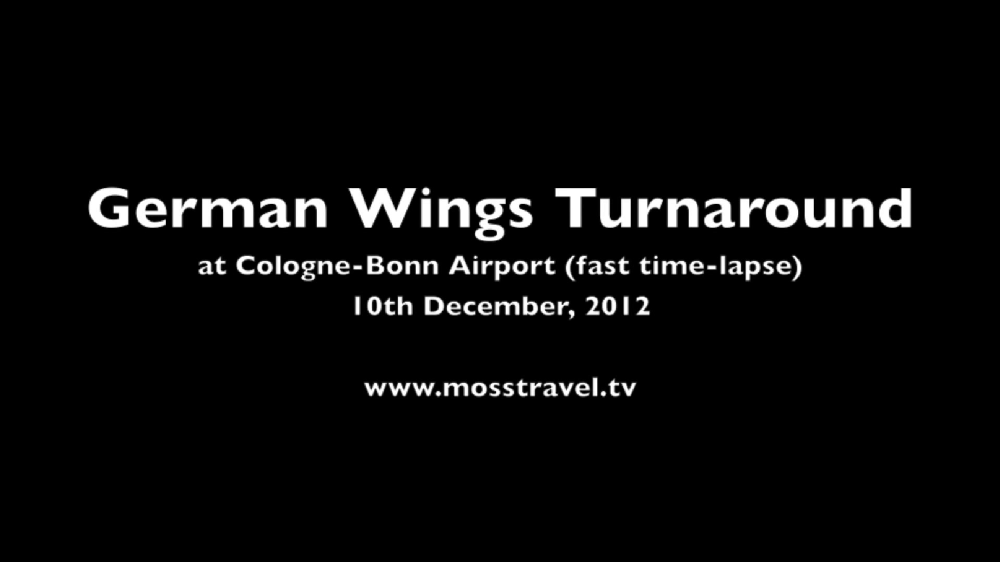

Processing frames:   1%|          | 50/7244 [00:45<1:07:36,  1.77it/s]

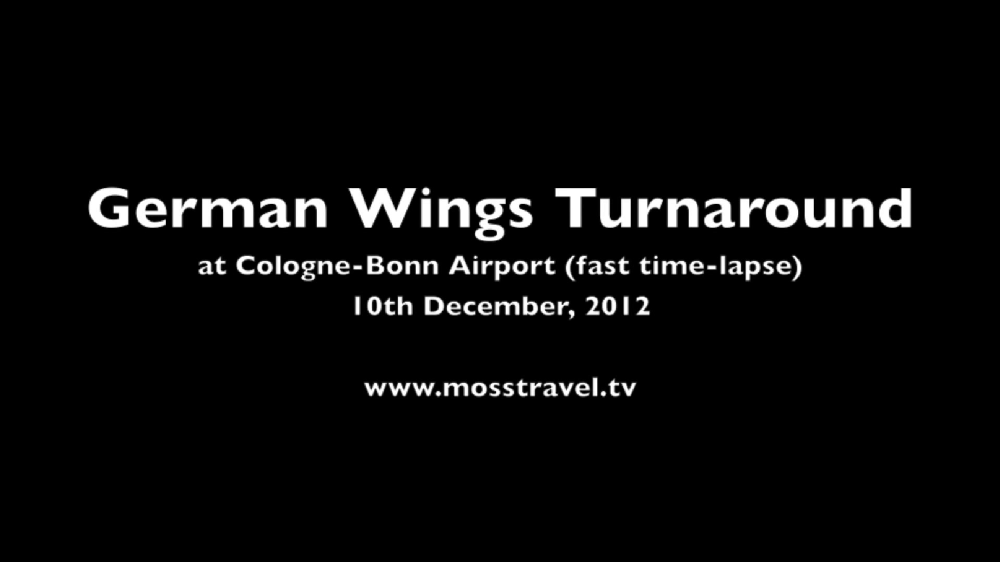

Processing frames:   1%|          | 51/7244 [00:46<1:06:39,  1.80it/s]

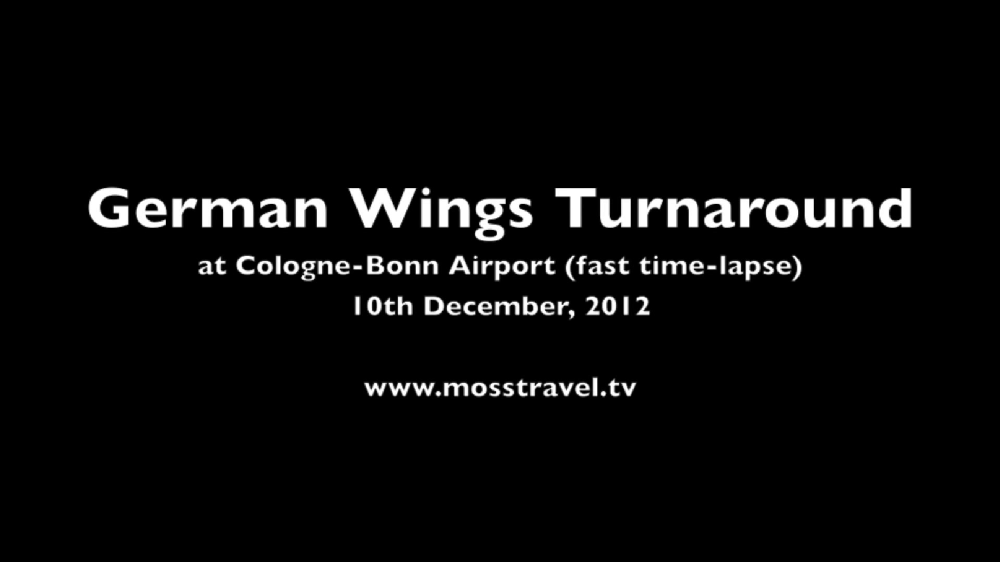

Processing frames:   1%|          | 52/7244 [00:46<1:07:23,  1.78it/s]

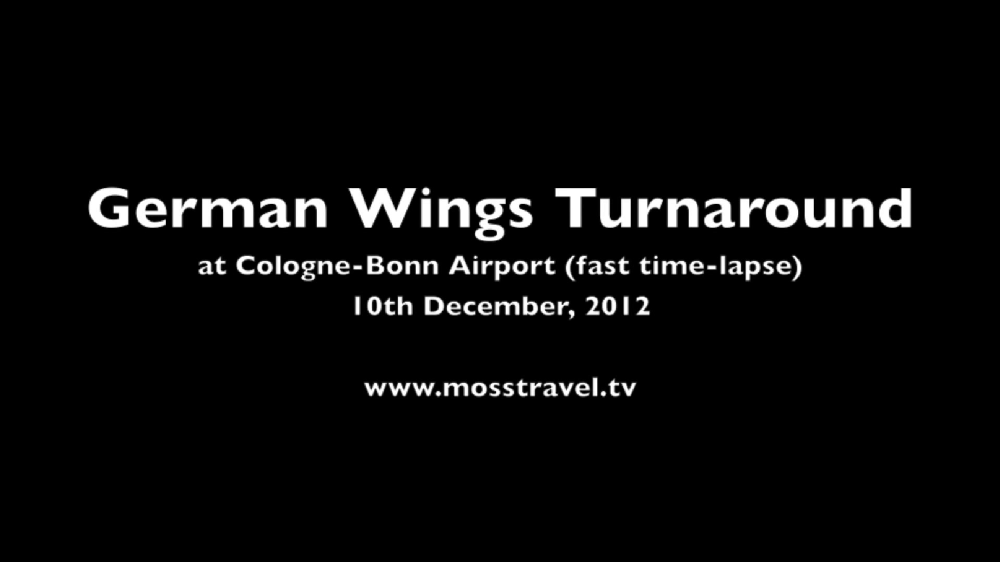

Processing frames:   1%|          | 53/7244 [00:47<1:06:53,  1.79it/s]

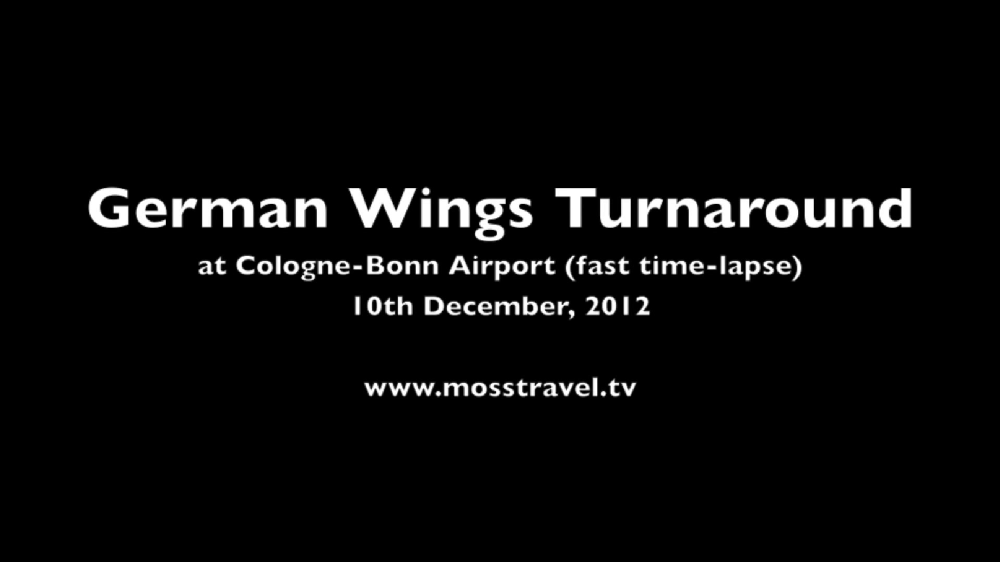

Processing frames:   1%|          | 54/7244 [00:47<1:07:03,  1.79it/s]

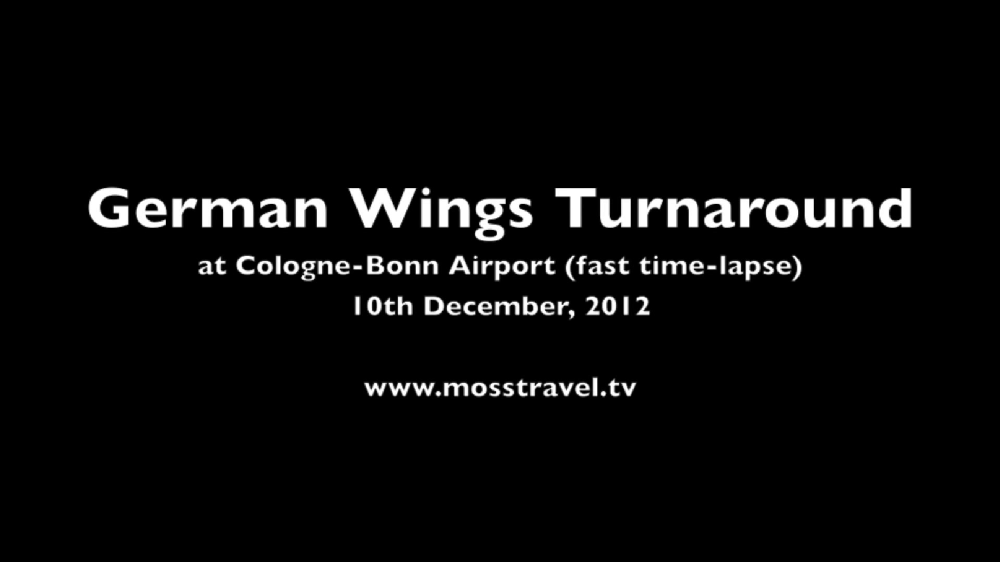

Processing frames:   1%|          | 55/7244 [00:48<1:07:28,  1.78it/s]

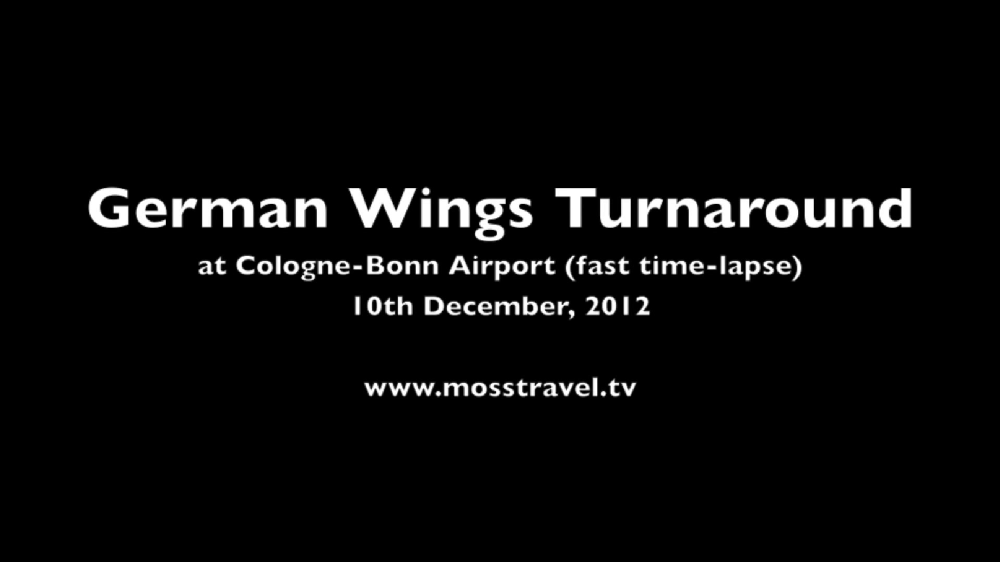

Processing frames:   1%|          | 56/7244 [00:49<1:07:27,  1.78it/s]

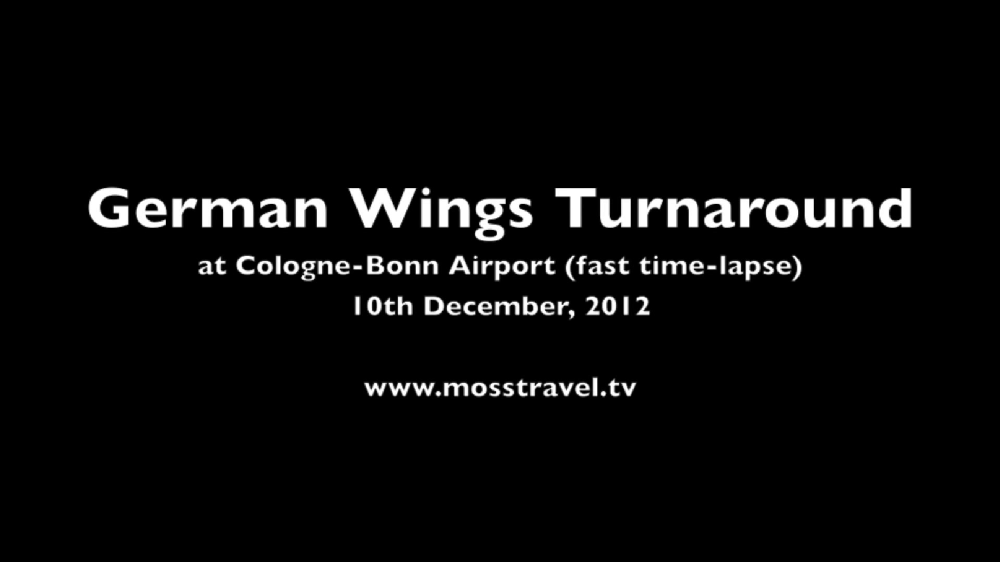

Processing frames:   1%|          | 57/7244 [00:49<1:07:09,  1.78it/s]

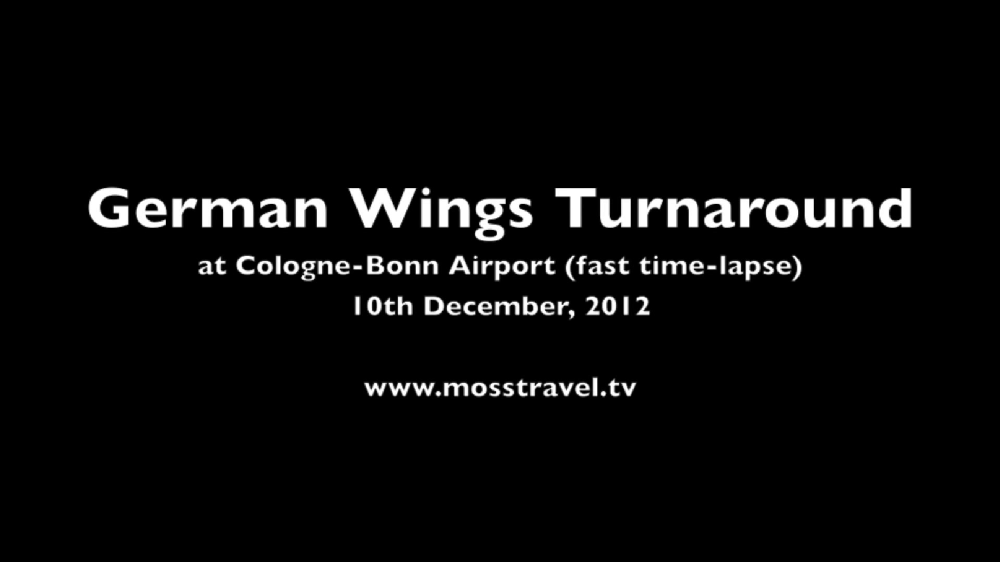

Processing frames:   1%|          | 58/7244 [00:50<1:16:32,  1.56it/s]

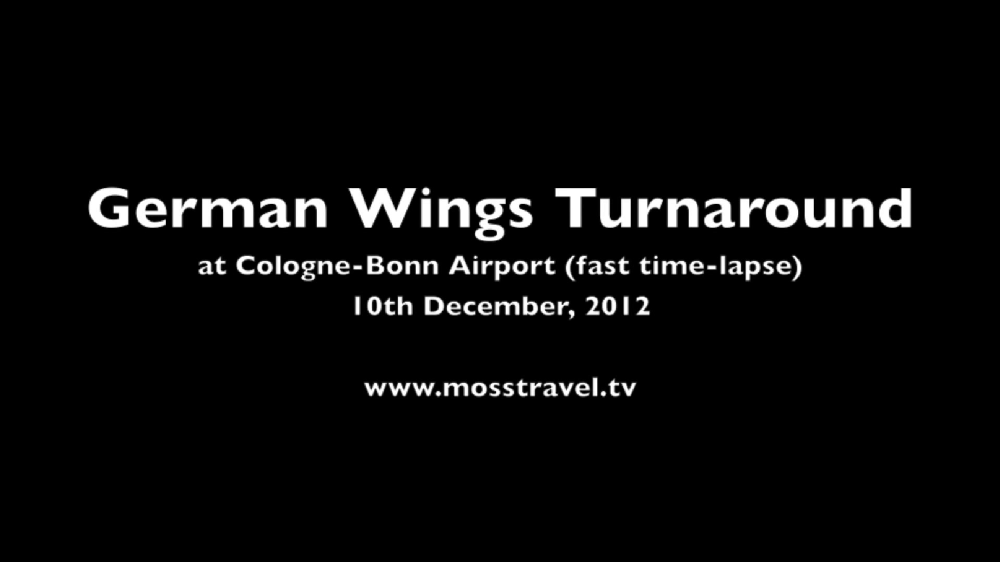

Processing frames:   1%|          | 59/7244 [00:51<1:24:36,  1.42it/s]

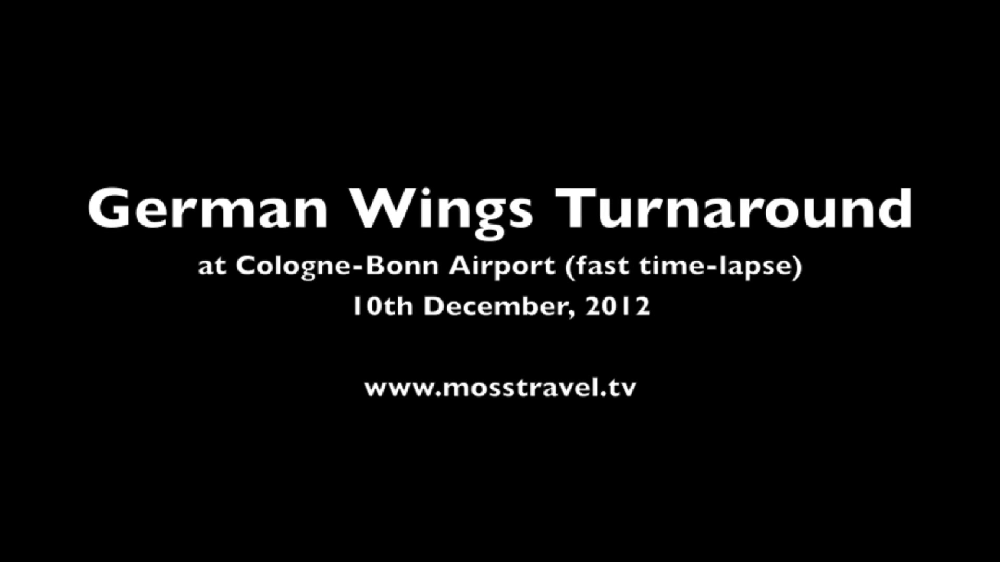

Processing frames:   1%|          | 60/7244 [00:52<1:28:51,  1.35it/s]

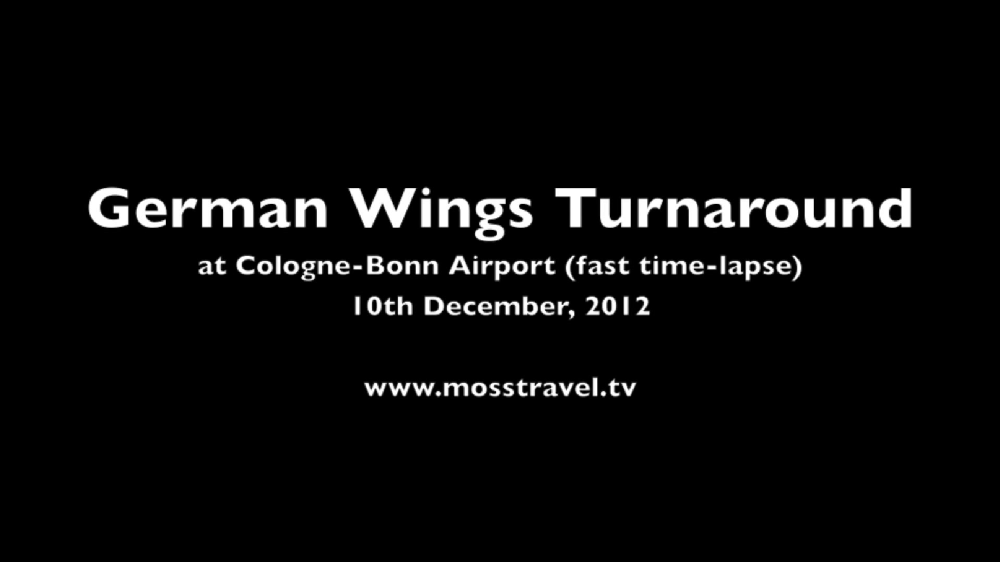

Processing frames:   1%|          | 61/7244 [00:53<1:34:51,  1.26it/s]

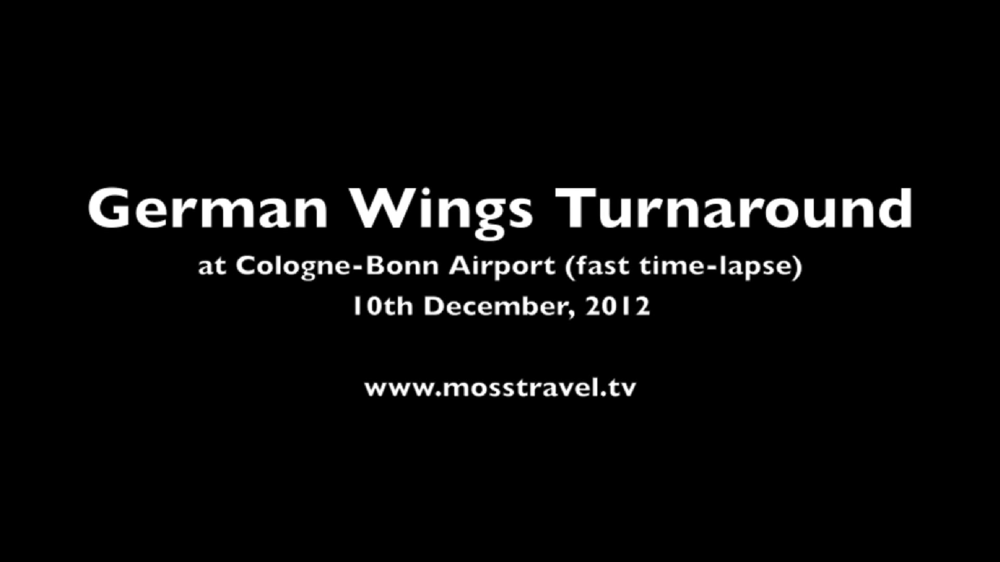

Processing frames:   1%|          | 62/7244 [00:53<1:34:53,  1.26it/s]

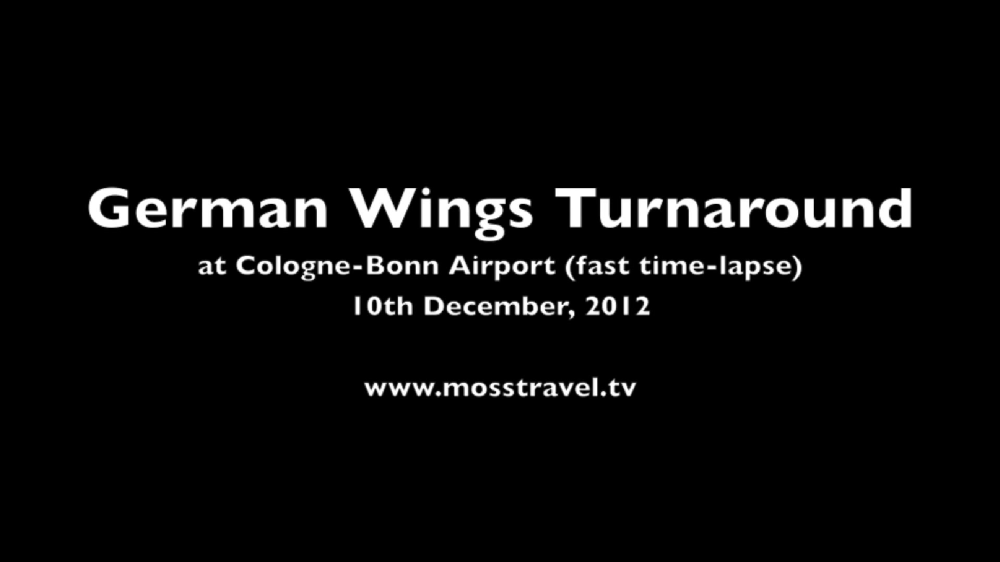

Processing frames:   1%|          | 63/7244 [00:54<1:35:06,  1.26it/s]

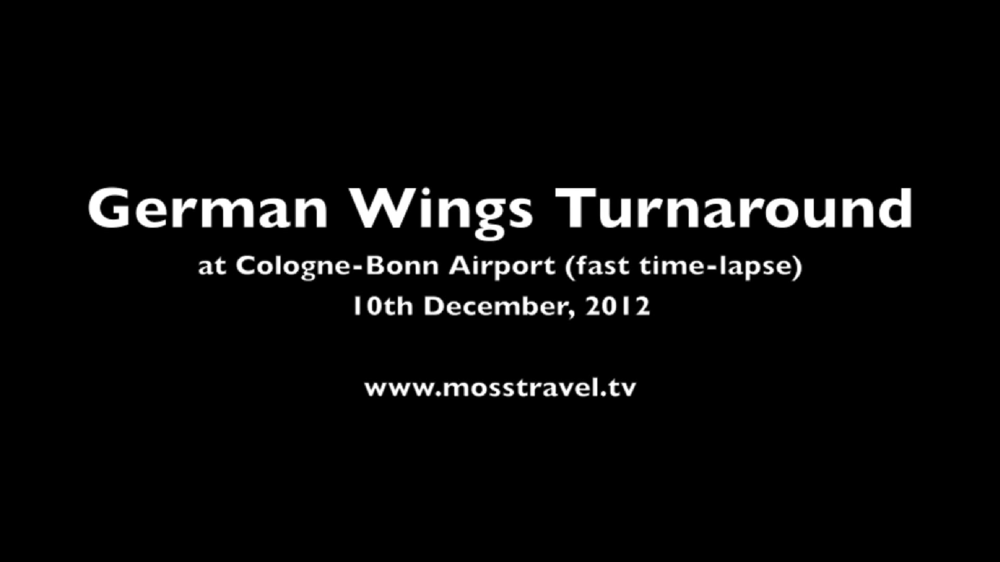

Processing frames:   1%|          | 64/7244 [00:55<1:34:49,  1.26it/s]

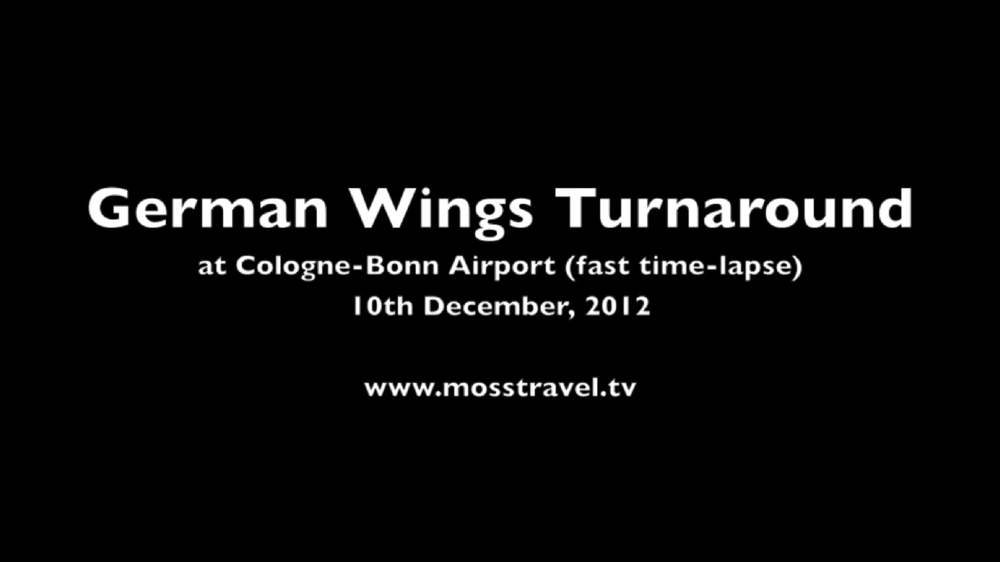

Processing frames:   1%|          | 65/7244 [00:56<1:35:36,  1.25it/s]

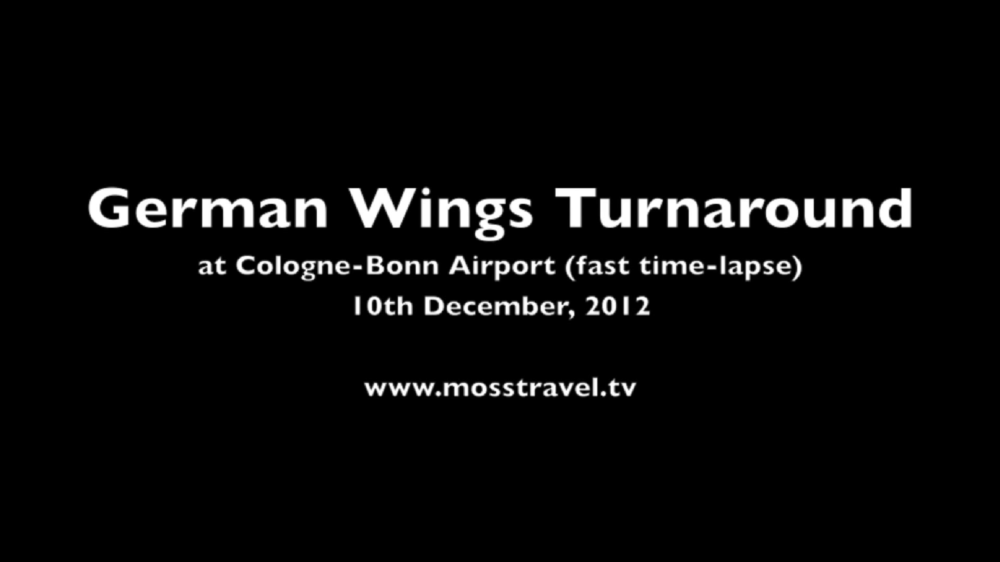

Processing frames:   1%|          | 66/7244 [00:57<1:34:53,  1.26it/s]

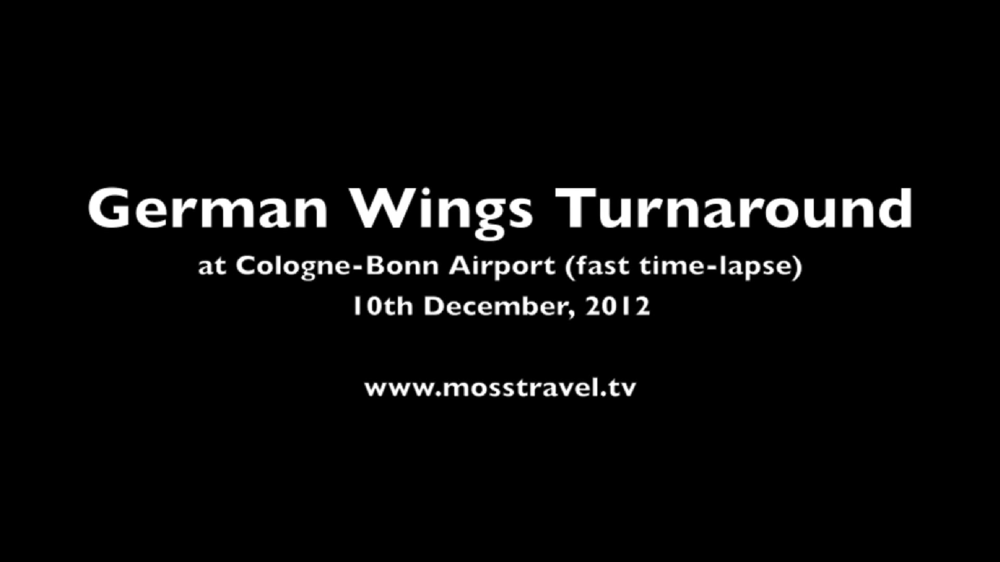

Processing frames:   1%|          | 67/7244 [00:57<1:34:22,  1.27it/s]

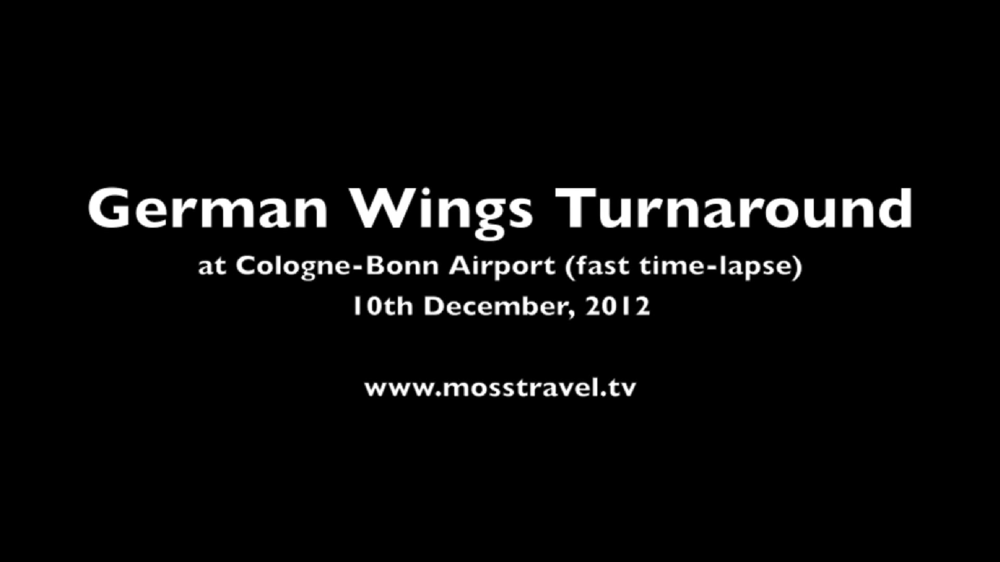

Processing frames:   1%|          | 68/7244 [00:58<1:29:33,  1.34it/s]

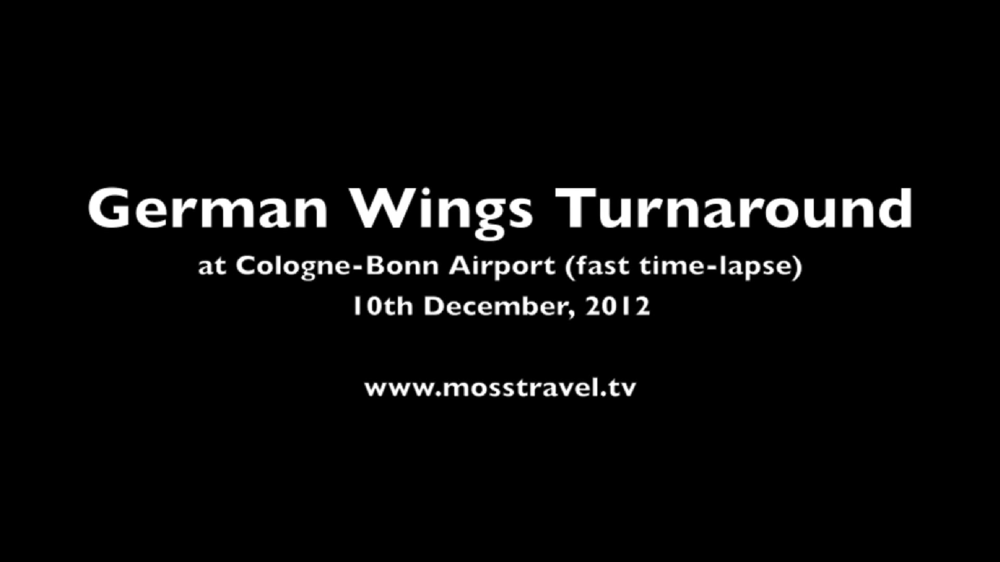

Processing frames:   1%|          | 69/7244 [00:59<1:23:45,  1.43it/s]

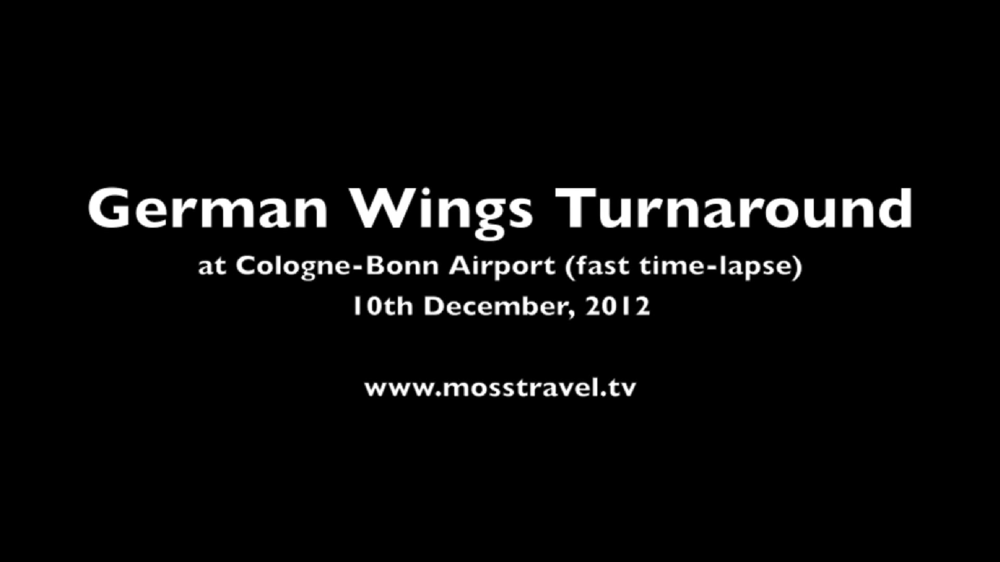

Processing frames:   1%|          | 70/7244 [00:59<1:20:47,  1.48it/s]

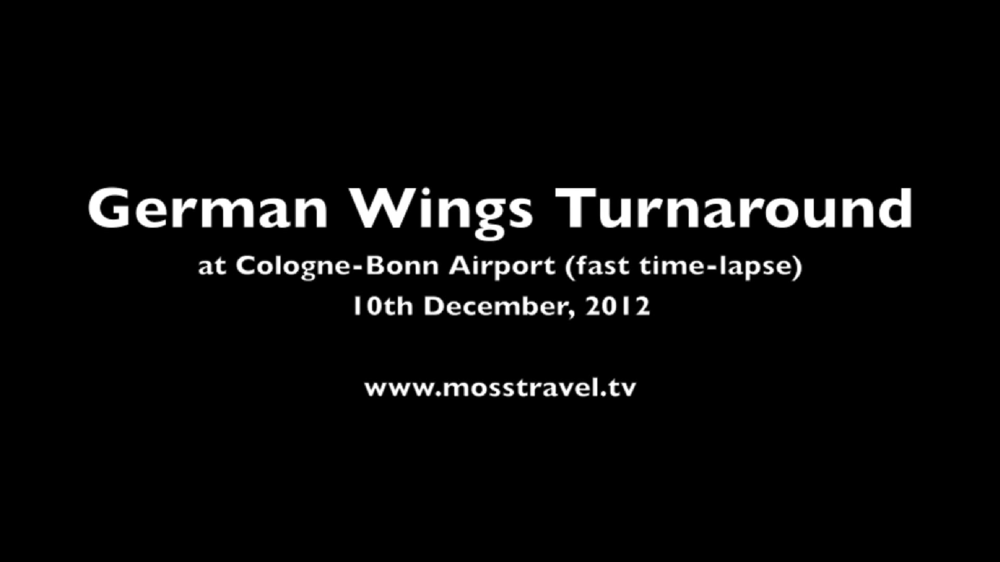

Processing frames:   1%|          | 71/7244 [01:00<1:18:19,  1.53it/s]

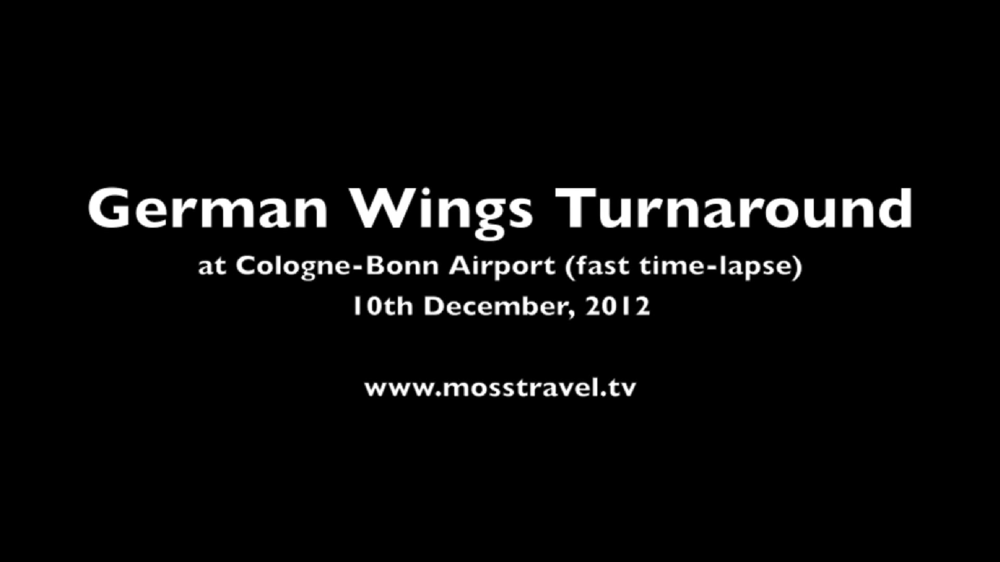

Processing frames:   1%|          | 72/7244 [01:00<1:16:27,  1.56it/s]

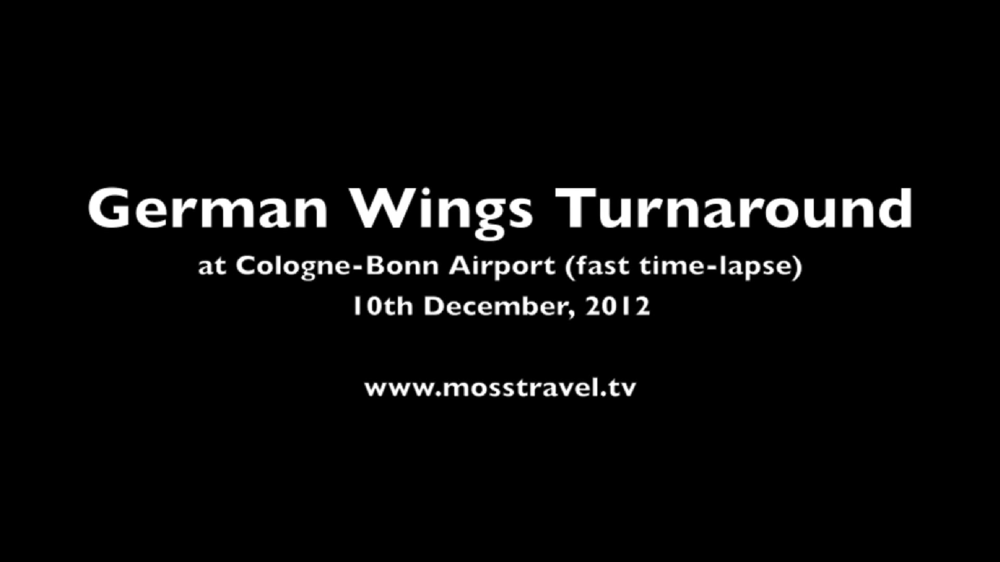

Processing frames:   1%|          | 73/7244 [01:01<1:14:48,  1.60it/s]

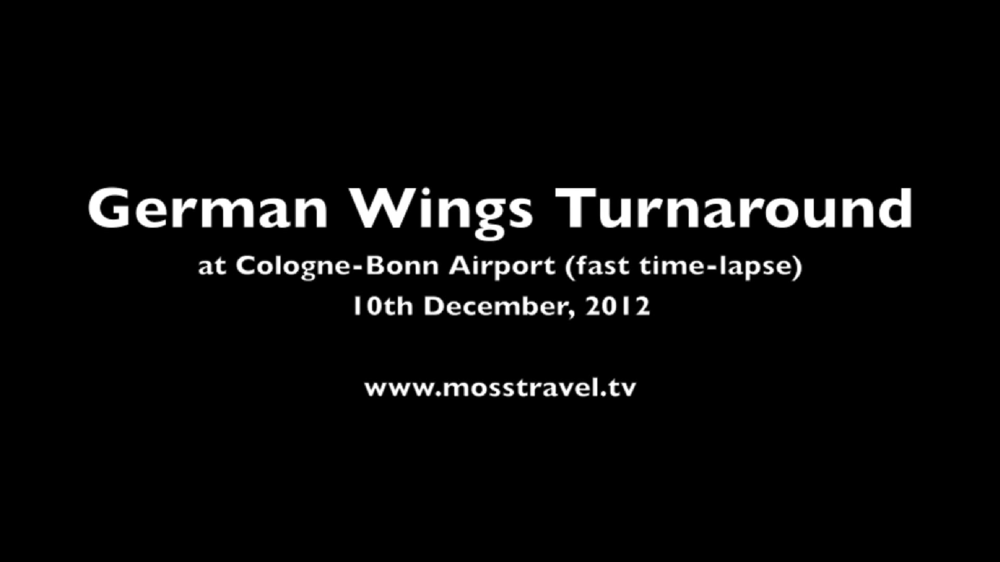

Processing frames:   1%|          | 74/7244 [01:02<1:14:42,  1.60it/s]

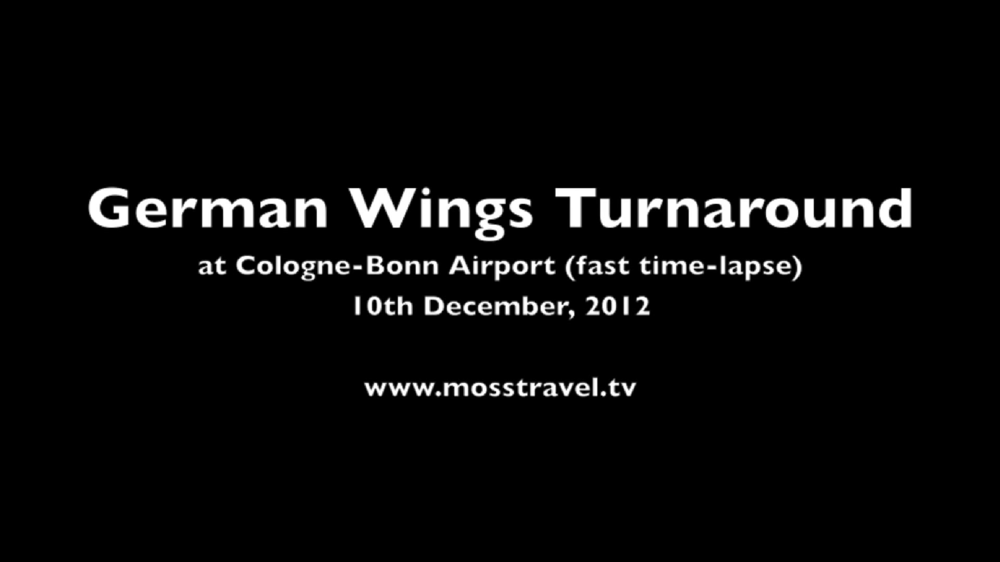

Processing frames:   1%|          | 75/7244 [01:02<1:15:07,  1.59it/s]

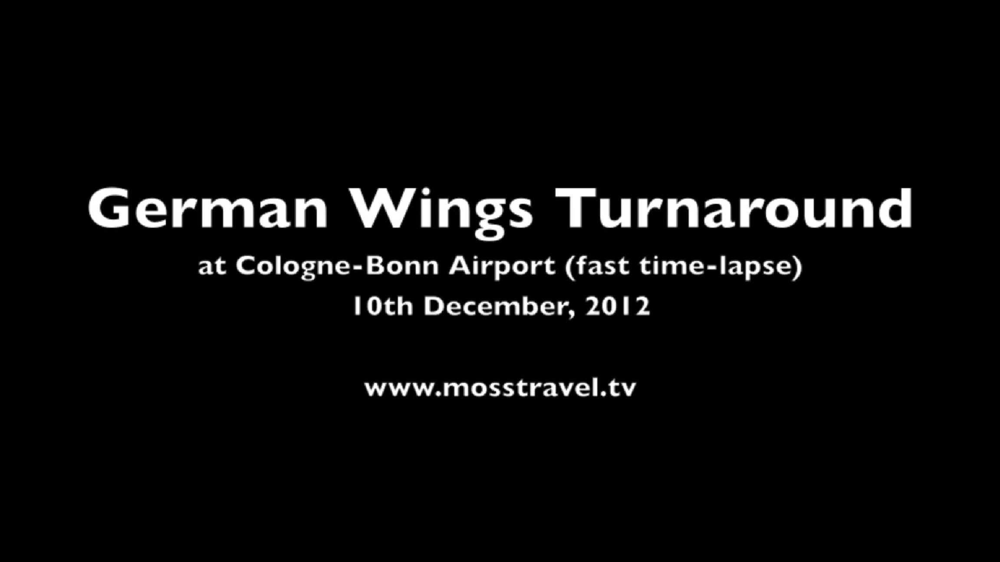

Processing frames:   1%|          | 76/7244 [01:03<1:15:00,  1.59it/s]

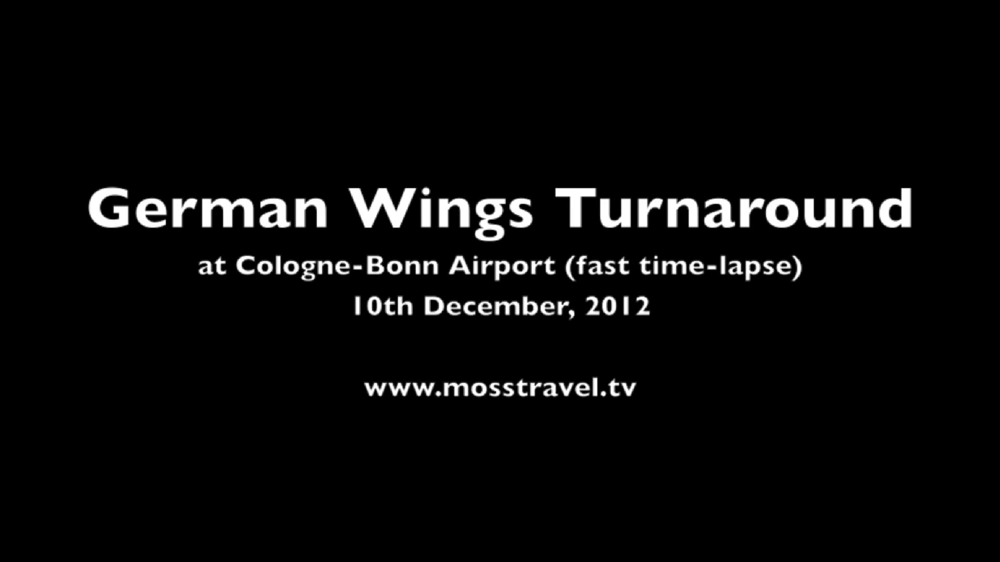

Processing frames:   1%|          | 77/7244 [01:04<1:15:35,  1.58it/s]

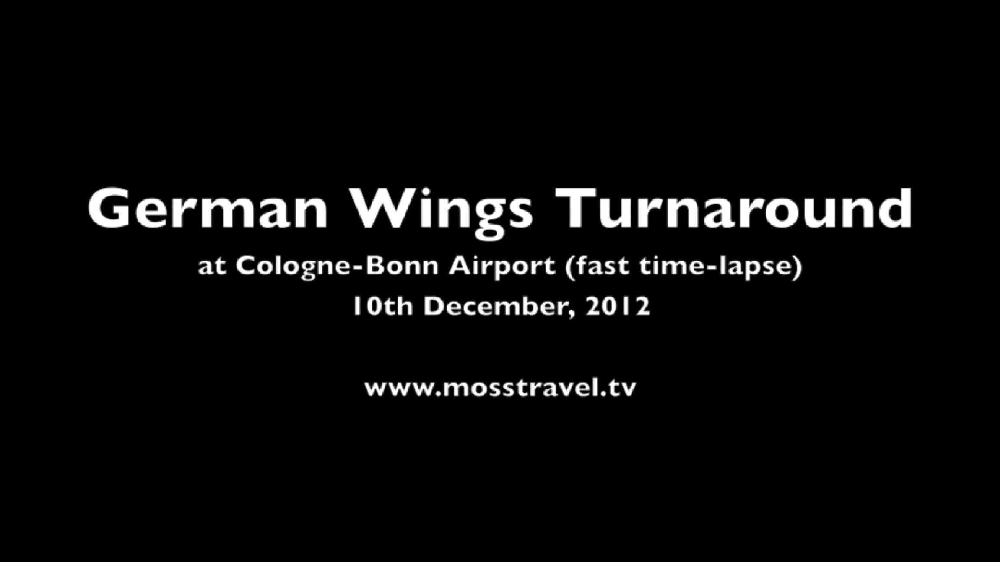

Processing frames:   1%|          | 78/7244 [01:04<1:15:13,  1.59it/s]

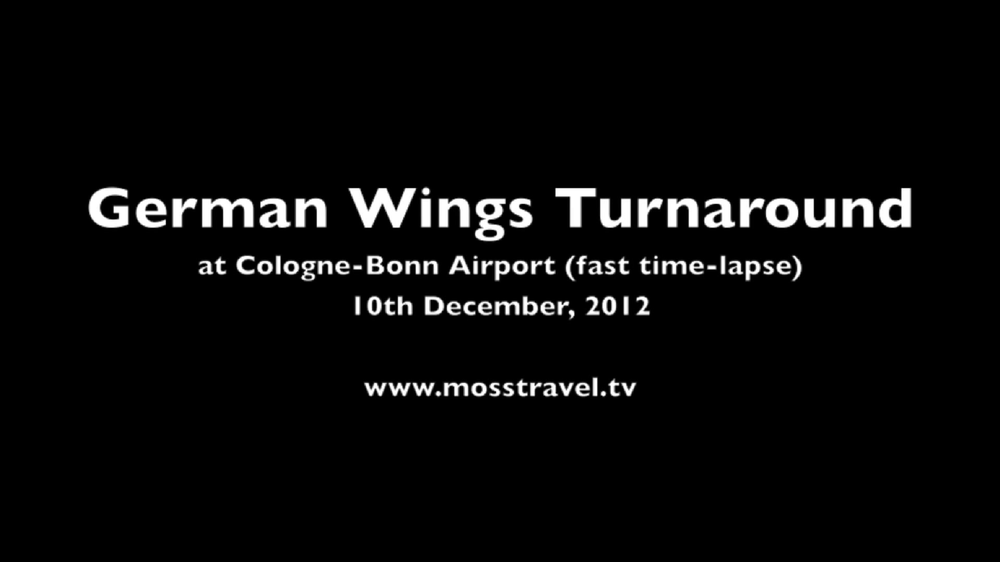

Processing frames:   1%|          | 79/7244 [01:05<1:15:16,  1.59it/s]

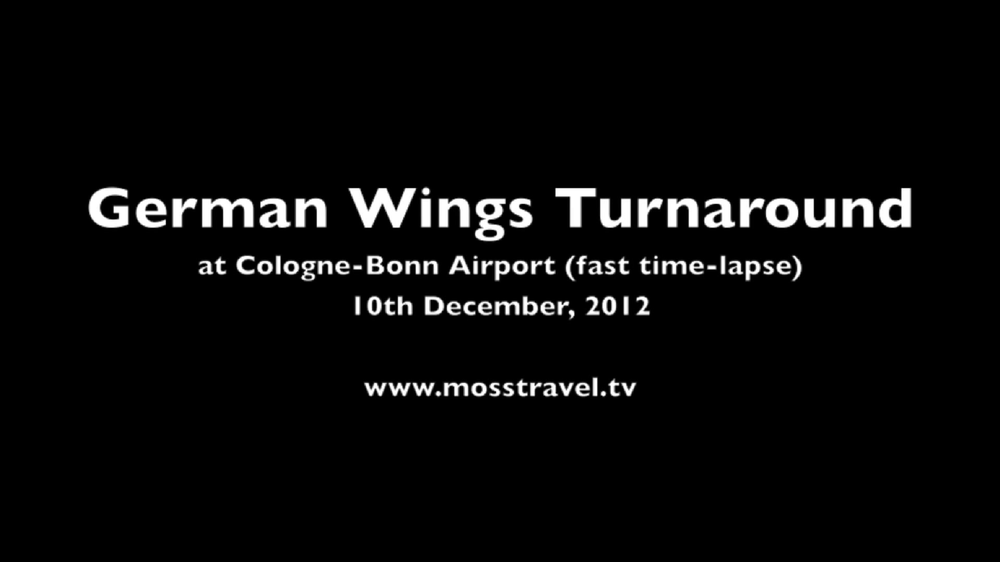

Processing frames:   1%|          | 80/7244 [01:05<1:15:47,  1.58it/s]

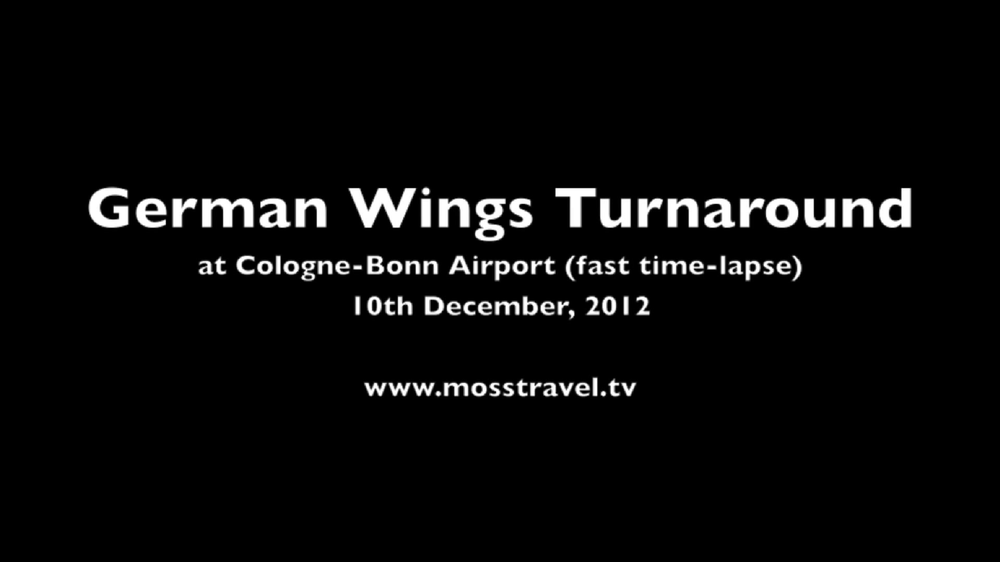

Processing frames:   1%|          | 81/7244 [01:06<1:15:27,  1.58it/s]

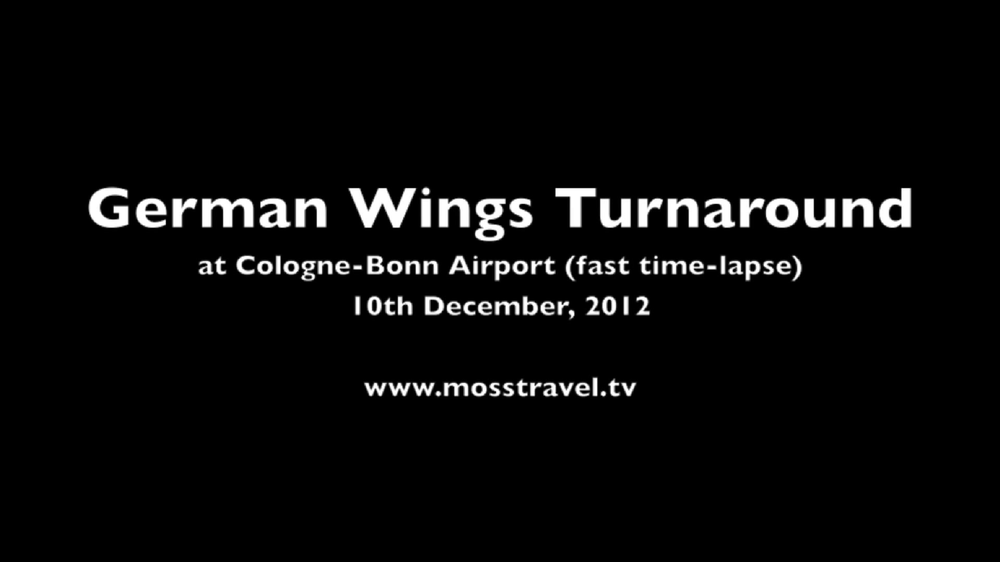

Processing frames:   1%|          | 82/7244 [01:07<1:15:57,  1.57it/s]

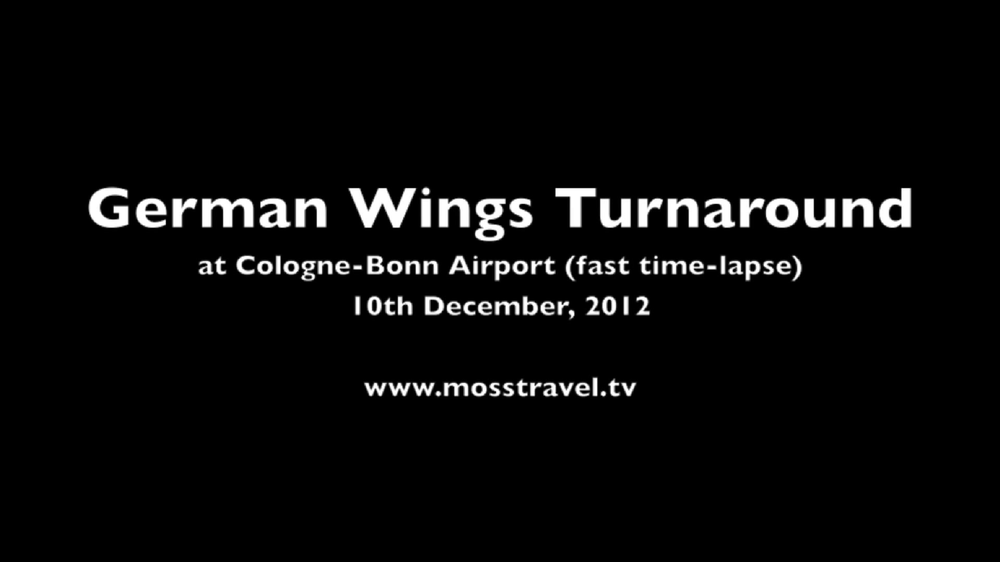

Processing frames:   1%|          | 83/7244 [01:07<1:17:22,  1.54it/s]

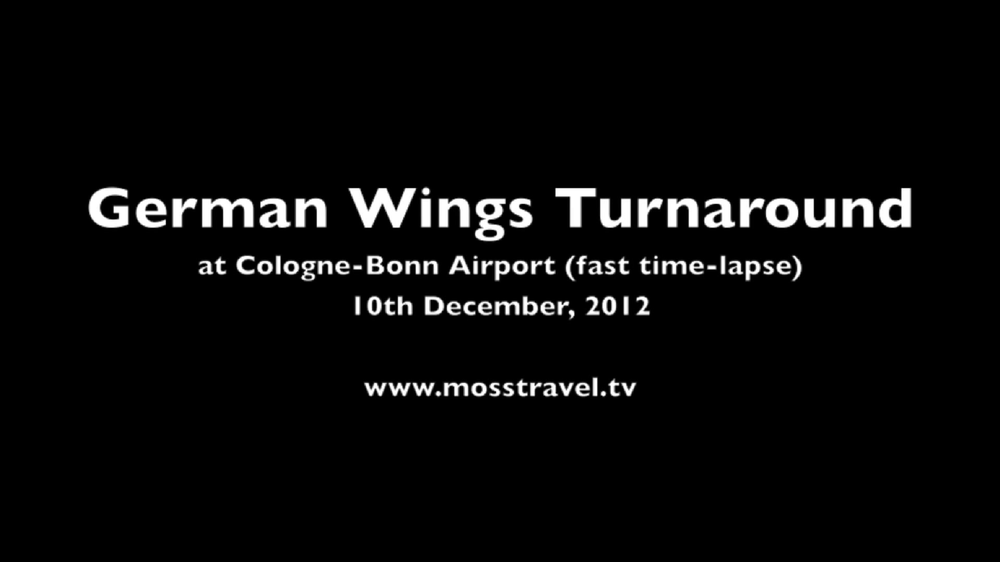

Processing frames:   1%|          | 84/7244 [01:08<1:21:18,  1.47it/s]

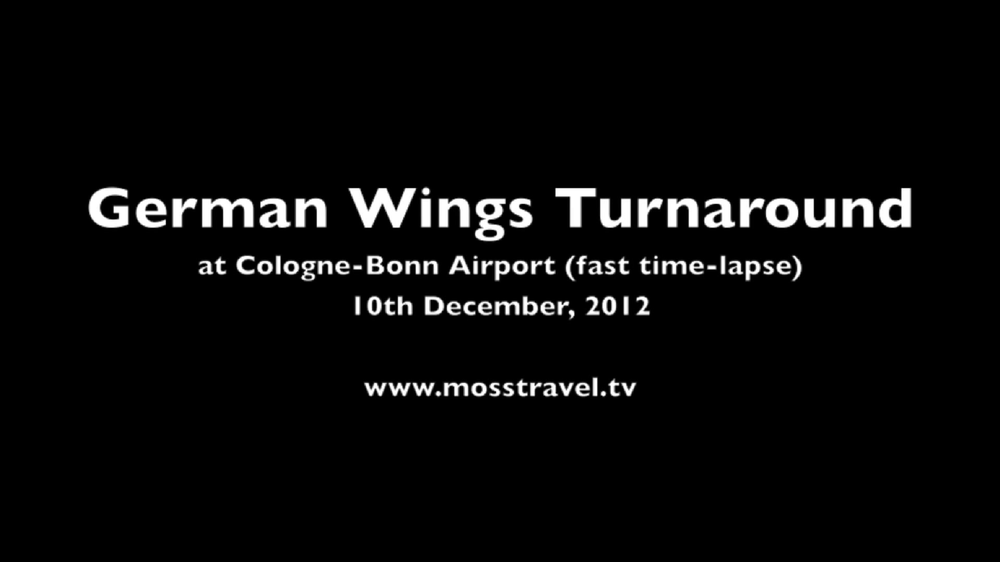

Processing frames:   1%|          | 85/7244 [01:09<1:25:38,  1.39it/s]

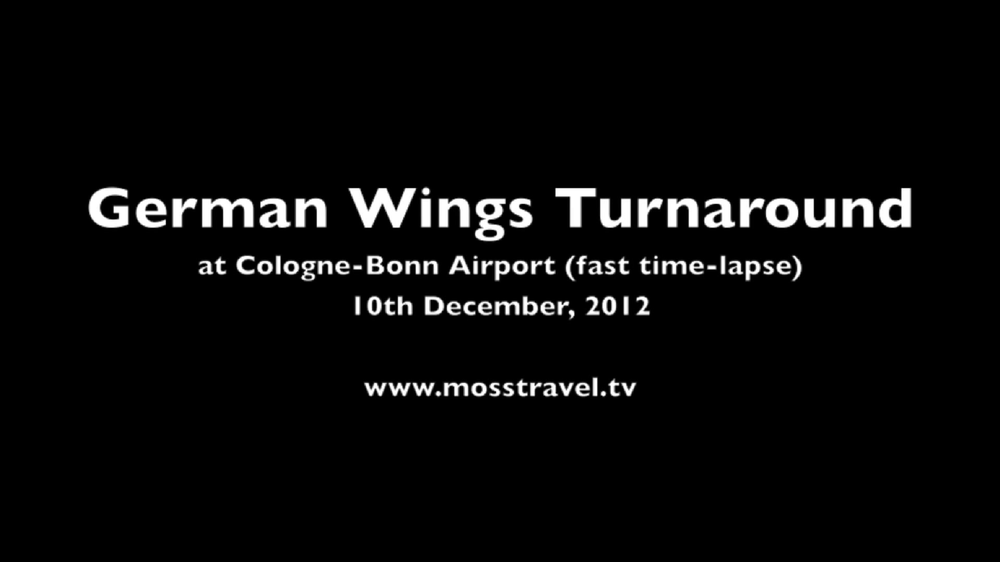

Processing frames:   1%|          | 86/7244 [01:10<1:28:24,  1.35it/s]

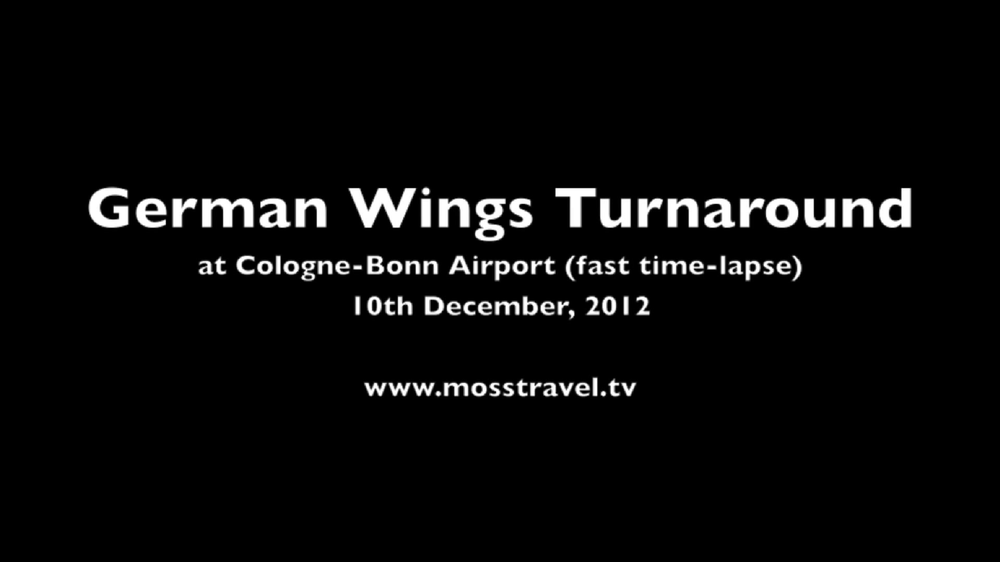

Processing frames:   1%|          | 87/7244 [01:11<1:31:47,  1.30it/s]

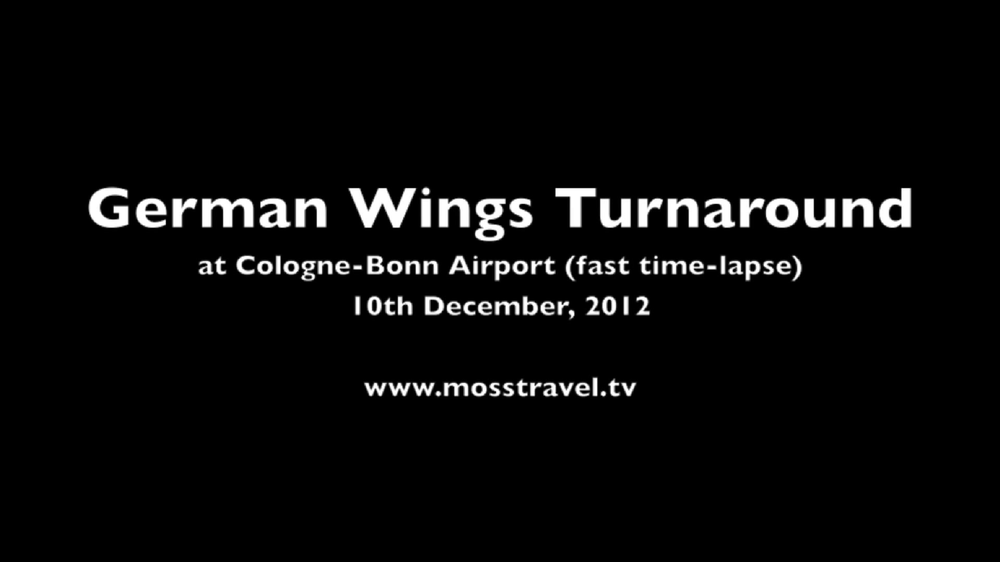

Processing frames:   1%|          | 88/7244 [01:11<1:35:16,  1.25it/s]

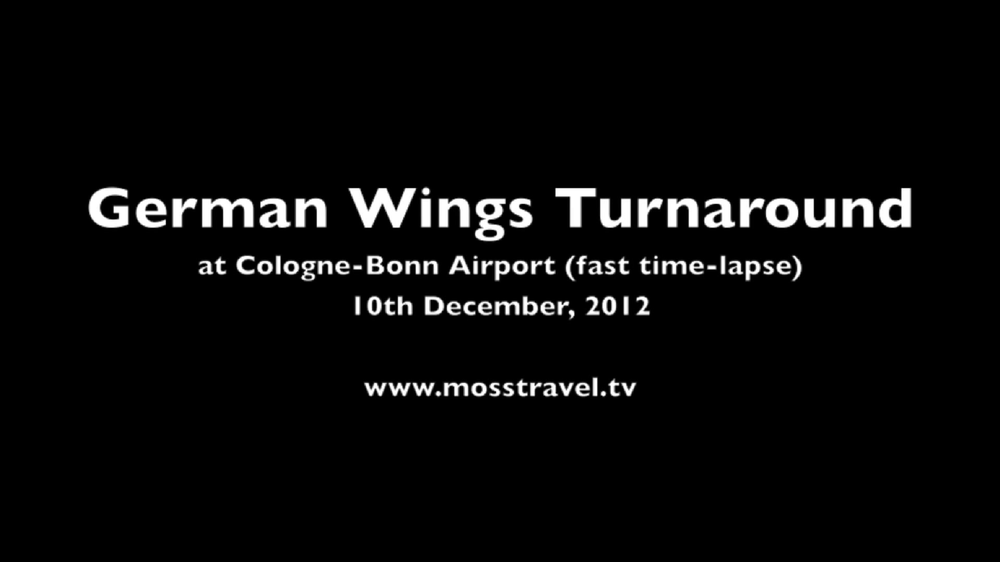

Processing frames:   1%|          | 89/7244 [01:12<1:34:57,  1.26it/s]

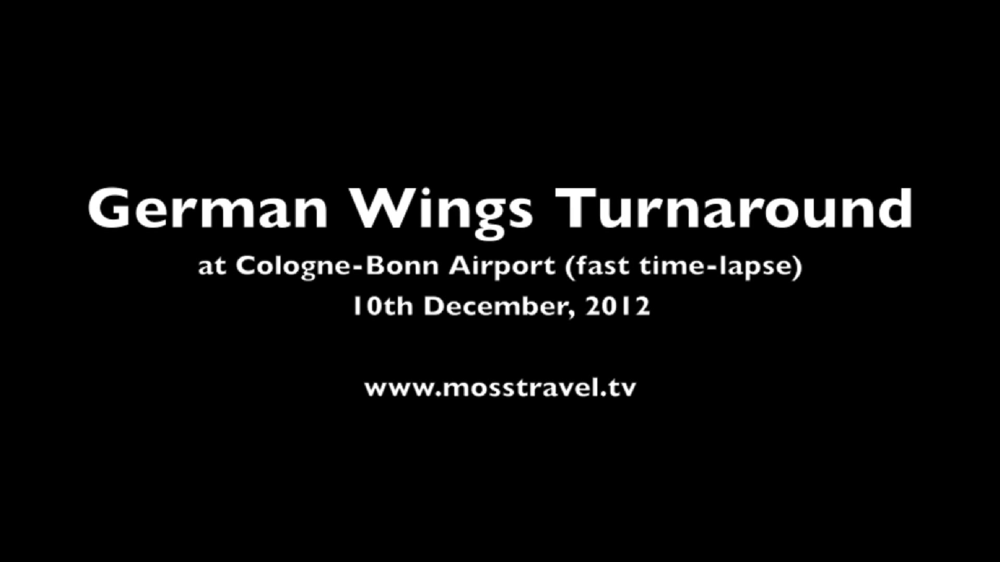

Processing frames:   1%|          | 90/7244 [01:13<1:35:18,  1.25it/s]

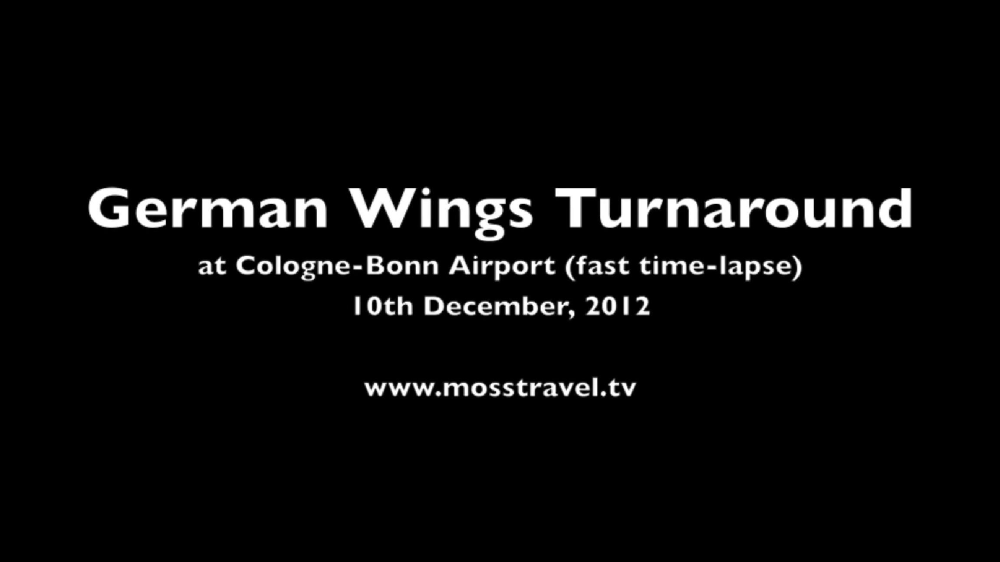

Processing frames:   1%|▏         | 91/7244 [01:14<1:37:07,  1.23it/s]

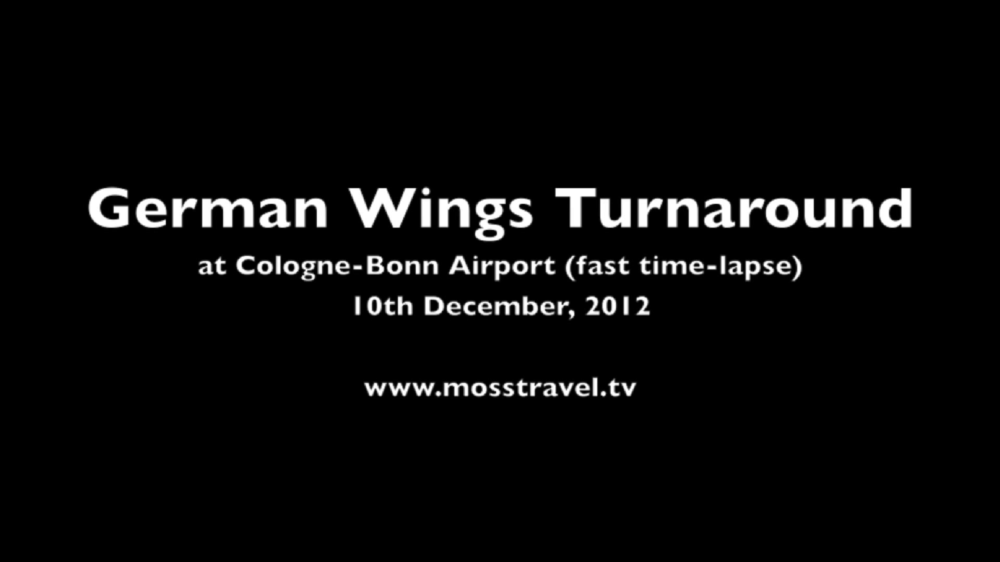

Processing frames:   1%|▏         | 92/7244 [01:15<1:35:34,  1.25it/s]

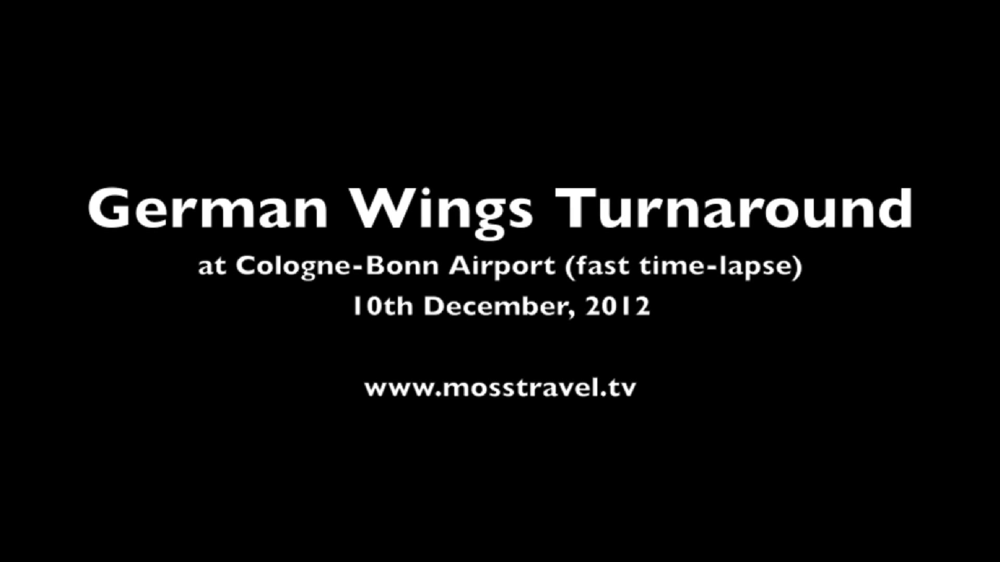

Processing frames:   1%|▏         | 93/7244 [01:16<1:38:26,  1.21it/s]

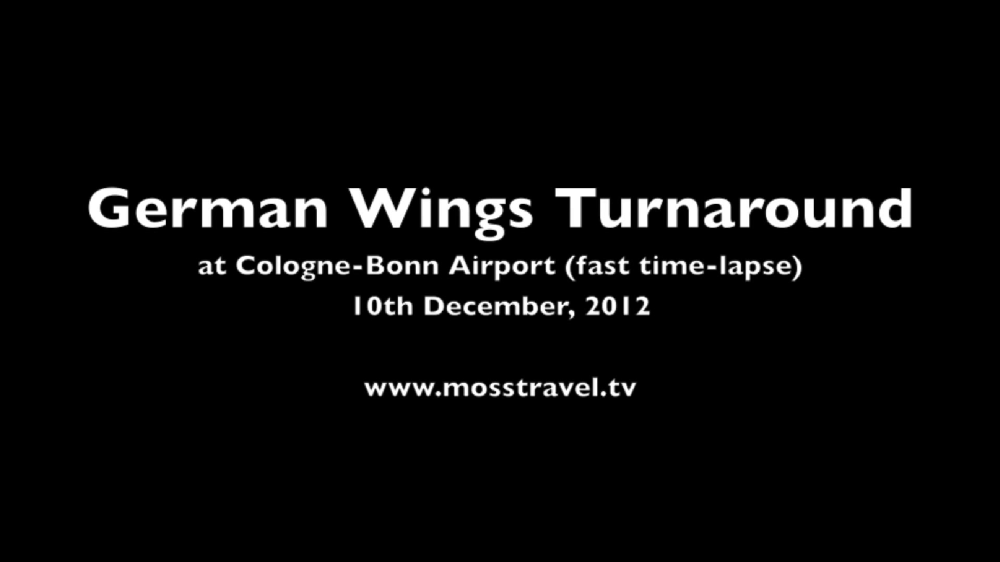

Processing frames:   1%|▏         | 94/7244 [01:16<1:36:40,  1.23it/s]

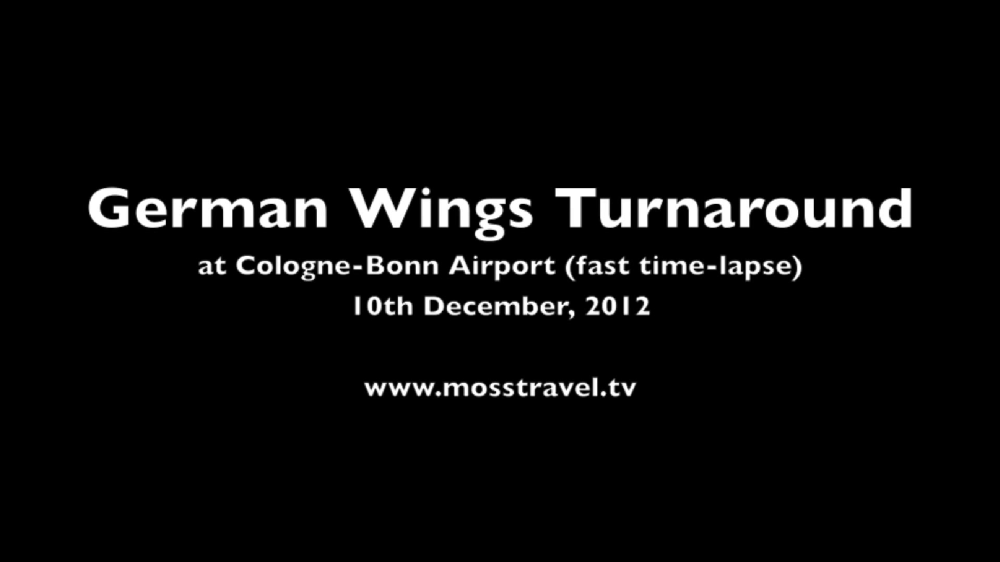

Processing frames:   1%|▏         | 95/7244 [01:17<1:37:16,  1.22it/s]

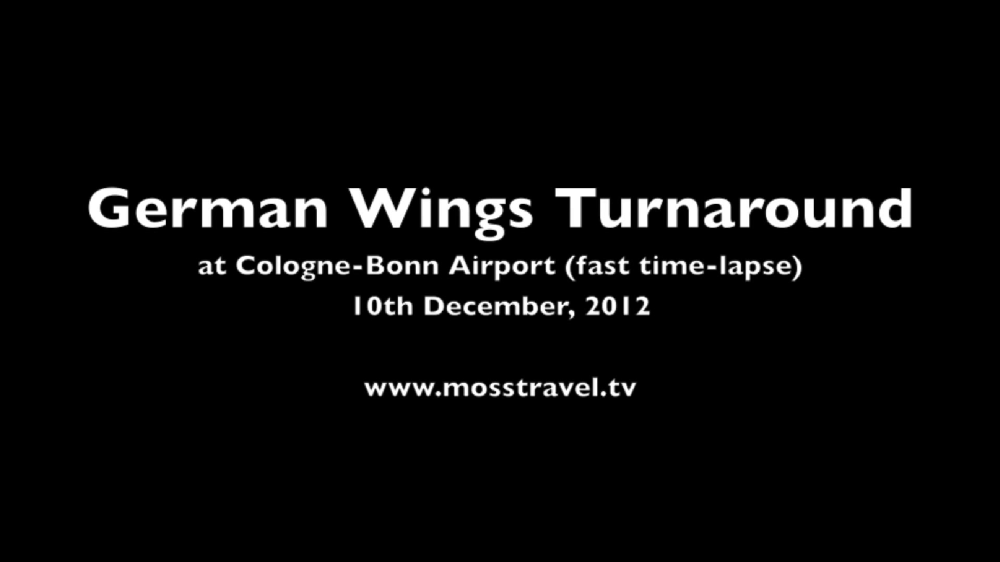

Processing frames:   1%|▏         | 96/7244 [01:18<1:36:30,  1.23it/s]

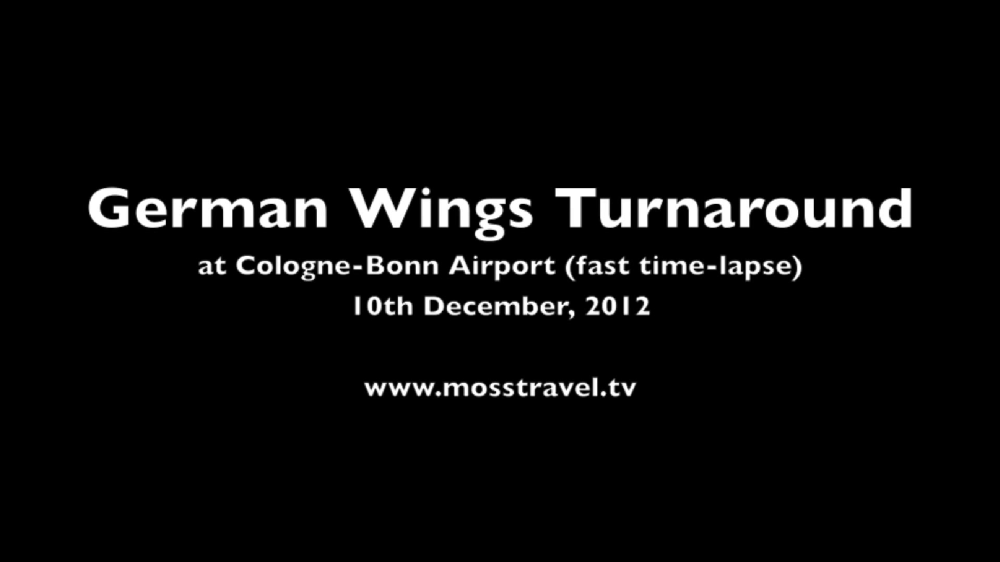

Processing frames:   1%|▏         | 97/7244 [01:19<1:48:43,  1.10it/s]

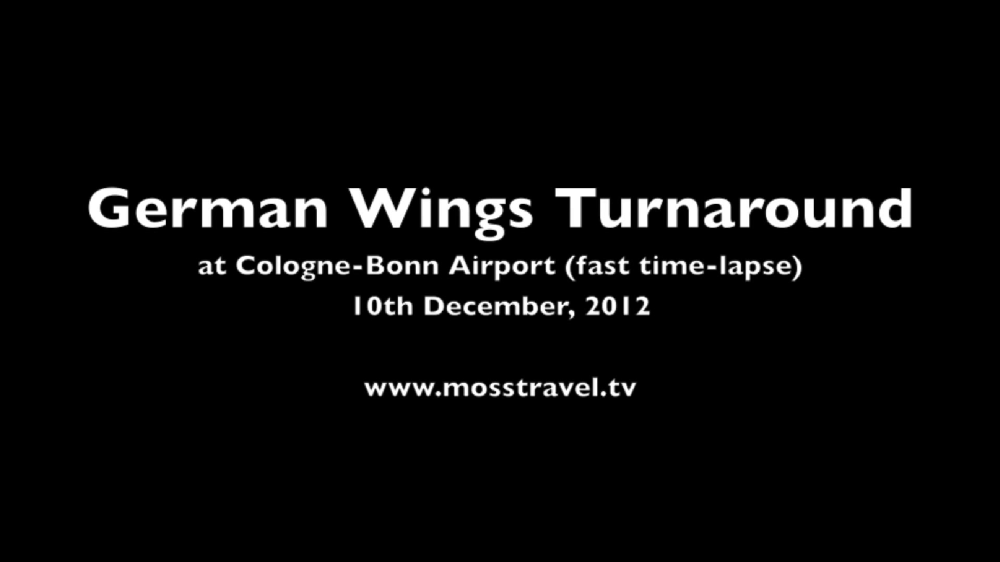

Processing frames:   1%|▏         | 98/7244 [01:20<1:43:50,  1.15it/s]

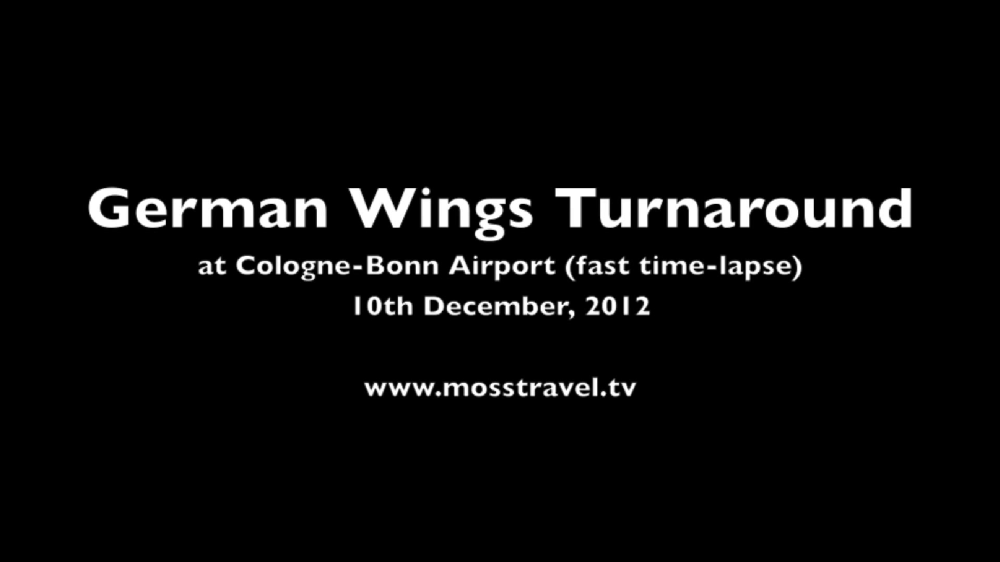

Processing frames:   1%|▏         | 99/7244 [01:21<1:40:58,  1.18it/s]

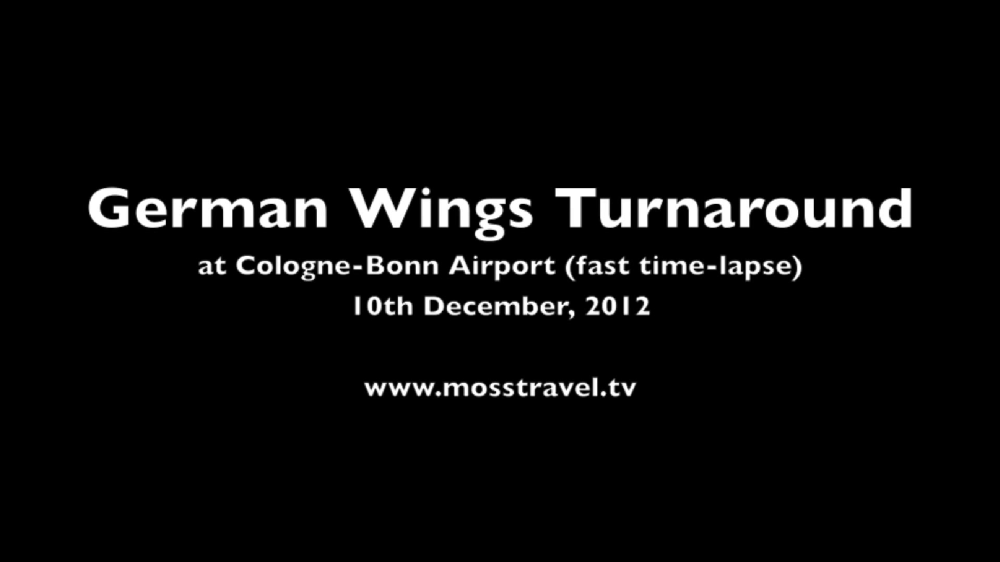

Processing frames:   1%|▏         | 100/7244 [01:21<1:37:26,  1.22it/s]

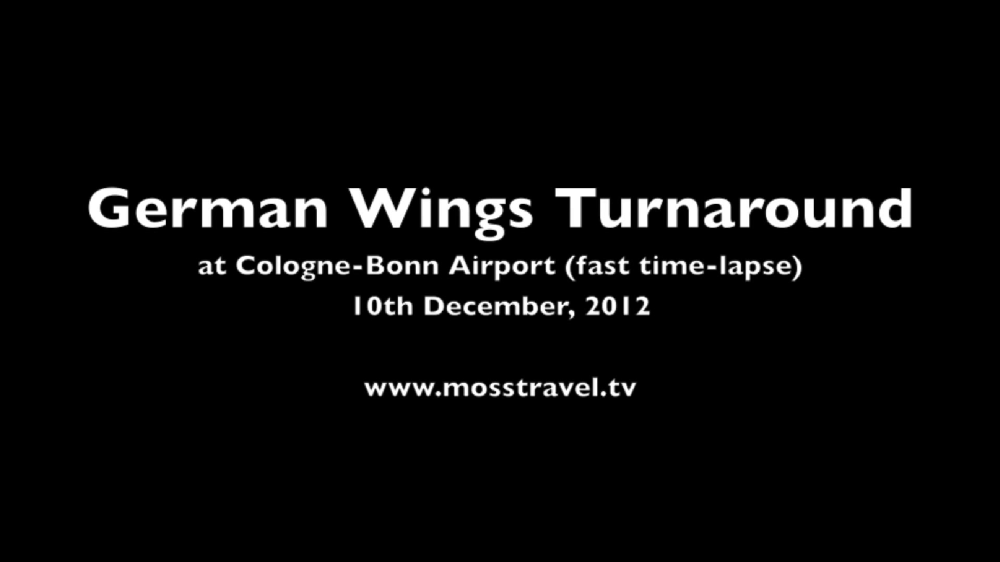

Processing frames:   1%|▏         | 101/7244 [01:22<1:34:23,  1.26it/s]

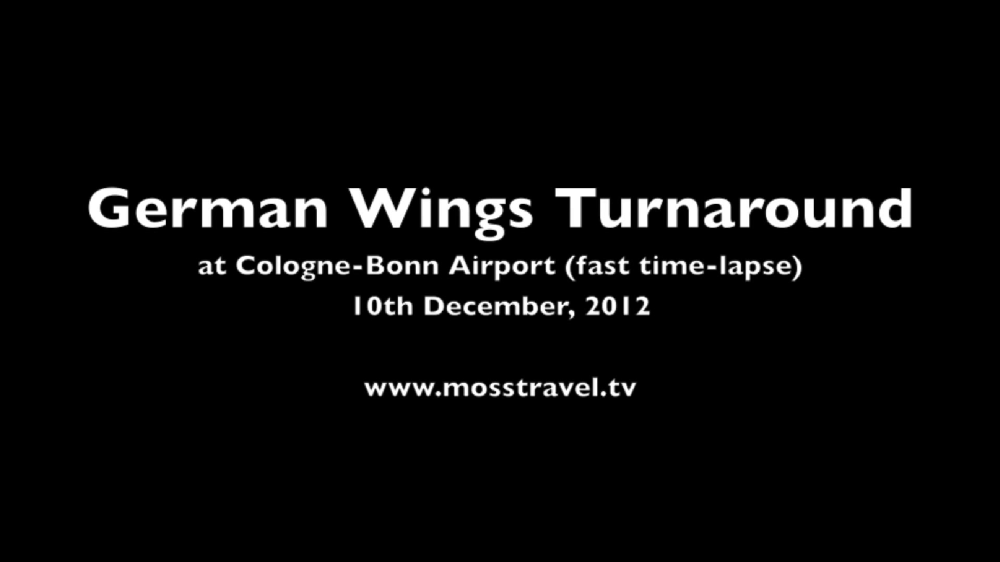

Processing frames:   1%|▏         | 102/7244 [01:23<1:31:53,  1.30it/s]

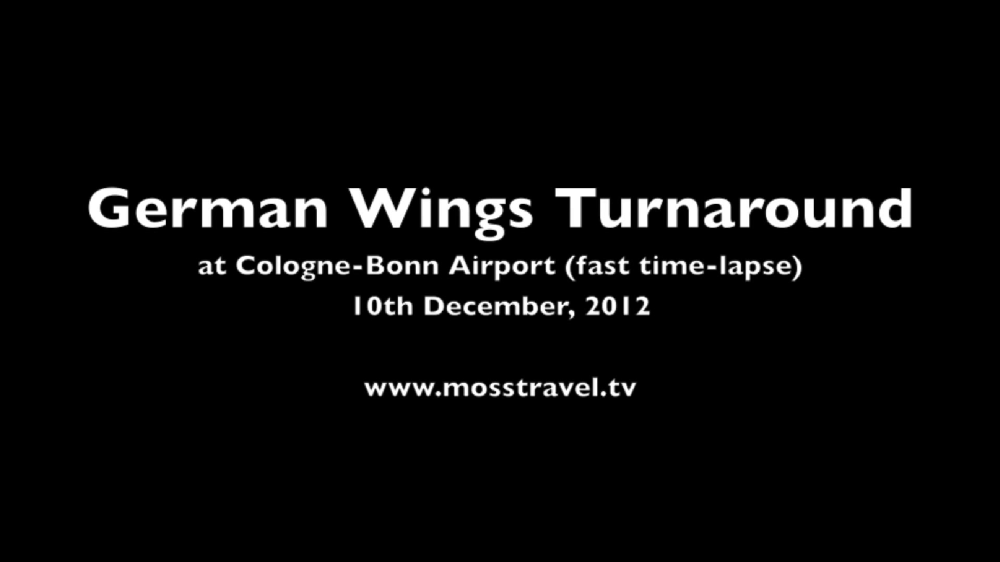

Processing frames:   1%|▏         | 103/7244 [01:24<1:29:37,  1.33it/s]

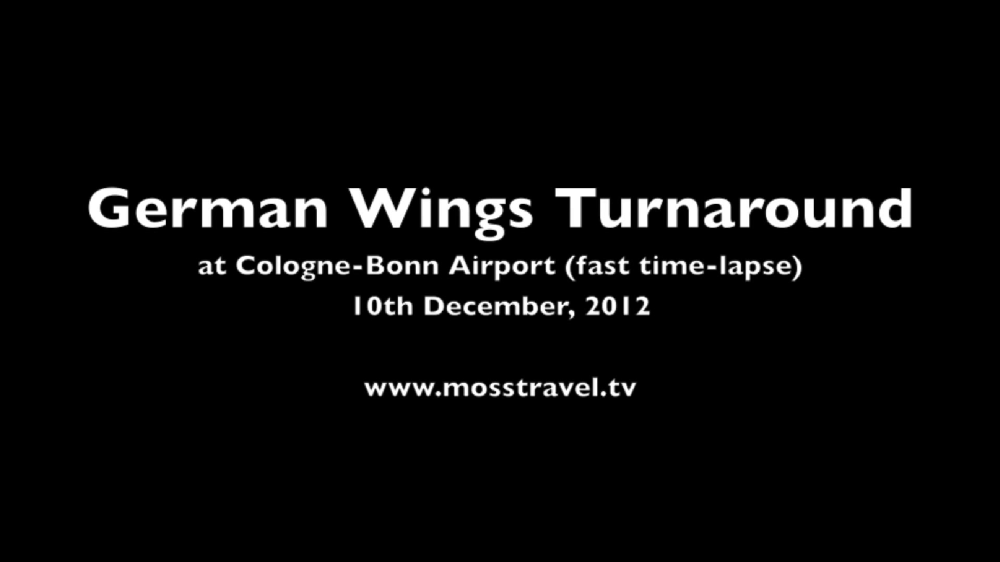

Processing frames:   1%|▏         | 104/7244 [01:24<1:28:36,  1.34it/s]

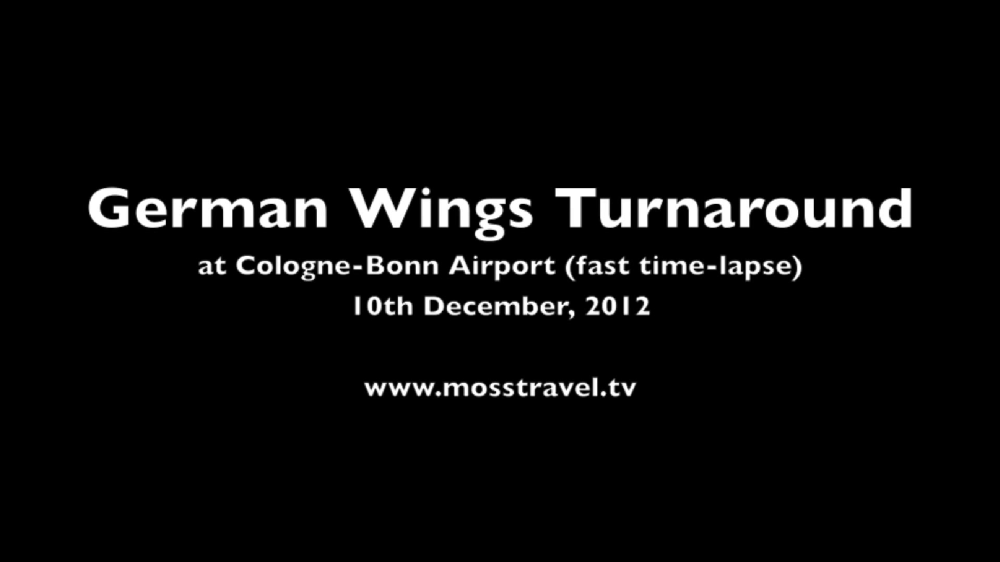

Processing frames:   1%|▏         | 105/7244 [01:25<1:27:04,  1.37it/s]

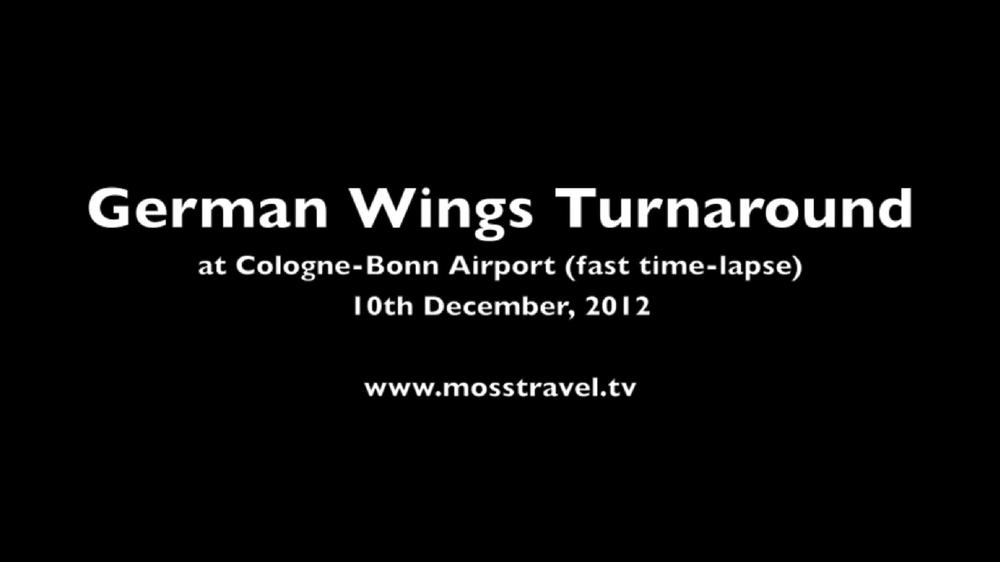

Processing frames:   1%|▏         | 106/7244 [01:26<1:26:31,  1.37it/s]

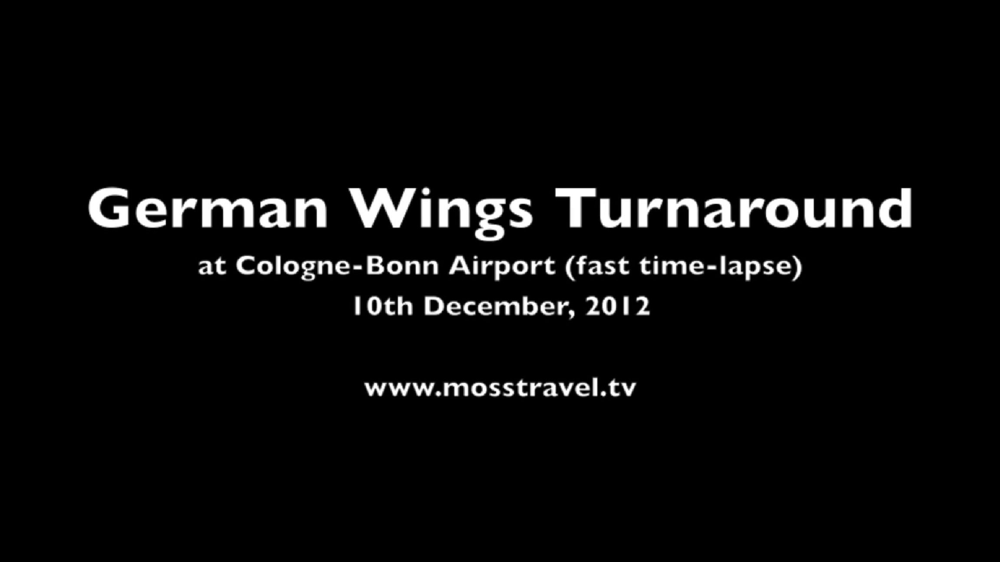

Processing frames:   1%|▏         | 107/7244 [01:26<1:26:04,  1.38it/s]

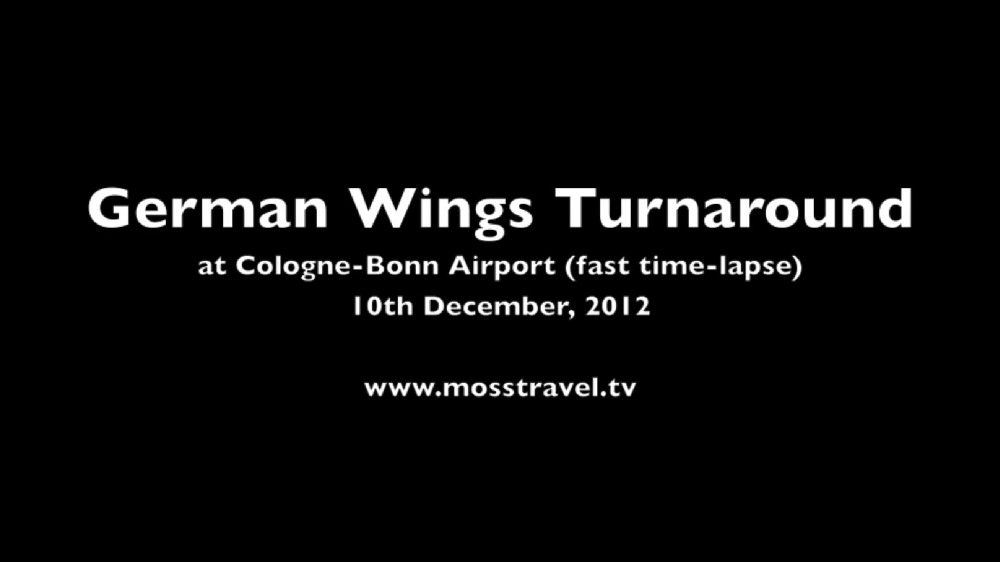

Processing frames:   1%|▏         | 108/7244 [01:27<1:26:56,  1.37it/s]

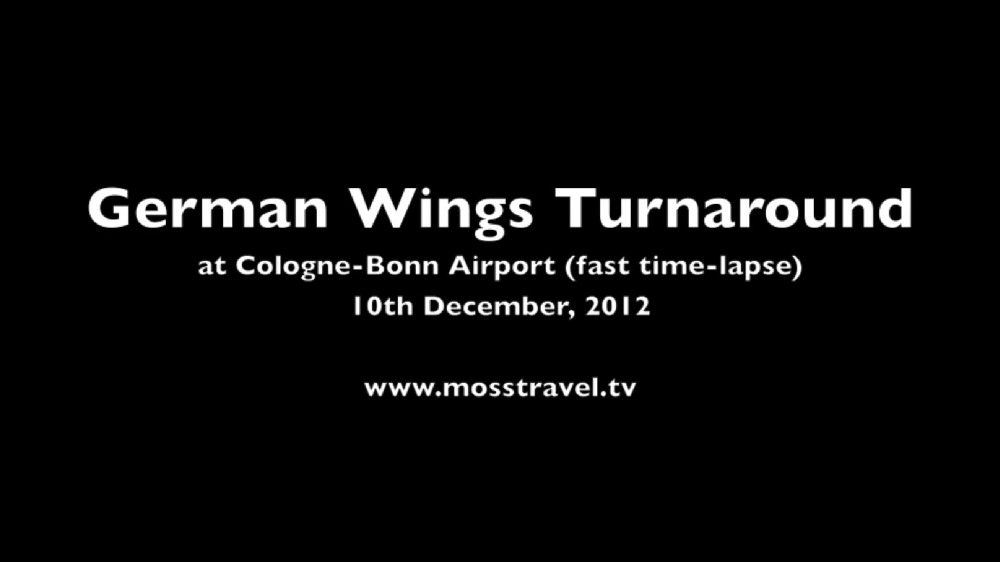

Processing frames:   2%|▏         | 109/7244 [01:28<1:28:41,  1.34it/s]

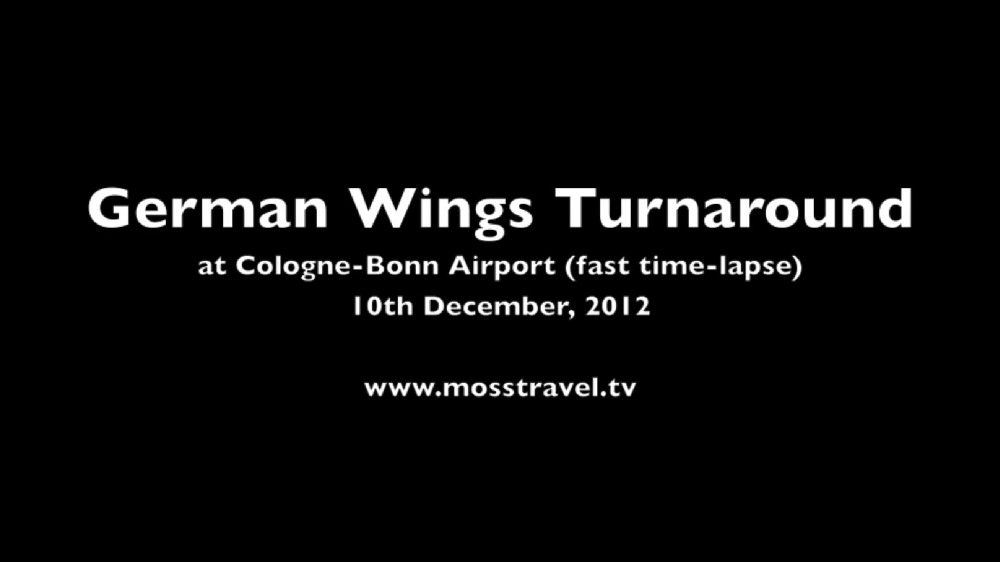

Processing frames:   2%|▏         | 110/7244 [01:29<1:29:56,  1.32it/s]

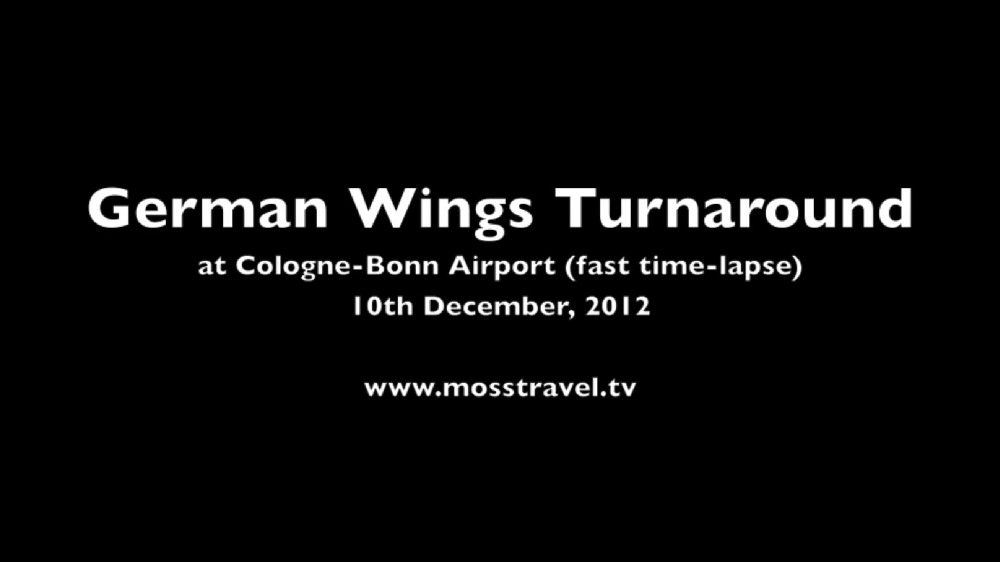

Processing frames:   2%|▏         | 111/7244 [01:30<1:31:14,  1.30it/s]

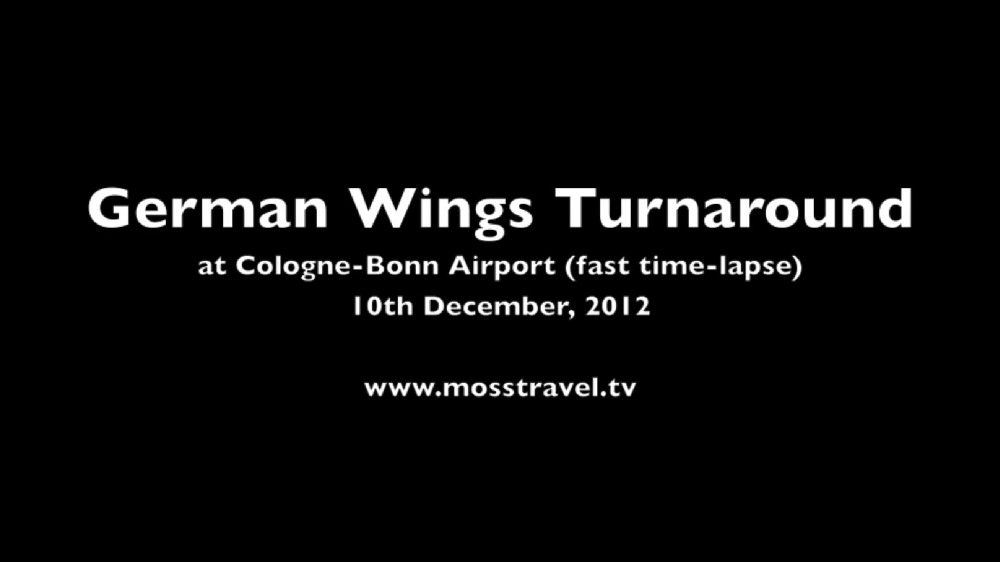

Processing frames:   2%|▏         | 112/7244 [01:30<1:30:58,  1.31it/s]

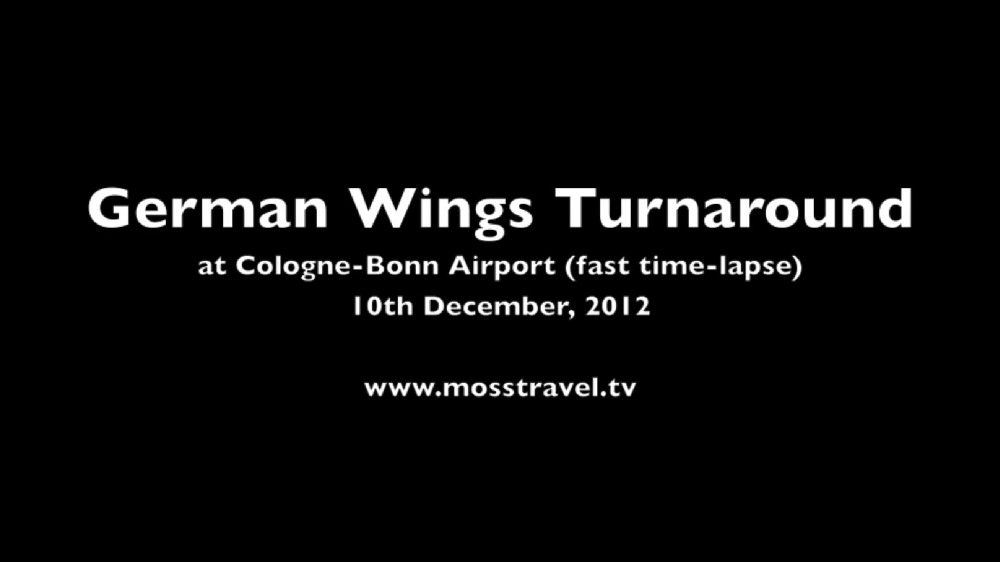

Processing frames:   2%|▏         | 113/7244 [01:31<1:32:37,  1.28it/s]

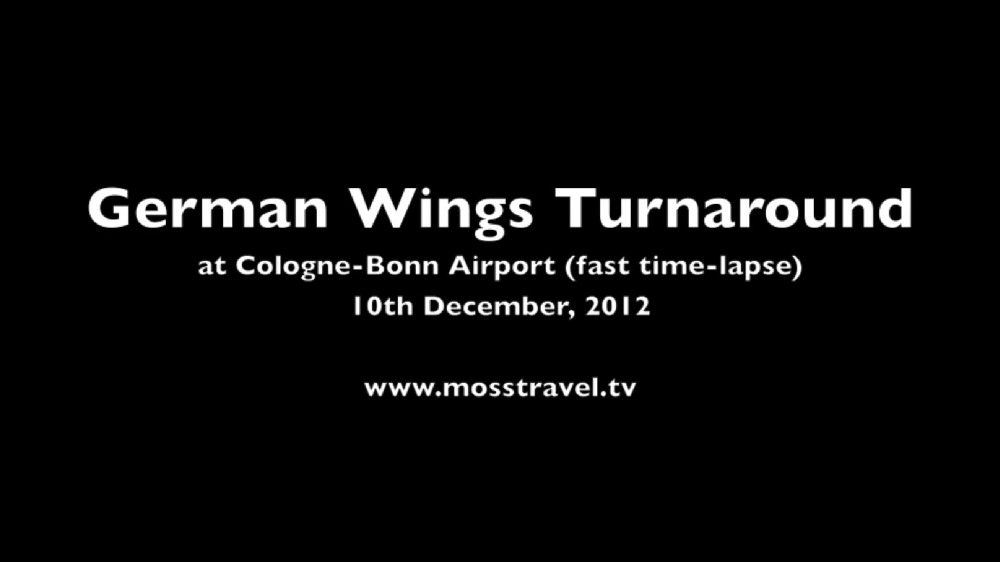

Processing frames:   2%|▏         | 114/7244 [01:32<1:32:30,  1.28it/s]

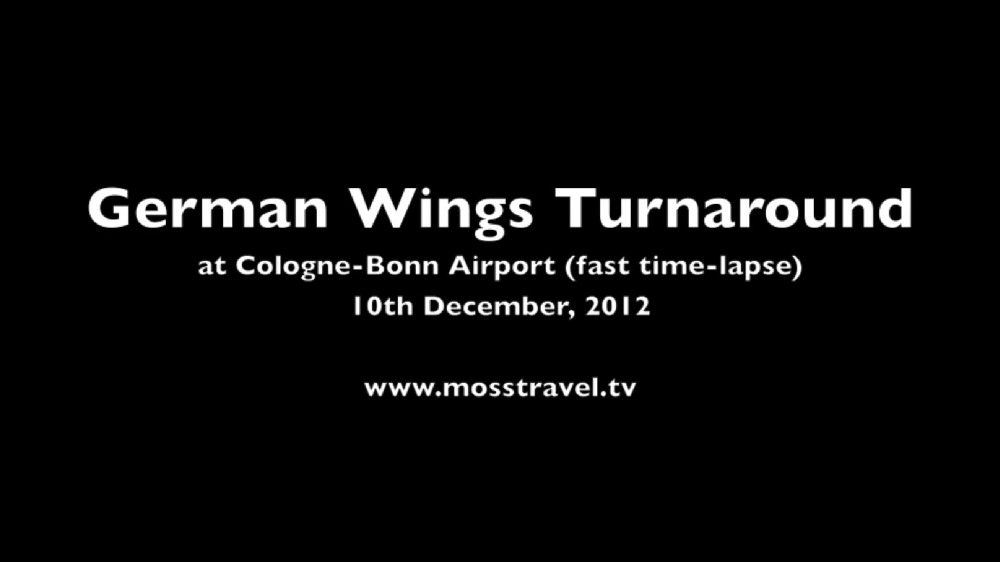

Processing frames:   2%|▏         | 115/7244 [01:33<1:32:01,  1.29it/s]

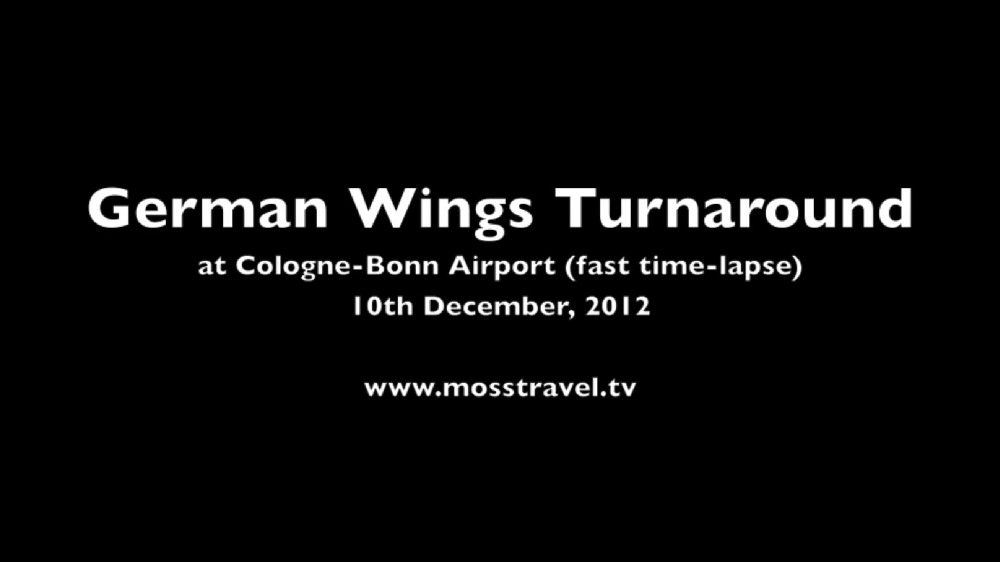

Processing frames:   2%|▏         | 116/7244 [01:33<1:31:55,  1.29it/s]

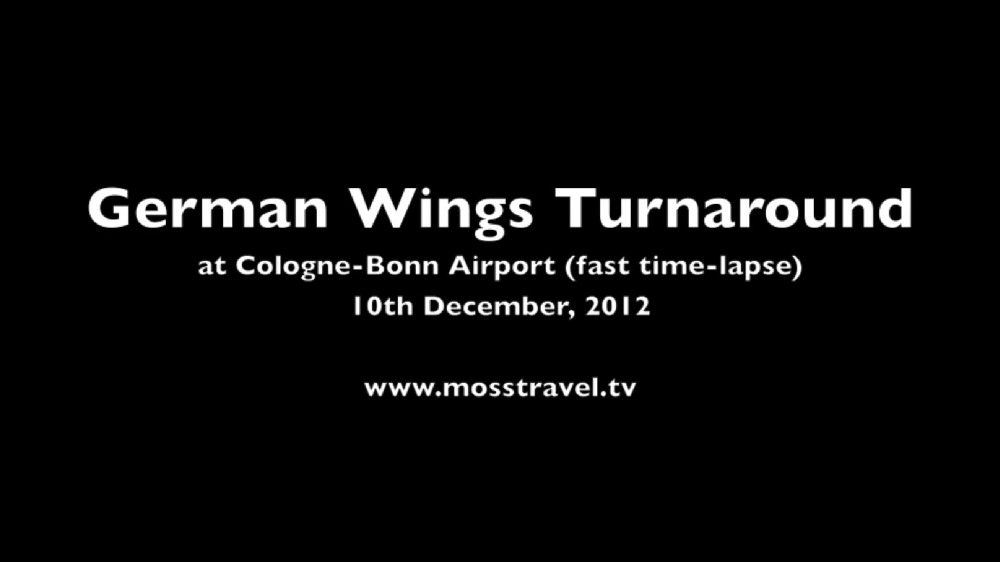

Processing frames:   2%|▏         | 117/7244 [01:34<1:32:41,  1.28it/s]

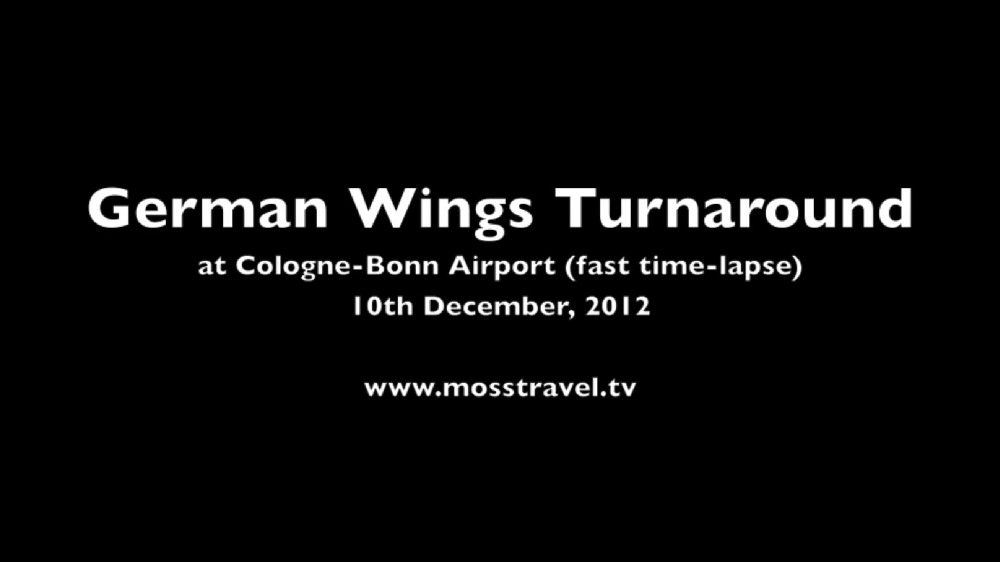

Processing frames:   2%|▏         | 118/7244 [01:35<1:34:05,  1.26it/s]

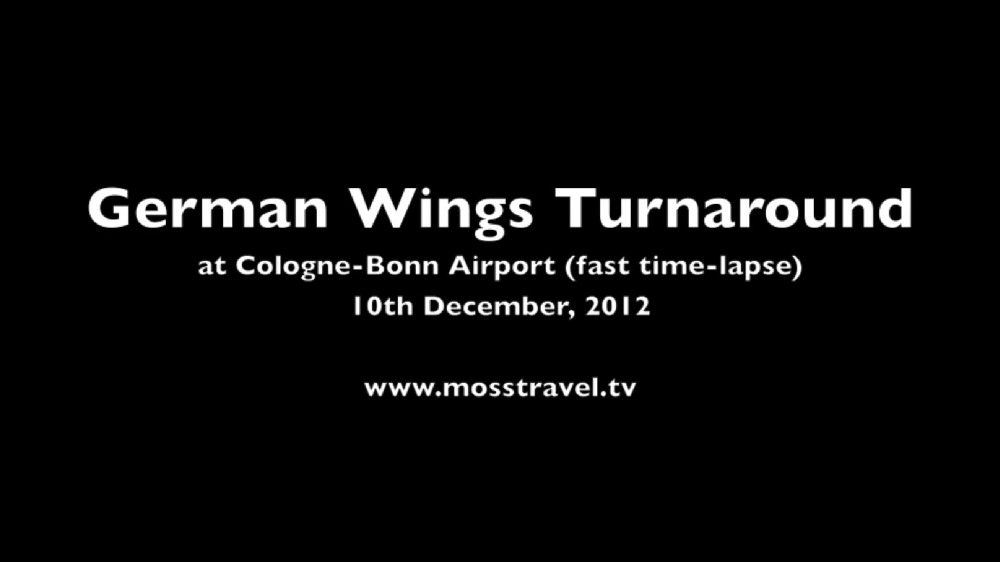

Processing frames:   2%|▏         | 119/7244 [01:36<1:33:23,  1.27it/s]

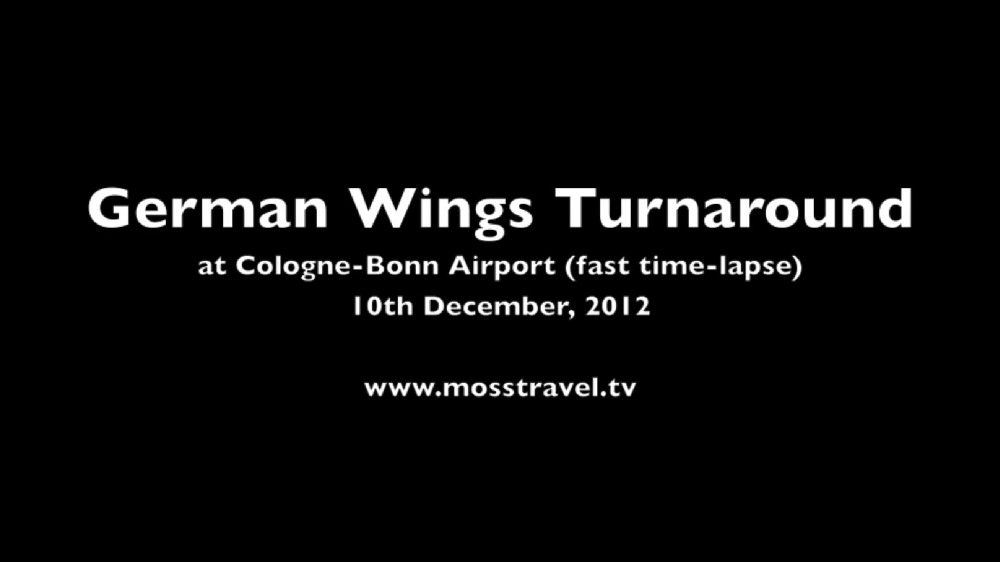

Processing frames:   2%|▏         | 120/7244 [01:37<1:34:17,  1.26it/s]

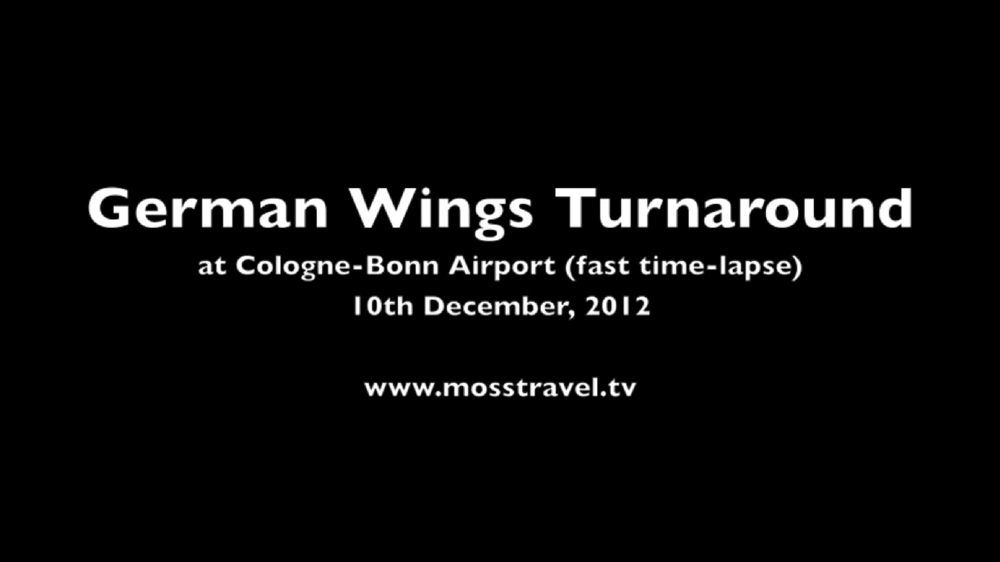

Processing frames:   2%|▏         | 121/7244 [01:37<1:34:25,  1.26it/s]

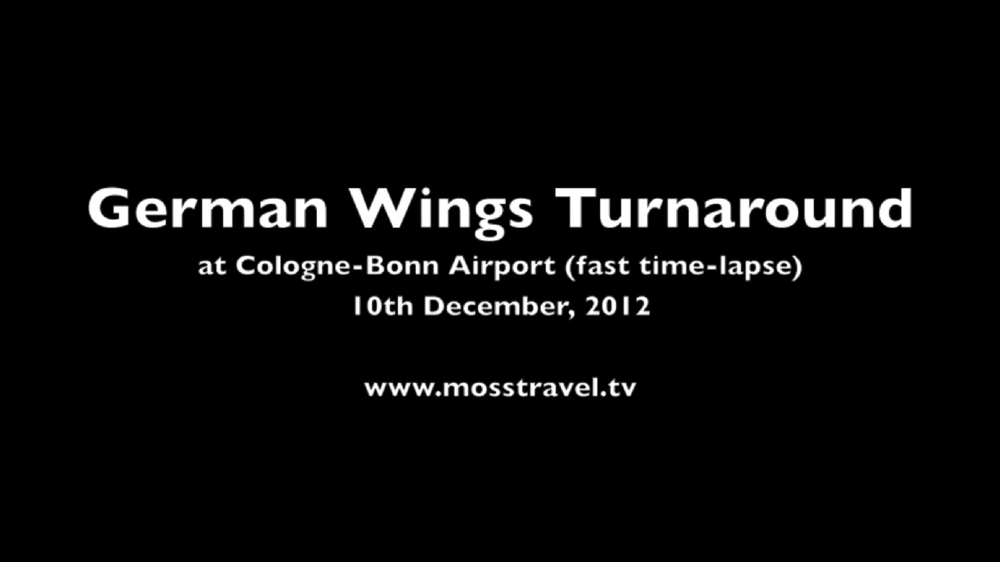

Processing frames:   2%|▏         | 122/7244 [01:38<1:33:33,  1.27it/s]

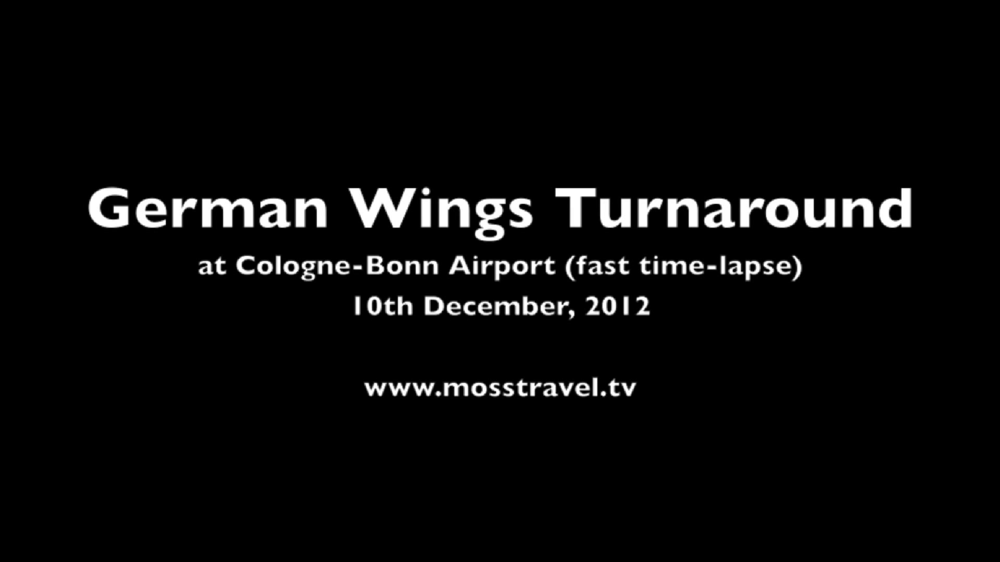

Processing frames:   2%|▏         | 123/7244 [01:39<1:31:21,  1.30it/s]

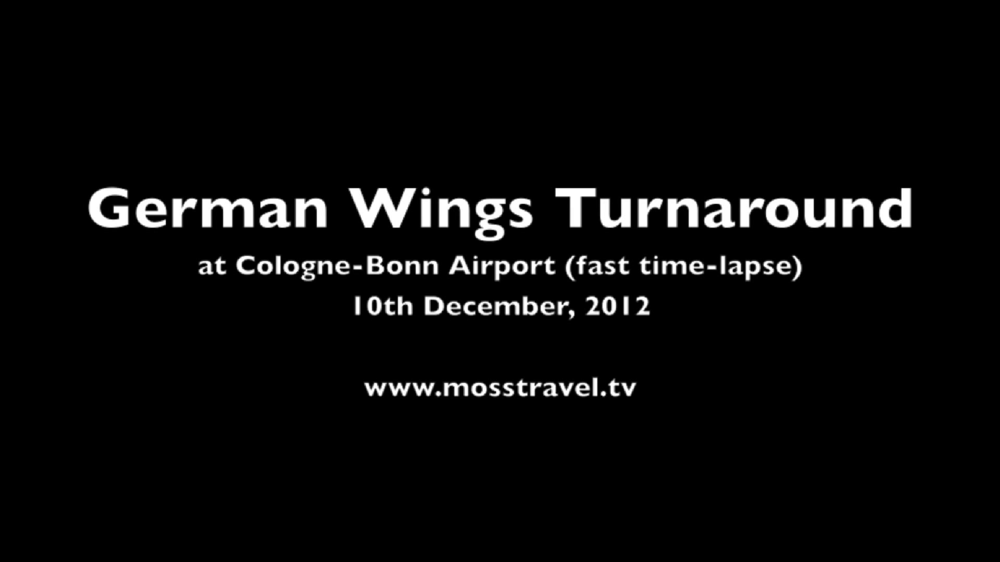

Processing frames:   2%|▏         | 124/7244 [01:40<1:34:06,  1.26it/s]

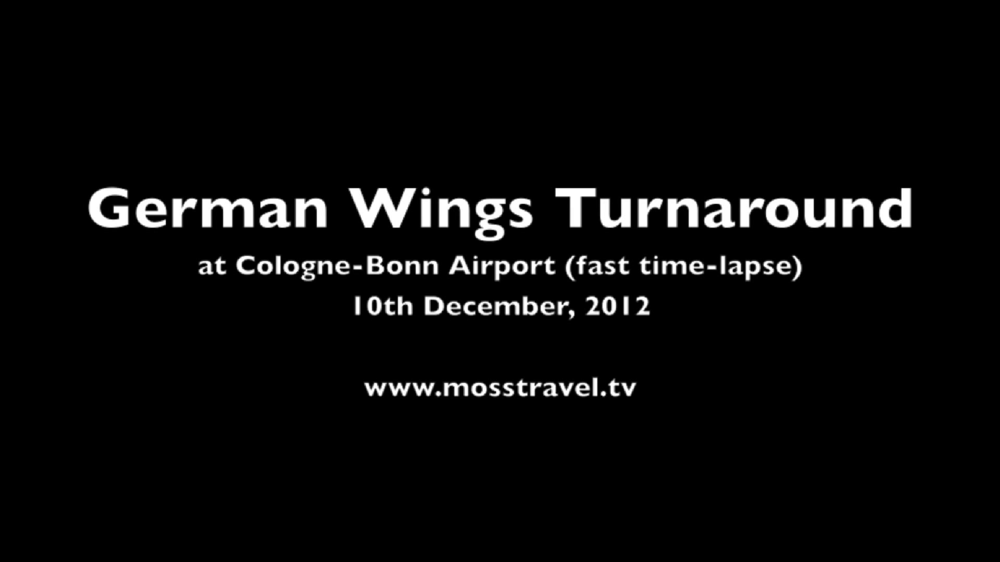

Processing frames:   2%|▏         | 125/7244 [01:41<1:35:55,  1.24it/s]

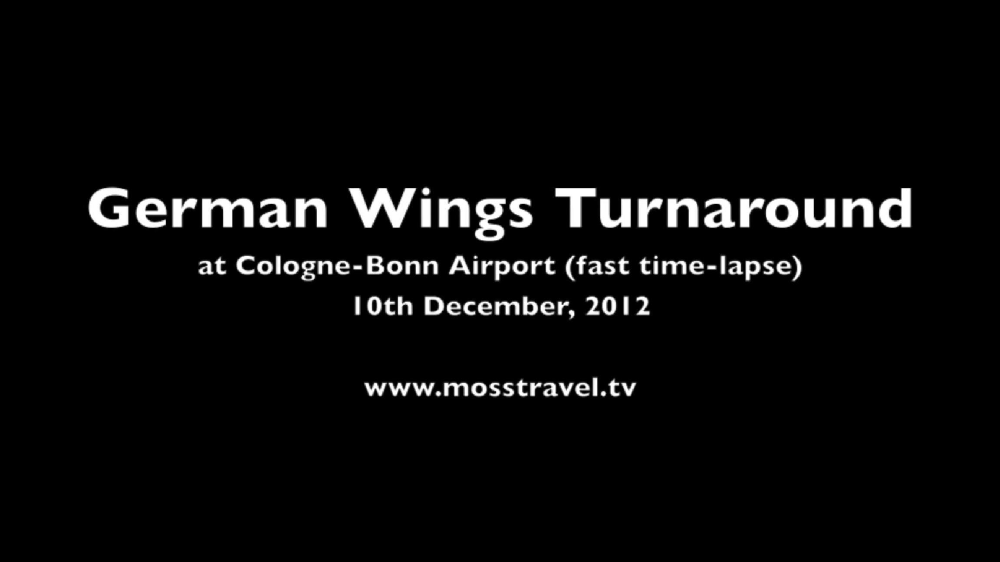

Processing frames:   2%|▏         | 126/7244 [01:41<1:35:45,  1.24it/s]

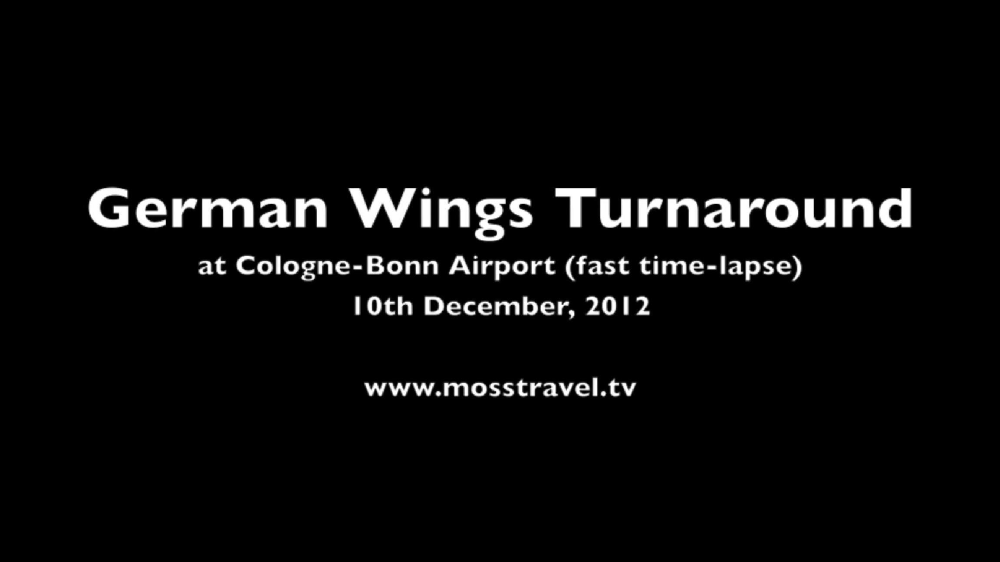

Processing frames:   2%|▏         | 127/7244 [01:42<1:34:31,  1.25it/s]

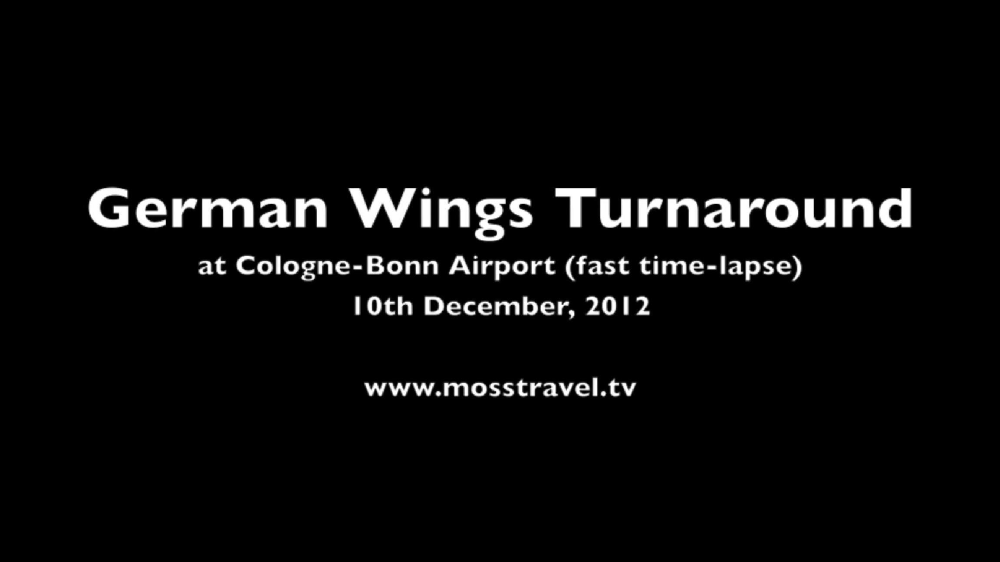

Processing frames:   2%|▏         | 128/7244 [01:43<1:34:08,  1.26it/s]

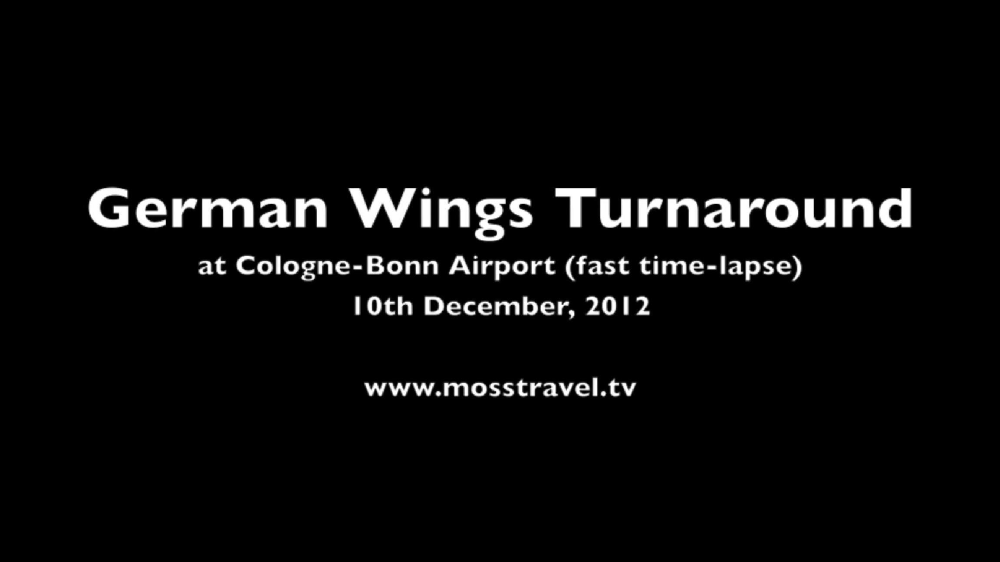

Processing frames:   2%|▏         | 129/7244 [01:44<1:34:34,  1.25it/s]

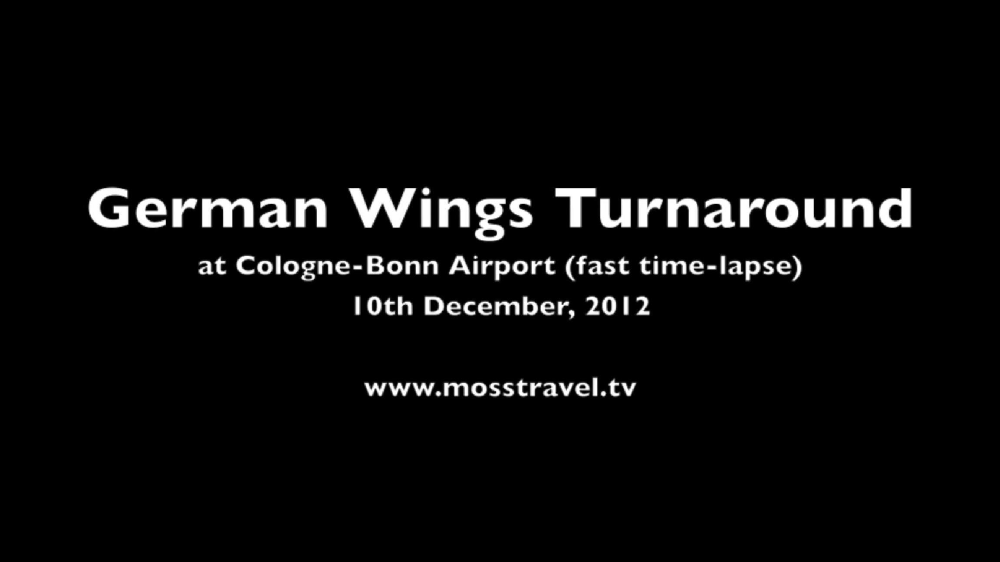

Processing frames:   2%|▏         | 130/7244 [01:45<1:34:13,  1.26it/s]

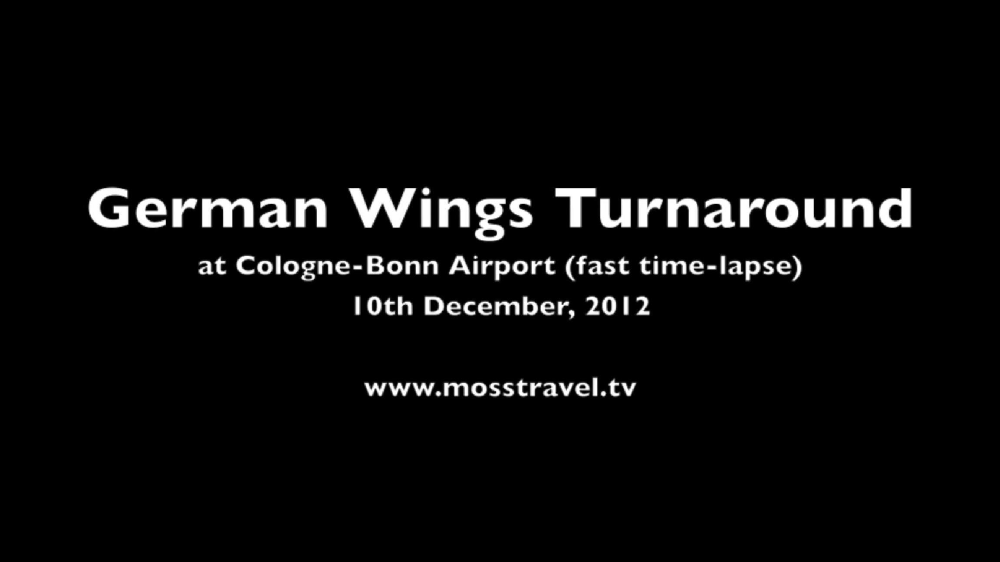

Processing frames:   2%|▏         | 131/7244 [01:45<1:33:25,  1.27it/s]

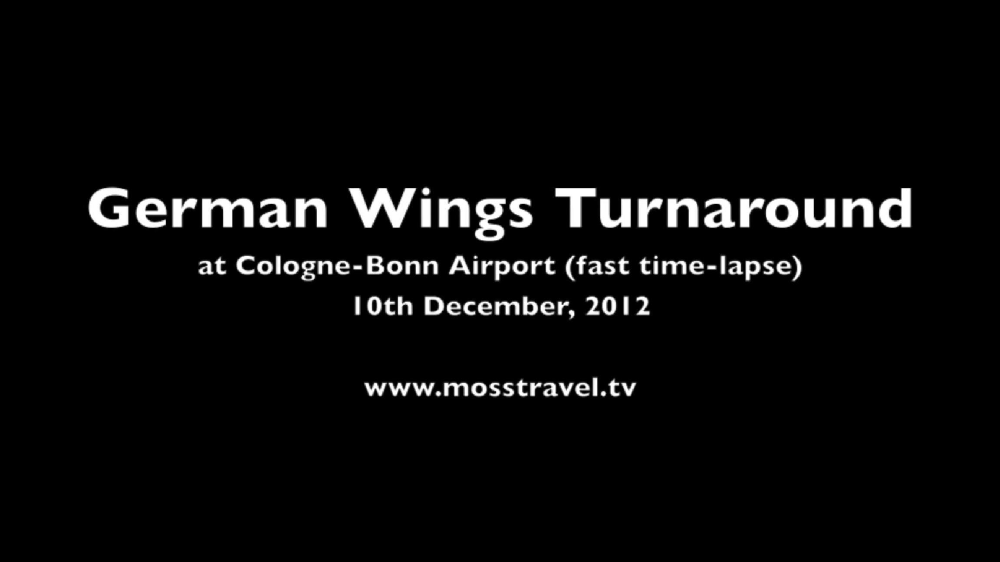

Processing frames:   2%|▏         | 132/7244 [01:46<1:34:16,  1.26it/s]

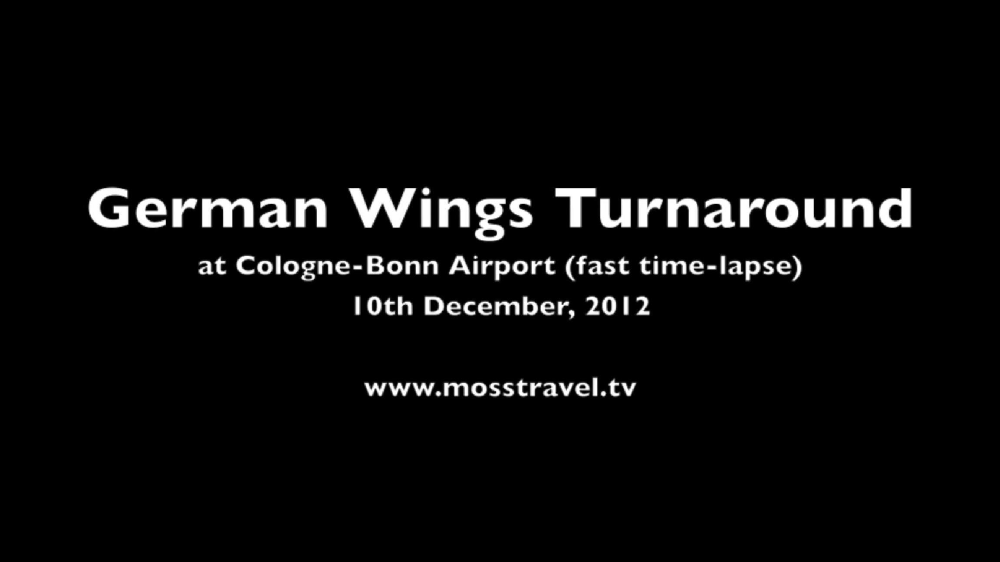

Processing frames:   2%|▏         | 133/7244 [01:47<1:40:16,  1.18it/s]

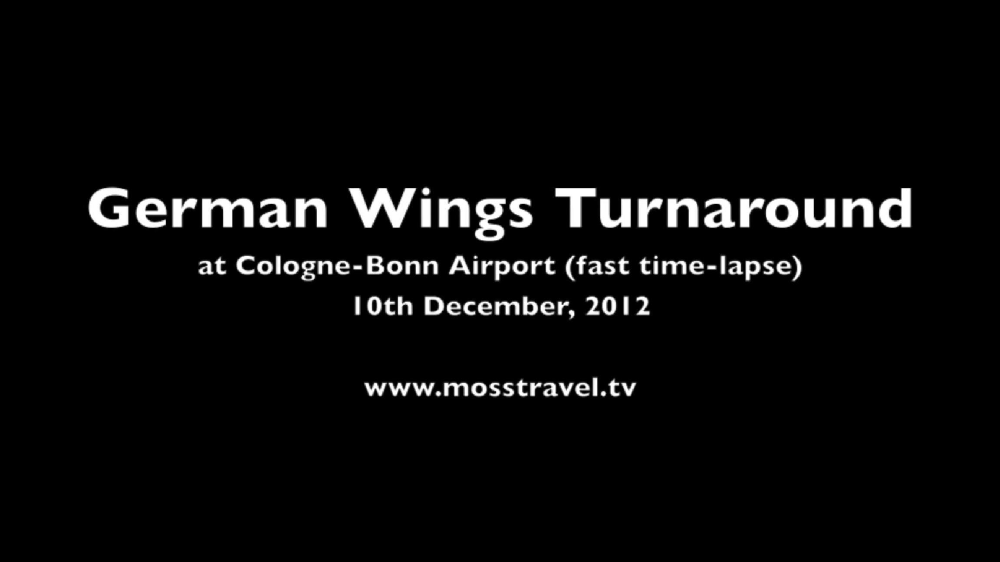

Processing frames:   2%|▏         | 134/7244 [01:48<1:43:09,  1.15it/s]

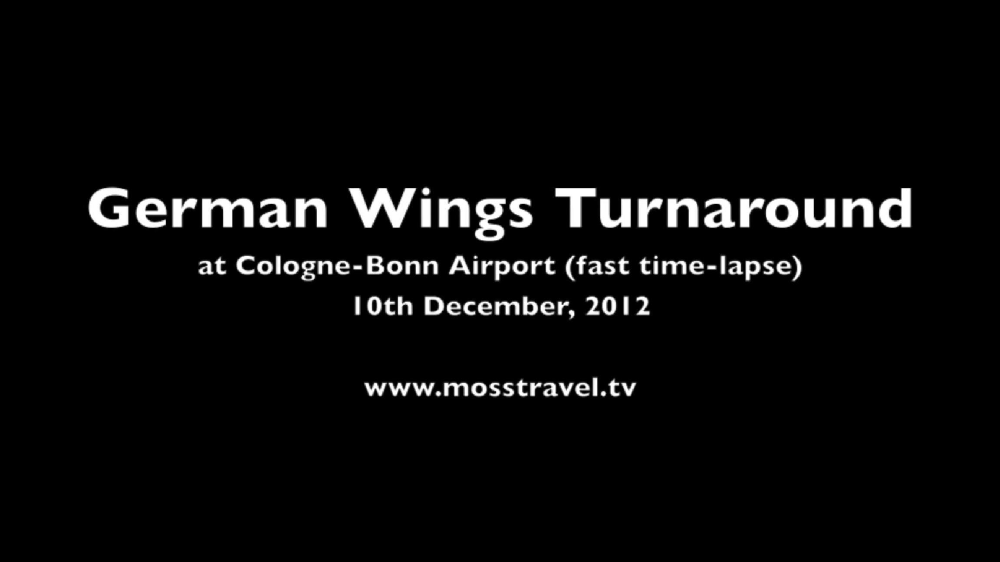

Processing frames:   2%|▏         | 135/7244 [01:49<1:45:38,  1.12it/s]

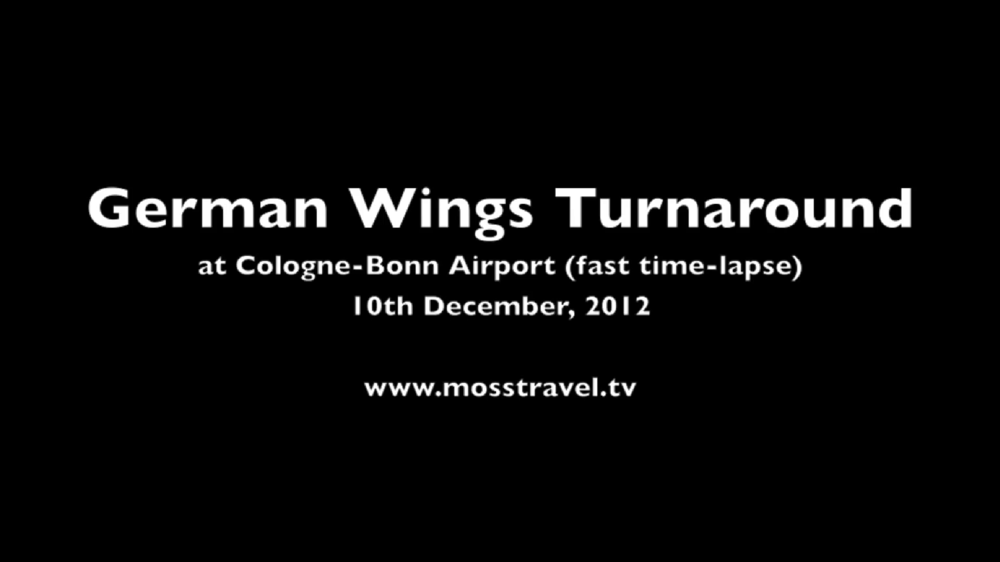

Processing frames:   2%|▏         | 136/7244 [01:50<1:44:21,  1.14it/s]

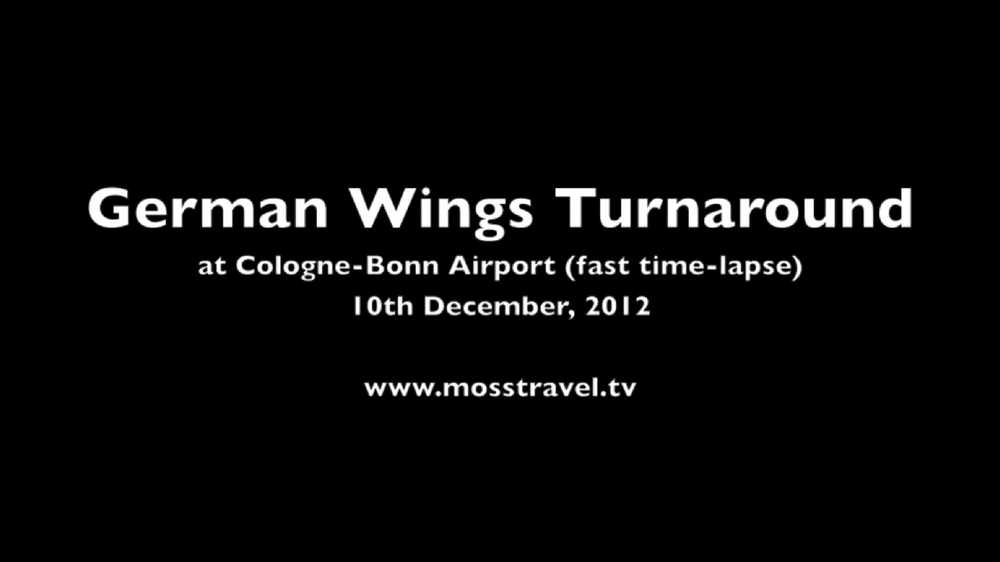

Processing frames:   2%|▏         | 137/7244 [01:51<1:40:34,  1.18it/s]

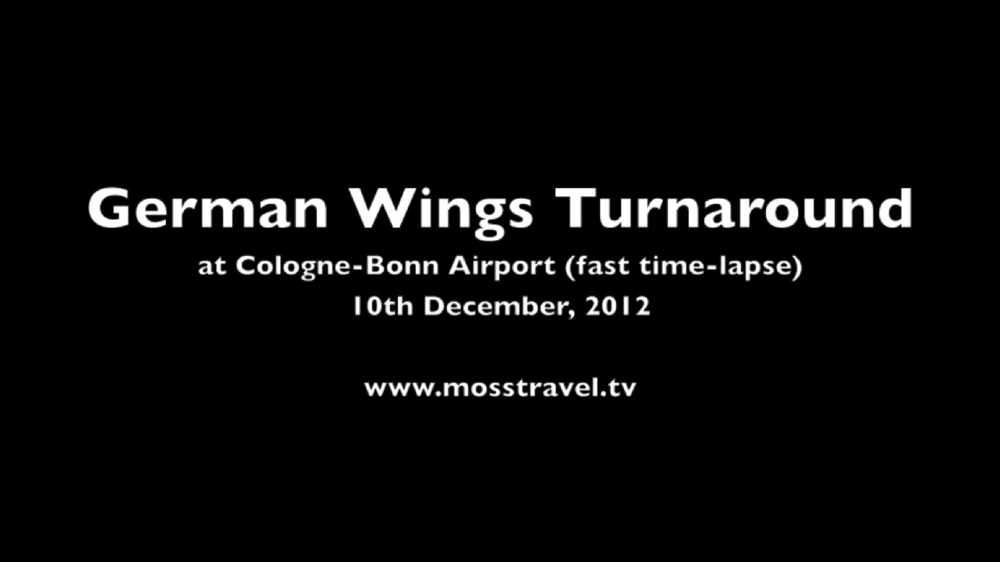

Processing frames:   2%|▏         | 138/7244 [01:51<1:41:17,  1.17it/s]

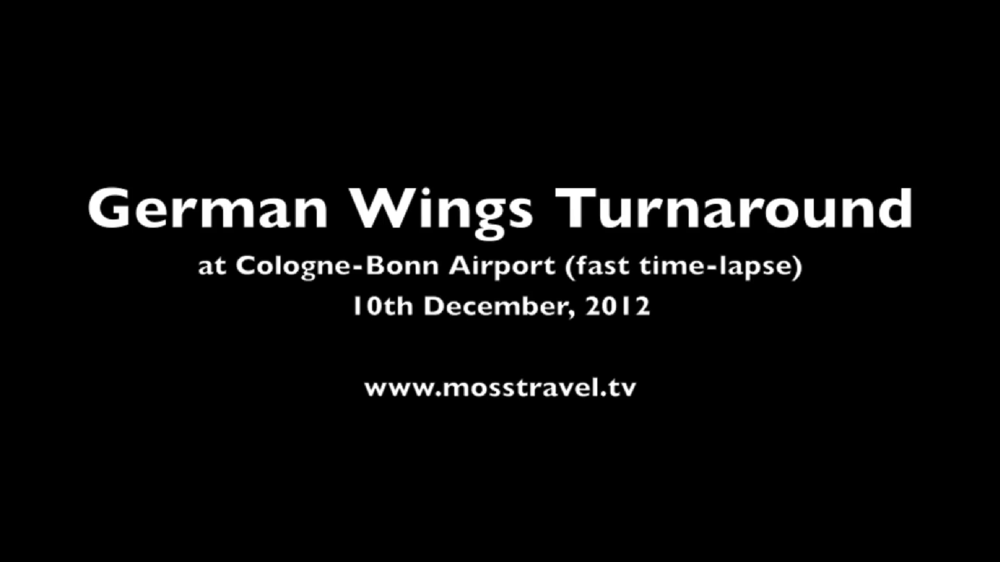

Processing frames:   2%|▏         | 139/7244 [01:52<1:39:29,  1.19it/s]

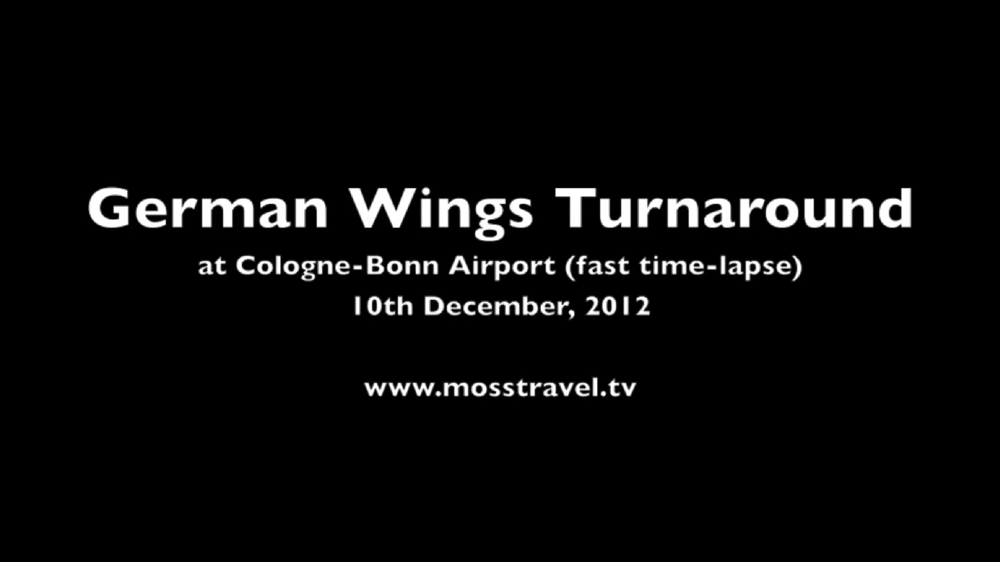

Processing frames:   2%|▏         | 140/7244 [01:53<1:37:42,  1.21it/s]

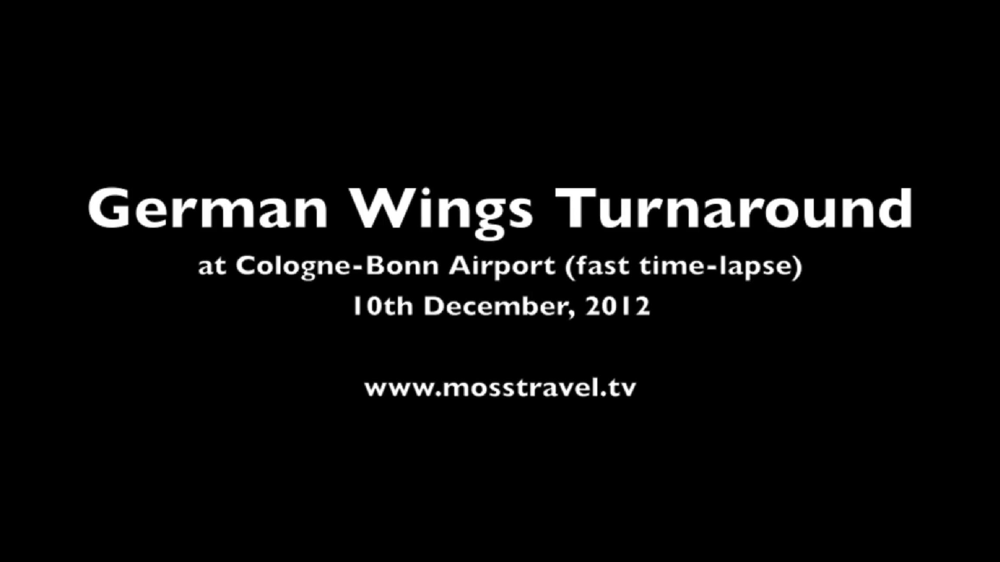

Processing frames:   2%|▏         | 141/7244 [01:54<1:39:26,  1.19it/s]

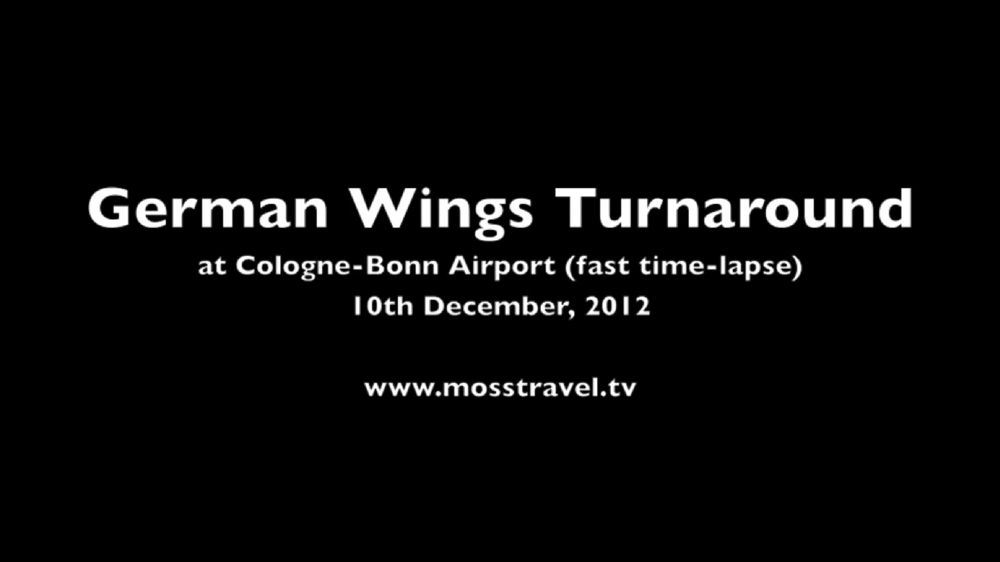

Processing frames:   2%|▏         | 142/7244 [01:55<1:37:55,  1.21it/s]

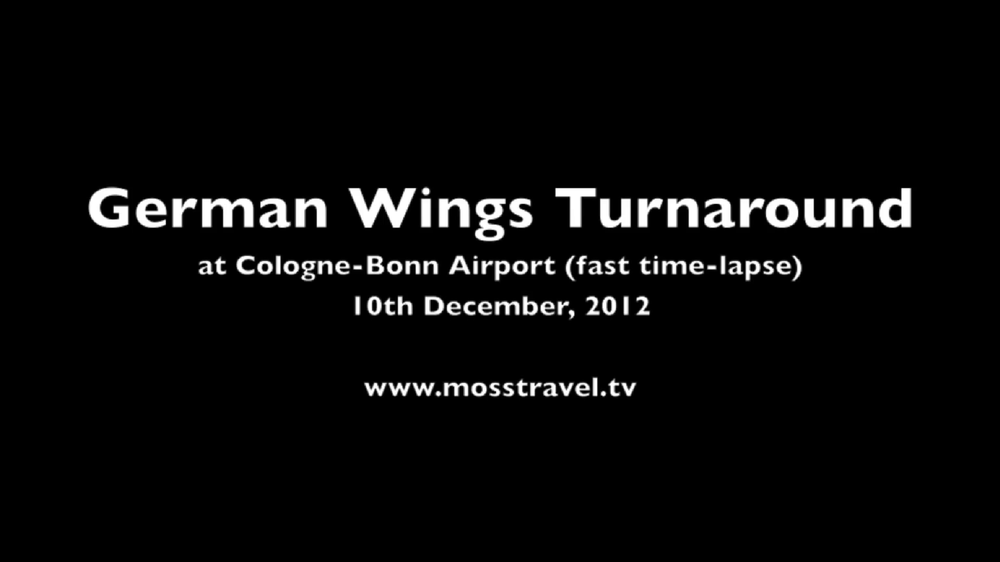

Processing frames:   2%|▏         | 143/7244 [01:56<1:37:27,  1.21it/s]

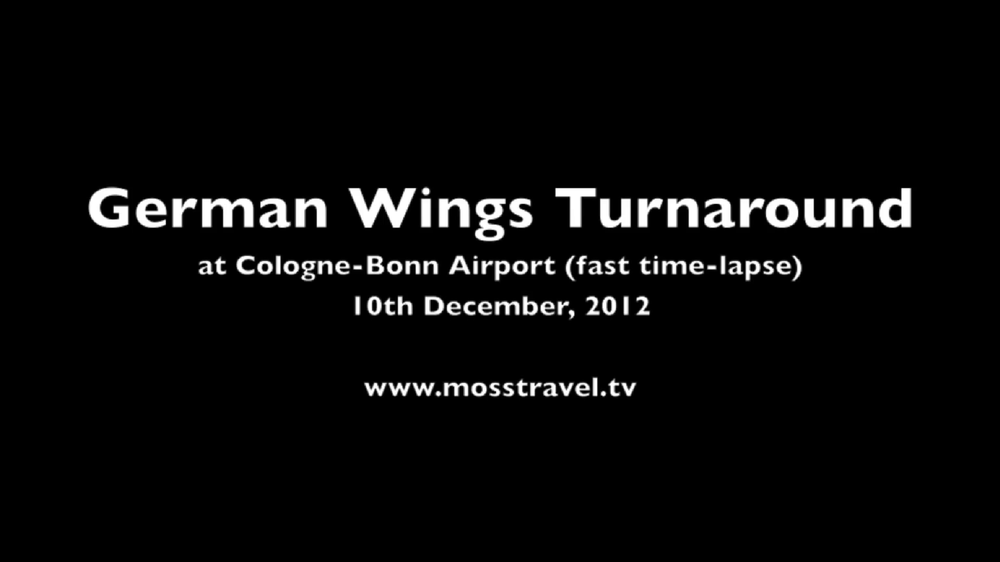

Processing frames:   2%|▏         | 144/7244 [01:56<1:37:43,  1.21it/s]

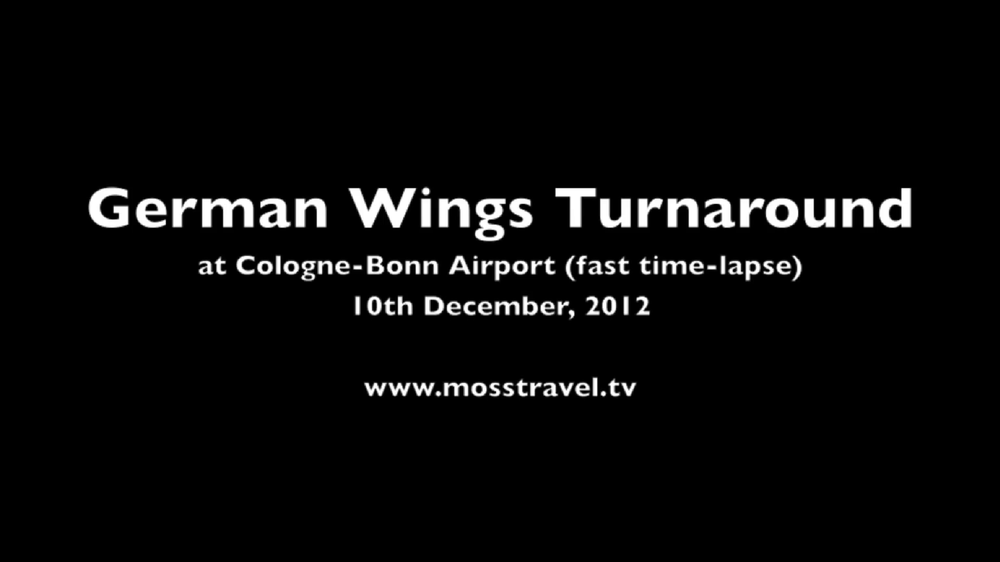

Processing frames:   2%|▏         | 145/7244 [01:57<1:38:38,  1.20it/s]

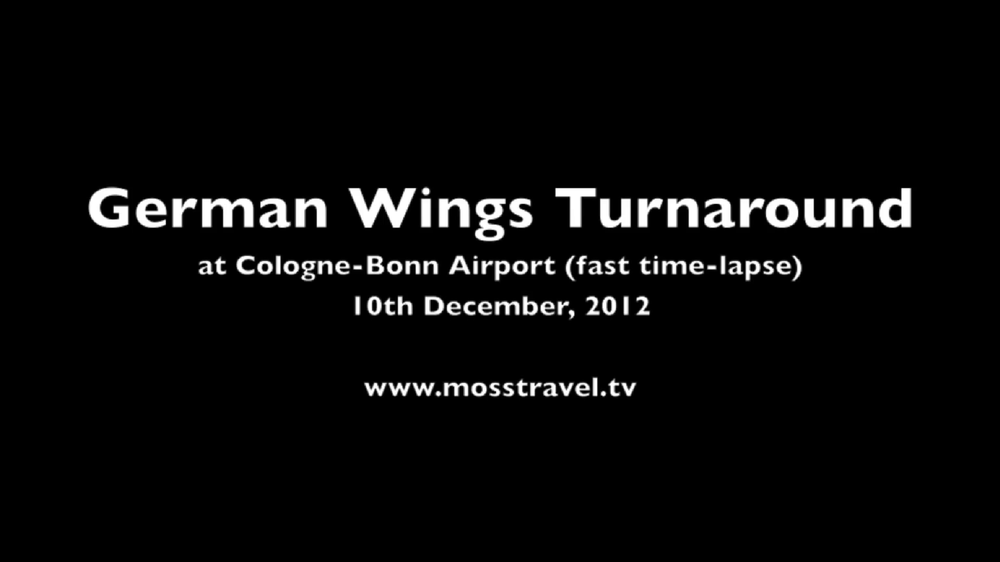

Processing frames:   2%|▏         | 146/7244 [01:58<1:38:47,  1.20it/s]

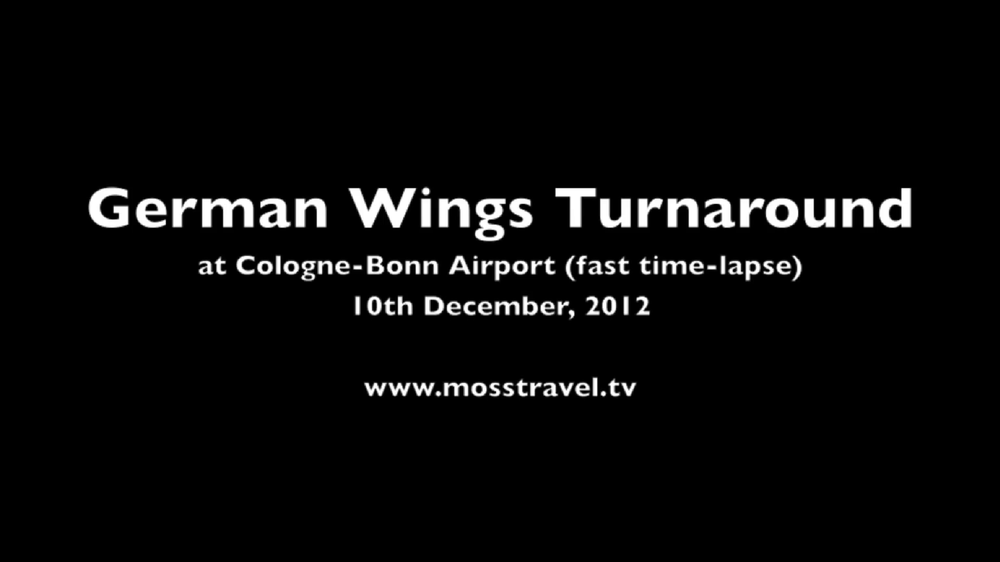

Processing frames:   2%|▏         | 147/7244 [01:59<1:36:13,  1.23it/s]

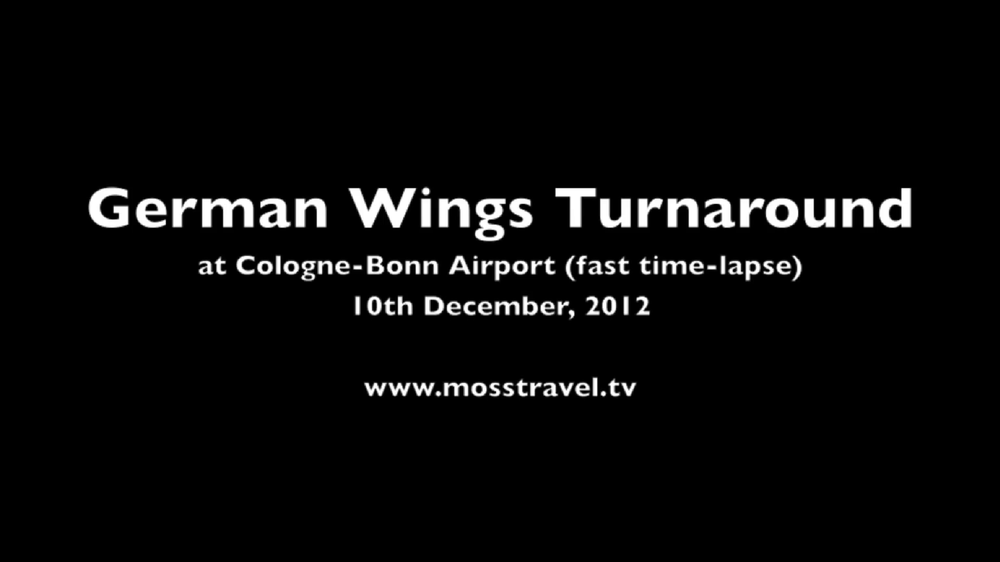

Processing frames:   2%|▏         | 148/7244 [02:00<1:34:32,  1.25it/s]

In [ ]:
import cv2
from tqdm import tqdm
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from google.colab.patches import cv2_imshow

# Set up the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = "drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/output/model_final.pth"
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13  # number of classes in your dataset
predictor = DefaultPredictor(cfg)

# Open video file
video = cv2.VideoCapture('drive/MyDrive/ML207/video/Germanwings_turnaround.mp4')
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(video.get(cv2.CAP_PROP_FPS))
out_video = cv2.VideoWriter('drive/MyDrive/ML207/video/Germanwings_turnaround_PREDICTED.mp4', cv2.VideoWriter_fourcc(*'XVID'), fps, (width, height))

# Get the total number of frames
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# Process video
for _ in tqdm(range(num_frames), desc="Processing frames"):
    ret, frame = video.read()
    if not ret:
        break

    # Make prediction
    outputs = predictor(frame)

    # Visualize result
    v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    annotated_frame = v.get_image()[:, :, ::-1]

    # Write to output video
    out_video.write(annotated_frame)

# Release video objects
video.release()
out_video.release()

In [ ]:
!pwd

/content


In [ ]:
!cd output && ls

/bin/bash: line 1: cd: output: No such file or directory


In [ ]:
import json
import numpy as np
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import seaborn as sns

def FastRCNN_Metrics(ground_truth_file, results_file):
    # Read the ground truth annotations
    with open(ground_truth_file, 'r') as file:
        annotated_coco_json = json.load(file)

    # Read the results
    with open(results_file, 'r') as file:
        results = json.load(file)

    # Extract ground truth annotations
    annotations = annotated_coco_json["annotations"]

    # Extract class labels, excluding the unwanted category
    class_labels = {category['id']: category['name'] for category in annotated_coco_json['categories'] if category['id'] != 0}

    # Define IoU function
    def iou(box1, box2):
        x1, y1, w1, h1 = box1
        x2, y2, w2, h2 = box2
        xi1 = max(x1, x2)
        yi1 = max(y1, y2)
        xi2 = min(x1 + w1, x2 + w2)
        yi2 = min(y1 + h1, y2 + h2)
        inter_area = max(xi2 - xi1, 0) * max(yi2 - yi1, 0)
        box1_area = w1 * h1
        box2_area = w2 * h2
        union_area = box1_area + box2_area - inter_area
        return inter_area / union_area

    def best_match(bbox_pred):
        max_iou = 0
        best_cat_id = None
        for anno in annotations:
            iou_score = iou(bbox_pred, anno['bbox'])
            if iou_score > max_iou:
                max_iou = iou_score
                best_cat_id = anno['category_id']
        return best_cat_id if max_iou > 0.5 else None

    y_true_binary = {label: [] for label in class_labels}
    y_score_binary = {label: [] for label in class_labels}

    for pred in results:
        cat_id = pred['category_id']
        bbox_pred = pred['bbox']
        max_iou = 0
        best_anno = None
        for anno in annotations:
            if anno['category_id'] == cat_id:
                iou_score = iou(bbox_pred, anno['bbox'])
                if iou_score > max_iou:
                    max_iou = iou_score
                    best_anno = anno

        for label in class_labels:
            if max_iou > 0.5 and cat_id == label:
                y_true_binary[label].append(1)
                y_score_binary[label].append(pred['score'])
            else:
                y_true_binary[label].append(0)
                y_score_binary[label].append(1 - pred['score'])

    # Plot ROC curve for each class
    plt.figure(figsize=(10,7))
    for cat_id, cat_name in class_labels.items():
        if cat_id == 0:
            continue
        fpr, tpr, _ = roc_curve(y_true_binary[cat_id], y_score_binary[cat_id])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'Class {cat_name} (area = {roc_auc:.2f})')

    plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

    # Extract class labels from annotated_coco_json, excluding the unwanted category
    y_true_multiclass = [best_match(pred['bbox']) for pred in results]
    filtered_true_multiclass = []
    filtered_pred_multiclass = []
    for pred, true in zip(results, y_true_multiclass):
        if true is not None:
            filtered_true_multiclass.append(class_labels[true])
            filtered_pred_multiclass.append(class_labels[pred['category_id']])

    # Compute confusion matrix
    conf_matrix = confusion_matrix(filtered_true_multiclass, filtered_pred_multiclass, labels=list(class_labels.values()))

    # Use Seaborn's heatmap to plot confusion matrix
    plt.figure(figsize=(10,7))
    sns.heatmap(conf_matrix, annot=True, cmap='Blues', xticklabels=class_labels.values(), yticklabels=class_labels.values(), fmt='d')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title('Confusion Matrix')
    plt.show()

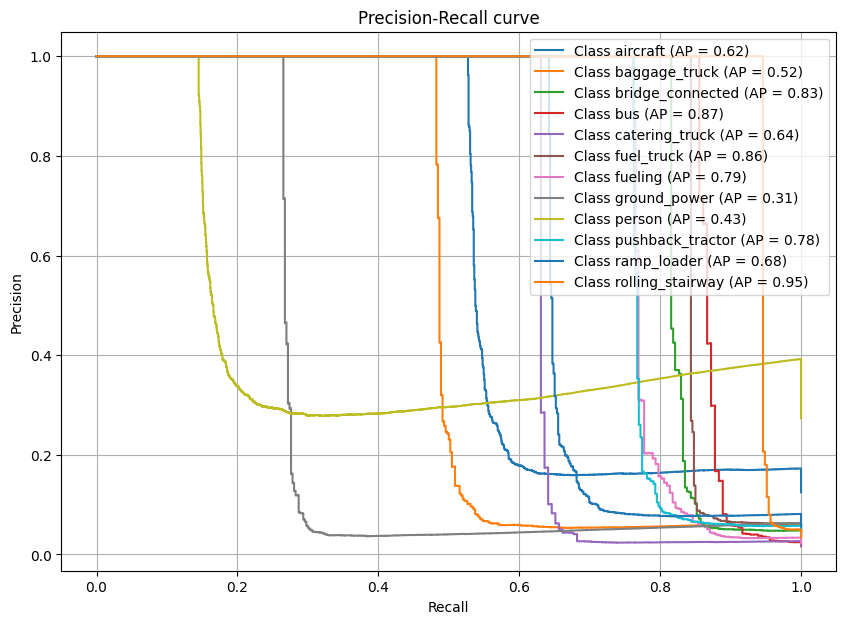

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1029: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


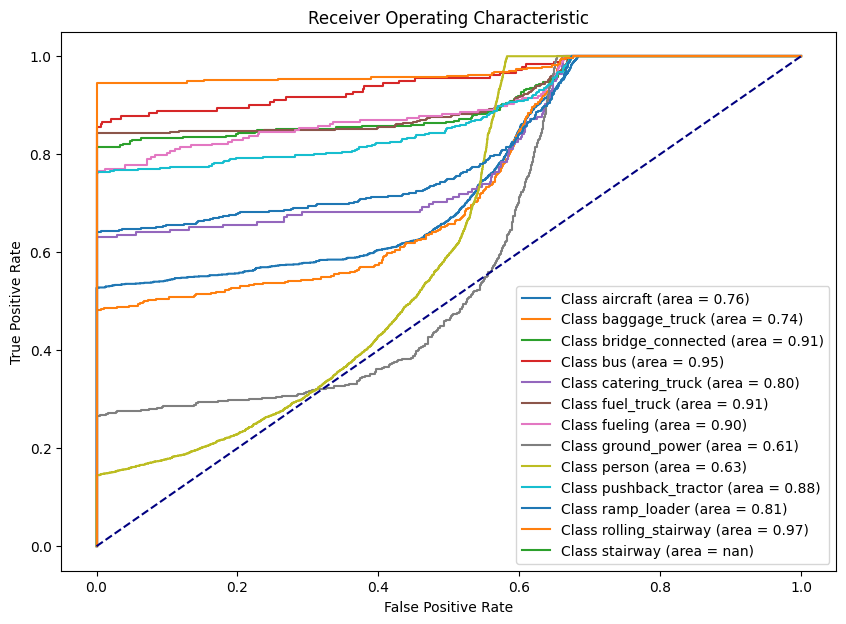

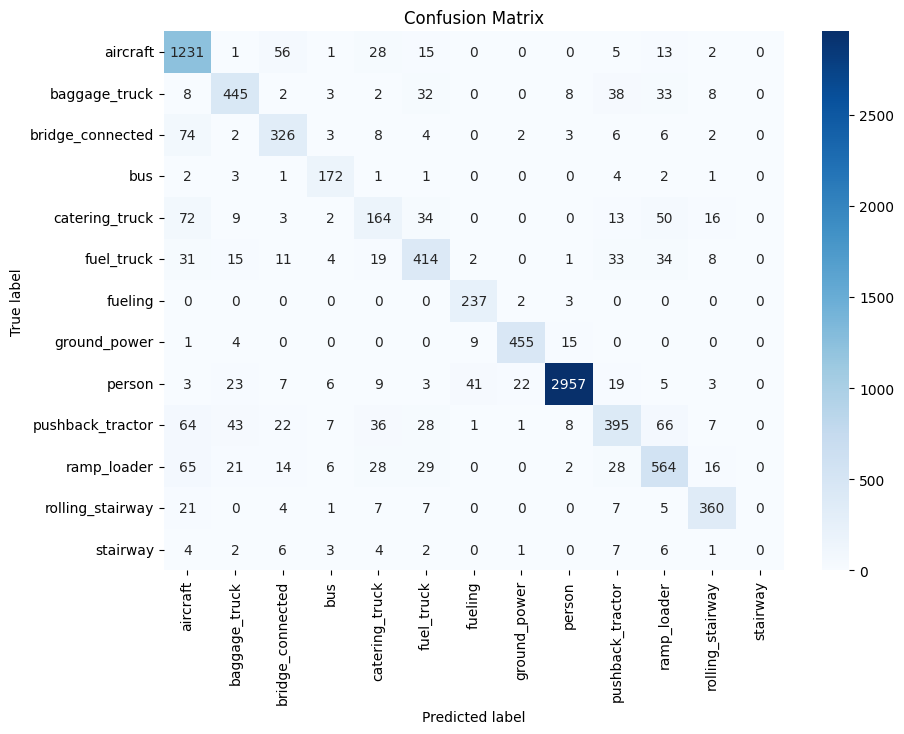

In [ ]:
FastRCNN_Metrics("drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/valid/_annotations.coco.json","drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/output/coco_instances_results.json")

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.05s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=2.46s).
Accumulating evaluation results...
DONE (t=0.50s).


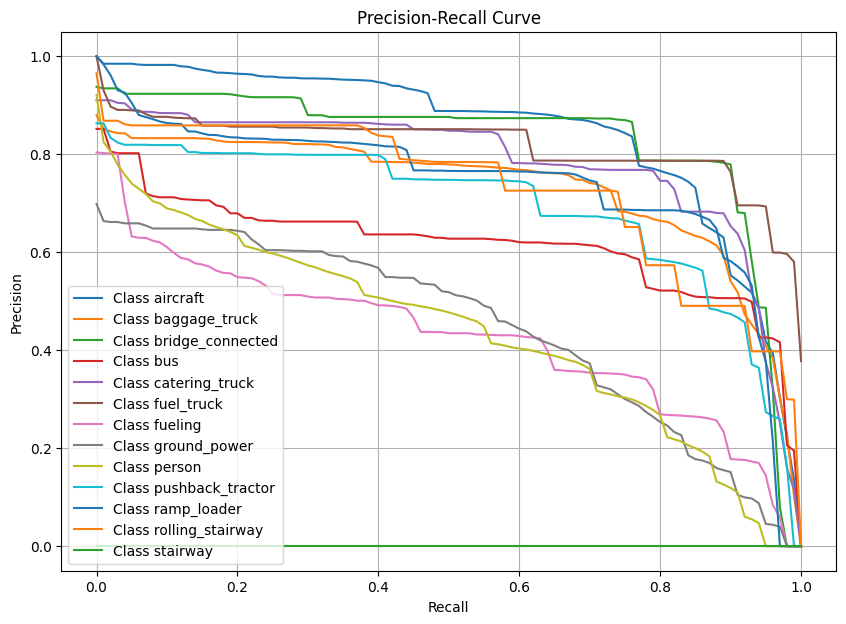

In [ ]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

# Assuming you've loaded your ground truth and results
ground_truth_file, results_file = "drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/valid/_annotations.coco.json","drive/MyDrive/ML207/airplane-turnaround-object-detection-dataset-final/output/coco_instances_results.json"
coco_gt = COCO(ground_truth_file)
coco_dt = coco_gt.loadRes(results_file)

# Get category ids
cat_ids = coco_gt.getCatIds()

# Start evaluation
coco_eval = COCOeval(coco_gt, coco_dt, 'bbox')
coco_eval.params.catIds = cat_ids
coco_eval.evaluate()
coco_eval.accumulate()

num_classes = len(cat_ids)
confusion_matrix = np.zeros((num_classes, num_classes))

# Plotting precision-recall curve
plt.figure(figsize=(10, 7))

# Iterate through categories and plot PR curve for each
for i, cat_id in enumerate(cat_ids):
    # Using the precision values for the category
    cat_precision = coco_eval.eval['precision'][:, :, i, 0, 2]  # Shape: [IoU, recall, category, areaRng, maxDets]
    cat_precision = np.mean(cat_precision, axis=0)  # Average over IoU thresholds

    # Define the recall thresholds, matching the number of precision points
    recall_thresholds = np.linspace(0, 1.0, num=cat_precision.shape[0])
    if all(cat_precision > -.5):
      plt.plot(recall_thresholds, cat_precision, label=f'Class {coco_gt.loadCats(cat_id)[0]["name"]}')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='lower left')
plt.grid()
plt.show()